In [36]:
#!jt -t chesterish -T
#!jt -r

usage: jt [-h] [-l] [-t THEME] [-f MONOFONT] [-fs MONOSIZE] [-nf NBFONT]
          [-nfs NBFONTSIZE] [-tf TCFONT] [-tfs TCFONTSIZE] [-dfs DFFONTSIZE]
          [-ofs OUTFONTSIZE] [-mathfs MATHFONTSIZE] [-m MARGINS]
          [-cursw CURSORWIDTH] [-cursc CURSORCOLOR] [-cellw CELLWIDTH]
          [-lineh LINEHEIGHT] [-altp] [-altmd] [-altout] [-P] [-T] [-N] [-kl]
          [-vim] [-r] [-dfonts]
jt: error: unrecognized arguments: -H


Notas:
=============

Se plantea lo siguiente Tamaño codigo:
>Debido a que el codigo, demora mucho en abrise y pesa al rededor de 28 mbs, se podria llegar tener un codigo (Archivo jupiter) para cada rango de graficos, como
> - tipo boxplot(Inicio punto 4)
> - graicos de frecuencia(Punto 3)
> - Graficos, de variación del precio tiempo (Punto 5)

# Parametros base

Precio promedio(General)
Graficos series de tiempo



Se estudiará primero con el `Tipo_de_Cliente` = **Tradicional** que es el segmento de interes.

Ademas los graficos se presentaran todos para el producto de interes `Y_producto` = __1010078__

In [1]:
# stopwatch
import time
def time_convert(sec):
  mins = sec // 60
  sec = sec % 60
  hours = mins // 60
  mins = mins % 60
  print("Time Lapsed = {0}:{1}:{2}".format(int(hours),int(mins),sec),'\n H:m:s')
#==================================
#          Example
#    input("Press Enter to start")
#    start_time = time.time()
#    input("Press Enter to stop")
#    end_time = time.time()
#    time_lapsed = end_time - start_time
#    time_convert(time_lapsed)
#=================================
start_time_0 = time.time()

In [2]:
#===================================
# Archivo
#===================================
Zona_df='Z001'

"""
# Ordenador de escritorio
file_direct_O="C:/Users/user/Documents/Data/Data Clear/"+Zona_df+"/"
file_direct_Clear="C:/Users/user/Documents/Data/Data Clear/"
file_direct_Graphic='C:/Users/user/Documents/Graficos'

"""
#Notebook
file_direct_O="C:/Users/rolft/Documents/Repositorios/Data/Data Clear/"+Zona_df+"/"
file_direct_Clear="C:/Users/rolft/Documents/Repositorios/Data/Data Clear/"
file_direct_Graphic='C:/Users/rolft/Documents/Repositorios/Graficos'

#===================================
# Clientes
#===================================
Tipo_de_Cliente='Tradicional'

#===================================
# Producto de interes
#===================================
Y_producto='1010078'

In [3]:
#===================================
# Dicionario 
#===================================

#===================================
# Fecha
D=['Enero','Febrero','Marzo','Abril',
 'Mayo','Junio','Julio','Agosto',
 'Septiembre','Octubre',
 'Noviembre','Diciembre']
Month_dic={i:D[i-1]  for i in range(1,13)}
#===========================================


def Mes_name(x):
    D=['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre']
    return(D[int(x)-1])

# Intalar paquetes, Abrir data y ajustarla 

## import

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

#from geopandas import *

from plotnine import *

#para ajustar las fechas
import datetime

#para calcular el skew de un array() o list()
from scipy.stats import skew 

from sklearn.model_selection import train_test_split

In [5]:
from mizani.breaks import date_breaks
from mizani.formatters import date_format

## Datos  
Se cargan los datos de
Ventas y la defincion de los productos
Ventas está en `data_v` y despues pasa a ser `data`

Productos estan cargados en `DF_products`


El que combina a ambos `DF_Full`

###  Ventas

In [6]:
#======================================================================
# Se Cargan los datos de ventas con las caracteristicas de los clientes
#=====================================================================

file_direct=file_direct_O+'Ventas'+'.csv'
col_names=pd.read_csv(file_direct,
                      encoding="utf-8",sep=";",nrows=0).columns

types_dict = {col: str for col in list(col_names)}

data_V = pd.read_csv(file_direct,
                   encoding="utf-8",sep=";",dtype=types_dict)
#elimina una columna en especifico
data_V.drop('Año natural', inplace=True, axis=1)
data_V.head(1)

,Zona de ventas,Zona de ventas.1,Cliente,Cliente.1,Cliente - Local,Cliente - Local.1,Material,Día natural,Kilos Venta KG,Venta Neta,...,Centro.1,Población,Tipo de cliente,Cluster,Segmento,Segmento.1,Categoría Cliente,Zona de reparto,Año Creación,Material Favorito
0,Z001,Santiago,10003742,Ferrer Leiva Sonia,Ferrer Leiva Sonia,38458,1010077,09.02.2018,12,13.685,...,Sucursal Lo Espejo,La Pintana,Tradicional,Clásico,50,Cobertura Pequeno SD,Especialista en Proc,1513112010,2007,1010077


In [7]:
data_V[['Material','Kilos Venta KG','Venta Neta','Precio Promedio','Día natural']].head()

,Material,Kilos Venta KG,Venta Neta,Precio Promedio,Día natural
0,1010077,12,13.685,1.190,09.02.2018
1,1010077,12,15.660,1.350,04.05.2018
2,1010077,12,14.388,1.250,22.06.2018
3,1010077,12,12.753,1.090,26.10.2018
4,1010077,12,14.887,1.290,08.03.2019


#### Funcion

In [8]:
# =============================================================================
# Ajustar la data
# =============================================================================
def Ajuste_data(data):
    start_time = time.time()

    df=data.copy()

# =================================
# ELiminare dodos los valores Nan
# =================================
    for i in df.columns.to_list():
        df=df[df[i].notna()]

    #========================================
    # Funcion para asignar el tipo de cambio
    #----------------------------------------
    def categ_uniq(x):   
        y=str(x)
        y=y[len(y)-3:]
        if(y=='USD'):
            return y
        else:#if(x[len(x)-3:]=='CLP'):
            return 'CLP'

    #df['Unidad Venta']=df['Venta Neta'].apply(categ_uniq)
    #df['Unidad Precio']=df['Precio Promedio'].apply(categ_uniq)



    #==========================================================
    # Cambio de las comas y valores
    #----------------------------------------------------------
    def CLP_Dolar(x):
        x=str(x)
        x=x.replace('.', '')
        x=x.replace(',', '.')
        x=str(x)
        if(x[len(x)-3:]=='USD'):
            x=x.split(' USD')[0]
            x= None
            #x=x*720
        elif(x[len(x)-3:]=='CLP'):
            x=x.split(' CLP')[0]
            x=float(x)
        return x

    def change_num_point(x):
        x=str(x)
        return x.replace('.', '')
    def change_num_coma(x):
        x=str(x)
        return x.replace(',', '.')
    def delete_asterisco(x):
        x=str(x)
        if(x=='*'):
            x=''
        else:
            x
        return x


#=====================================================
#proceso iterativo:
#=====================================================

    for i in ['Kilos Venta KG','Venta Neta','Precio Promedio']:
    
    # se elimina el punto definido para los miles
        if(i!='Kilos Venta KG'):
            df[i]=df[i].apply(CLP_Dolar)
        else:
            df[i]=df[i].apply(change_num_point)
            # se reemplaza la coma por un punto, para definir los decimales correctamente
            df[i]=df[i].apply(change_num_coma)
        # se elimina el valor * 
        df[i]=df[i].apply(delete_asterisco)
        df=df[df[i].notna()]
        df=df[df[i]!='None']
        df[i]=df[i].astype('float64')
        # Se pasa de ser un str a un int
        print(i)
        #df[i]=df[i].astype('int64')



    #==========================================================================================
    # Ajuste de las fechas
    #-----------------------------------------------------------------------------------------
    df["Día natural"] = df["Día natural"].apply(lambda x: 
                                                datetime.datetime.strptime(str(x),
                                                                           '%d.%m.%Y').date())
        #Separacion fecha
    df['Semana']=df["Día natural"].apply(lambda x: x.isocalendar()[1] )
    df['Mes']=df["Día natural"].apply(lambda x: x.month)
    df['Año']=df["Día natural"].apply(lambda x: x.year)

    #df['Semana']=df['Semana'].astype('int64')
    df['Año']=df['Año'].astype('int64')
    
    end_time = time.time()

    time_convert(end_time - start_time)
    return df

In [9]:
#=====================================
# Aplicacion del ajuste de los datos
#=====================================

data=Ajuste_data(data_V)

Kilos Venta KG
Venta Neta
Precio Promedio
Time Lapsed = 0:0:25.659929990768433 
 H:m:s


### Data Productos 

In [10]:
name_archivo= 'Detalles de los productos'+'.csv'

file_direct=file_direct_Clear+ name_archivo

col_names=pd.read_csv(file_direct,
                      encoding="utf-8",sep=";",nrows=0).columns

types_dict = {col: str for col in list(col_names)}

DF_Products = pd.read_csv(file_direct,
                   encoding="utf-8",sep=";",dtype=types_dict)

print(DF_Products.iloc[1,:])

print(DF_Products.shape)
DF_Products=DF_Products[DF_Products['Año natural']=='2021']
print(DF_Products.shape)
DF_Products=DF_Products.reset_index()
DF_Products=DF_Products[['Material',
 'Nivel 4',
 'Nivel 4.1',
 'Sector',
 'Tipo de material',
 'Tipo de material.1',
 'Marca',
 'Nivel 2',
 'Granel/Envasado',
 'Marinado',
 'Nivel 3',
 'Grupo artículos',
 'Estado',
 'Estandar',
 'Envase']]
DF_Products.tail(1)

Sector                                 Cerdo
Tipo de material                        ZCER
Tipo de material.1        Prod. Term. Cerdos
Marca                       SUPER CERDO (SC)
Nivel 2                              Chuleta
Granel/Envasado                       GRANEL
Marinado                            MARINADO
Material                             1020027
Nivel 3                       Chuleta Vetada
Nivel 4                           2002036179
Nivel 4.1             Chuleta Vetada Repasad
Grupo artículos                        02020
Estado                           REFRIGERADO
Estandar                       PESO VARIABLE
Envase                          NO CONGELADO
Año natural                             2019
Kilos Venta KG                     3.615.396
Venta Neta                 6.676.505.142 CLP
Precio Promedio                    1.847 CLP
Name: 1, dtype: object
(52, 19)
(13, 19)


,Material,Nivel 4,Nivel 4.1,Sector,Tipo de material,Tipo de material.1,Marca,Nivel 2,Granel/Envasado,Marinado,Nivel 3,Grupo artículos,Estado,Estandar,Envase
12,1010077,1014022073,Trutro Entero Selección,Pollo,ZAVE,Prod. Term. Ave,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO


### Merge con datos

In [11]:
DF_Full=pd.merge(data , DF_Products 
     , how='inner')
print(DF_Full.shape)
print(DF_Full.columns.to_list())

time_convert(time.time()-start_time_0)

DF_Full.head(3)

(1059662, 40)
['Zona de ventas', 'Zona de ventas.1', 'Cliente', 'Cliente.1', 'Cliente - Local', 'Cliente - Local.1', 'Material', 'Día natural', 'Kilos Venta KG', 'Venta Neta', 'Precio Promedio', 'Frecuencia Historica', 'Centro', 'Centro.1', 'Población', 'Tipo de cliente', 'Cluster', 'Segmento', 'Segmento.1', 'Categoría Cliente', 'Zona de reparto', 'Año Creación', 'Material Favorito', 'Semana', 'Mes', 'Año', 'Nivel 4', 'Nivel 4.1', 'Sector', 'Tipo de material', 'Tipo de material.1', 'Marca', 'Nivel 2', 'Granel/Envasado', 'Marinado', 'Nivel 3', 'Grupo artículos', 'Estado', 'Estandar', 'Envase']
Time Lapsed = 0:0:35.641772508621216 
 H:m:s


,Zona de ventas,Zona de ventas.1,Cliente,Cliente.1,Cliente - Local,Cliente - Local.1,Material,Día natural,Kilos Venta KG,Venta Neta,...,Tipo de material.1,Marca,Nivel 2,Granel/Envasado,Marinado,Nivel 3,Grupo artículos,Estado,Estandar,Envase
0,Z001,Santiago,10003742,Ferrer Leiva Sonia,Ferrer Leiva Sonia,38458,1010077,2018-02-09,12.0,13685.0,...,Prod. Term. Ave,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO
1,Z001,Santiago,10003742,Ferrer Leiva Sonia,Ferrer Leiva Sonia,38458,1010077,2018-05-04,12.0,15660.0,...,Prod. Term. Ave,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO
2,Z001,Santiago,10003742,Ferrer Leiva Sonia,Ferrer Leiva Sonia,38458,1010077,2018-06-22,12.0,14388.0,...,Prod. Term. Ave,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO


In [12]:
#Ajuste Material
def material_name(x):
    s1=str(x['Material'])
    s2=str(x['Nivel 4.1'])
    return(s1+'\n ('+s2+')')
#df['Material Nombre']=df.apply(lambda x:  material_name(x), axis=1)
DF_Full['Material Nombre']=DF_Full.apply(lambda x:  material_name(x), axis=1)

# Describe 
La descripcion consta de representaciones graficas de los datos en cuantia como en distribución.

## Cantidad de datos 

__Se evalua__:

-    la cantidad de __clientes de cada canal__

-    La __cantidad de compras promedio__ de cada cliente(Anualmente) por Canal.
    
-    __Productos__ con más __frecuencia__ de compra
    
-    La cantidad de clientes por canal que son atendidos en las distintas sucursales.
    
-    La cantidad de clientes por canal que pertenecen a una poblacion dada

### Cantidad de clientes
- la cantidad de clientes de cada canal
- La cantidad de clientes por canal que son atendidos en las distintas sucursales.
- La cantidad de clientes por canal que pertenecen a una poblacion dada

In [13]:
#================================================
#La cantidad de clientes por canal que son atendidos en las distintas sucursales.
#
#La cantidad de clientes por canal que pertenecen a una poblacion dada
#================================================

df=data.groupby([ 'Población','Centro.1',
              'Tipo de cliente','Cliente'
             ]).count().reset_index().groupby([ 'Población','Centro.1',
              'Tipo de cliente'
             ]).count().reset_index()[['Población','Centro.1',
              'Tipo de cliente','Cliente']]#.head(20)
df=df.rename(columns={'Cliente':'Cantidad de Clientes'})
df.head()

,Población,Centro.1,Tipo de cliente,Cantidad de Clientes
0,Buin,Sucursal Lo Espejo,Foodservice,19
1,Buin,Sucursal Lo Espejo,Tradicional,73
2,Buin,Sucursal Miraflores,Foodservice,21
3,Buin,Sucursal Miraflores,Tradicional,1
4,Calera de Tango,Sucursal Lo Espejo,Foodservice,5


In [14]:
#================================================
#La cantidad de clientes por canal que son atendidos en las distintas sucursales.
#
#La cantidad de clientes por canal que pertenecen a una poblacion dada
#================================================

data.groupby([ 'Población','Centro.1',
              'Tipo de cliente','Cliente'
             ]).count().reset_index().groupby([ 'Población','Centro.1',
              'Tipo de cliente'
             ]).count()


Cliente  Zona de ventas  \
Población       Centro.1            Tipo de cliente                            
Buin            Sucursal Lo Espejo  Foodservice           19              19   
                                    Tradicional           73              73   
                Sucursal Miraflores Foodservice           21              21   
                                    Tradicional            1               1   
Calera de Tango Sucursal Lo Espejo  Foodservice            5               5   
...                                                      ...             ...   
Talagante       Sucursal Lo Espejo  Industriales           1               1   
                                    Tradicional            3               3   
Vitacura        Sucursal Huechuraba Foodservice           54              54   
                                    Tradicional            2               2   
                Sucursal Miraflores Foodservice            1               1   

                                                     Zona de ventas.1  \
Población       Centro.1            Tipo de cliente                     
Buin            Sucursal Lo Espejo  Foodservice                    19   
                                    Tradicional                    73   
                Sucursal Miraflores Foodservice                    21   
                                    Tradicional                     1   
Calera de Tango Sucursal Lo Espejo  Foodservice                     5   
...                                                               ...   
Talagante       Sucursal Lo Espejo  Industriales                    1   
                                    Tradicional                     3   
Vitacura        Sucursal Huechuraba Foodservice                    54   
                                    Tradicional                     2   
                Sucursal Miraflores Foodservice                     1   

                                                     Cliente.1  \
Población       Centro.1            Tipo de cliente              
Buin            Sucursal Lo Espejo  Foodservice             19   
                                    Tradicional             73   
                Sucursal Miraflores Foodservice             21   
                                    Tradicional              1   
Calera de Tango Sucursal Lo Espejo  Foodservice              5   
...                                                        ...   
Talagante       Sucursal Lo Espejo  Industriales             1   
                                    Tradicional              3   
Vitacura        Sucursal Huechuraba Foodservice             54   
                                    Tradicional              2   
                Sucursal Miraflores Foodservice              1   

                                                     Cliente - Local  \
Población       Centro.1            Tipo de cliente                    
Buin            Sucursal Lo Espejo  Foodservice                   19   
                                    Tradicional                   73   
                Sucursal Miraflores Foodservice                   21   
                                    Tradicional                    1   
Calera de Tango Sucursal Lo Espejo  Foodservice                    5   
...                                                              ...   
Talagante       Sucursal Lo Espejo  Industriales                   1   
                                    Tradicional                    3   
Vitacura        Sucursal Huechuraba Foodservice                   54   
                                    Tradicional                    2   
                Sucursal Miraflores Foodservice                    1   

                                                     Cliente - Local.1  \
Población       Centro.1            Tipo de cliente                      
Buin            Sucursal Lo Espejo  Foodservice                     19   
                                    Tradicio

Foodservice
Tradicional
Grandes Clientes
Industriales
Foodservice
Tradicional
Grandes Clientes
Industriales


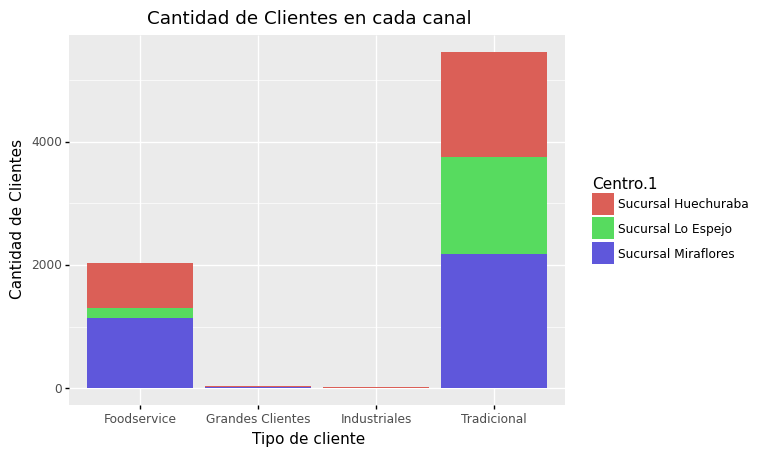

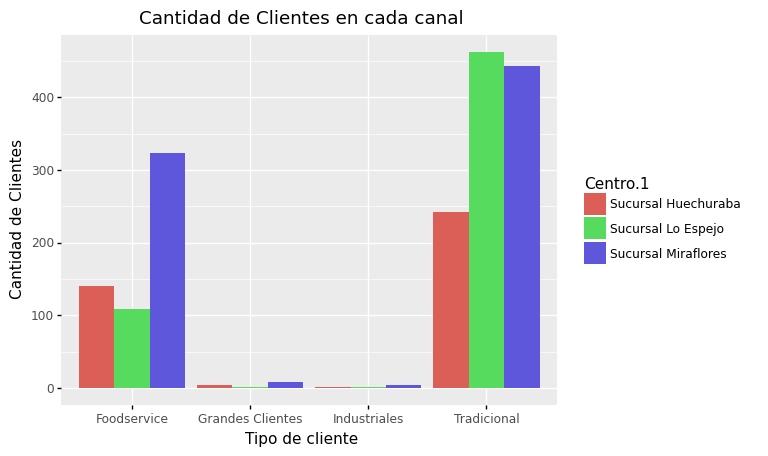

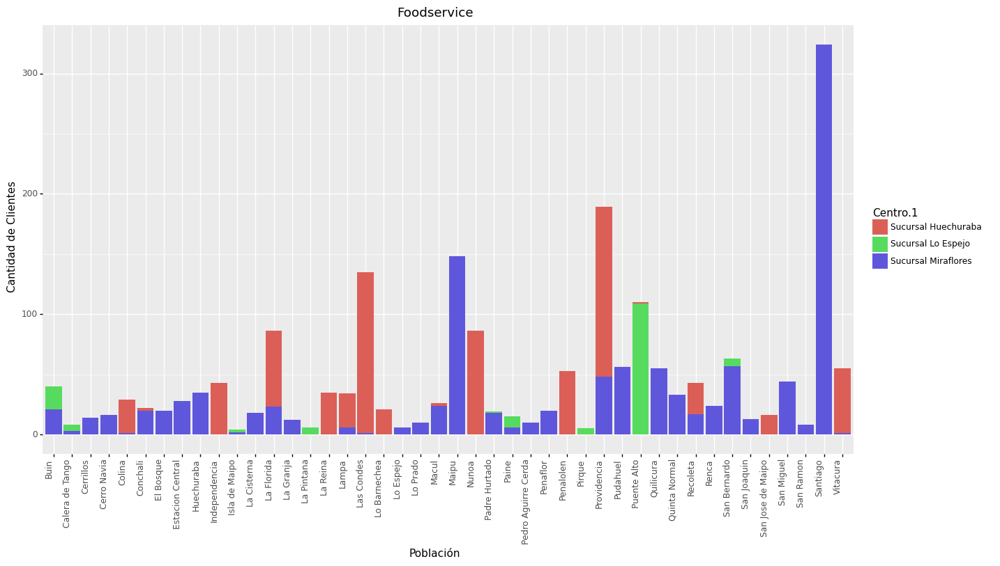

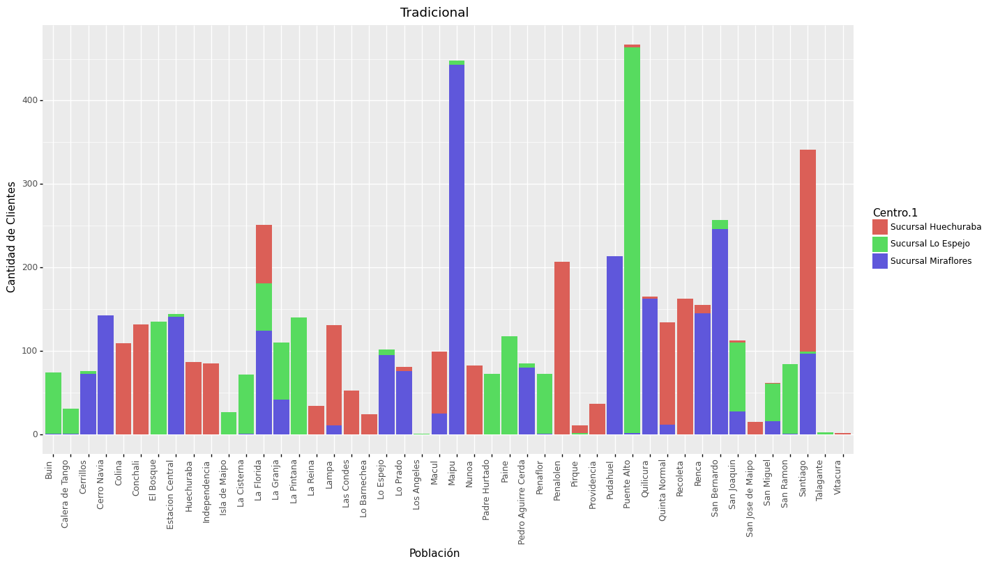

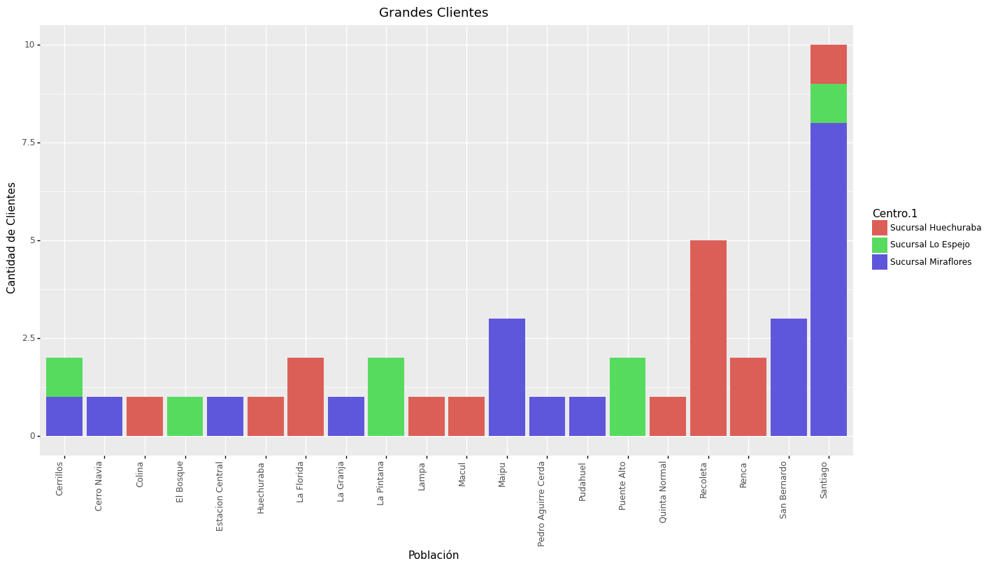

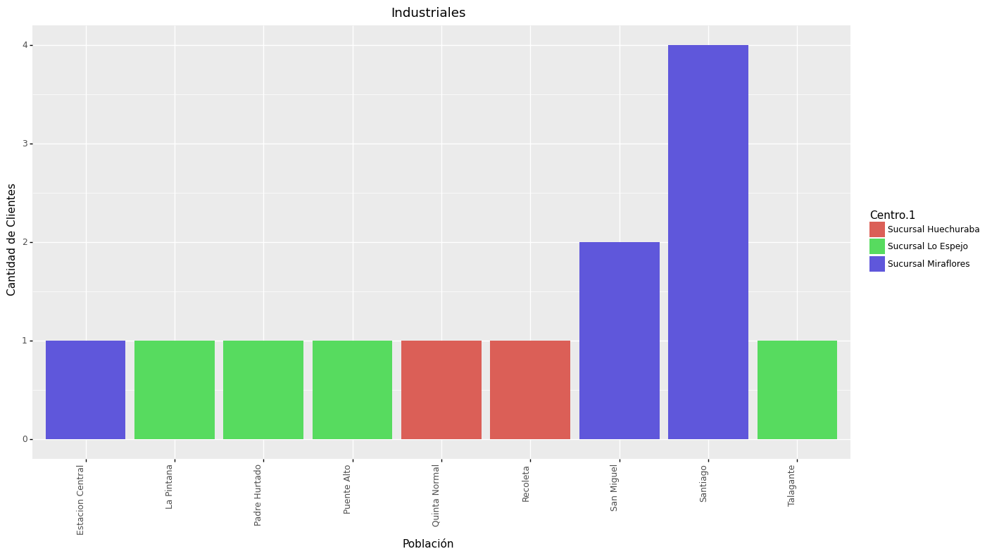

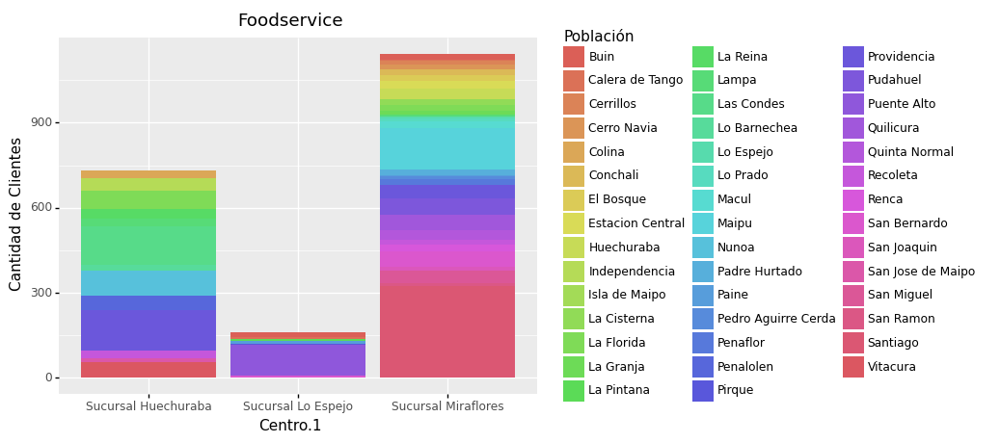

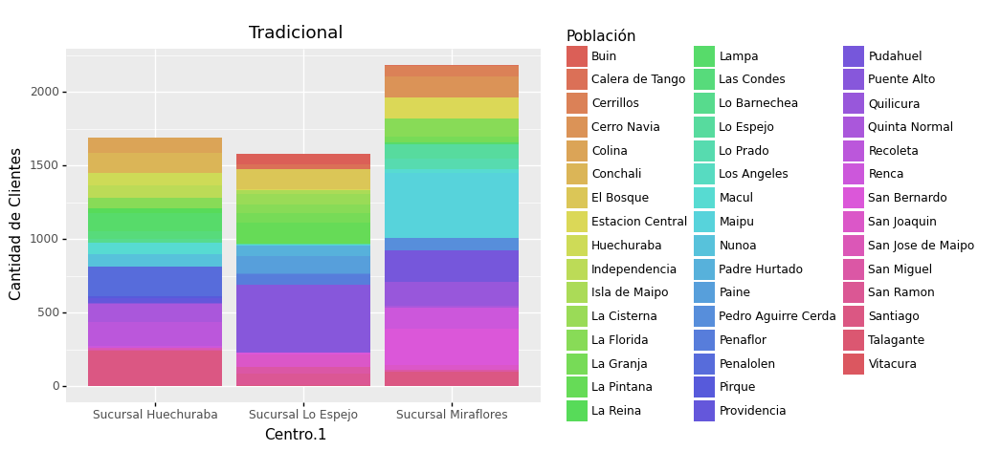

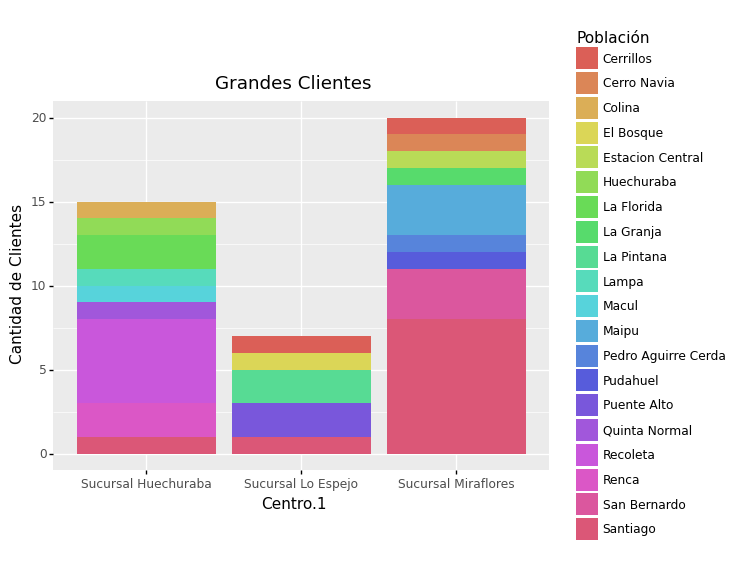

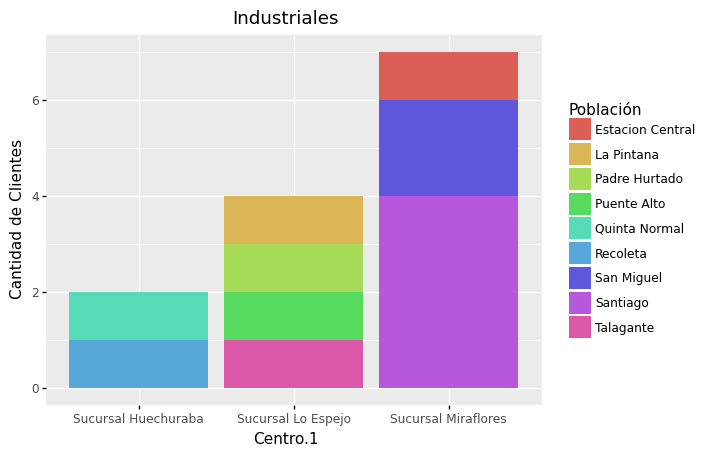

[<ggplot: (145547789306)>,
 <ggplot: (145547740877)>,
 <ggplot: (145547710763)>,
 <ggplot: (145547671805)>,
 <ggplot: (145547645043)>,
 <ggplot: (145547602685)>,
 <ggplot: (145547604947)>,
 <ggplot: (145547604848)>,
 <ggplot: (145547673968)>,
 <ggplot: (145547734995)>]

In [15]:
#dodge_text = position_dodge(width=0.9)
list_ggplot=[]
list_ggplot.append(ggplot(df, aes(x='Tipo de cliente', y='Cantidad de Clientes', fill='Centro.1'))
     
        + geom_col(stat='identity',show_legend=True)
                   
        +ggtitle('Cantidad de Clientes en cada canal')
                  )

list_ggplot.append(ggplot(df, aes(x='Tipo de cliente', y='Cantidad de Clientes', fill='Centro.1'))
     
        + geom_col(position='dodge',show_legend=True)
                   
        +ggtitle('Cantidad de Clientes en cada canal')
                  )

for i in df['Tipo de cliente'].unique():
    print(i)
    list_ggplot.append(
        
        ggplot(df[df['Tipo de cliente']==i], aes(x='Población', y='Cantidad de Clientes', fill='Centro.1'))
         + geom_col()
        +ggtitle(i)
        +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(15,8))
        
    )

for i in df['Tipo de cliente'].unique():
    print(i)
    list_ggplot.append(ggplot(df[df['Tipo de cliente']==i], aes(x='Centro.1', y='Cantidad de Clientes', fill='Población'))
     + geom_col()+ggtitle(i)
    )
    
list_ggplot

#### Cantidad de clientes por compras

In [16]:
#================================================
#Productos con más frecuencia de compra.
#================================================

df=data.groupby(['Material','Tipo de cliente','Centro.1','Cliente'
             ]).count().reset_index().groupby([ 'Material','Tipo de cliente','Centro.1',
             ]).count().reset_index()[[ 'Tipo de cliente','Centro.1','Material','Día natural']]
df=df.rename(columns={'Día natural':'Cantidad de clientes'})
df.head()

,Tipo de cliente,Centro.1,Material,Cantidad de clientes
0,Foodservice,Sucursal Huechuraba,1010002,41
1,Foodservice,Sucursal Lo Espejo,1010002,20
2,Foodservice,Sucursal Miraflores,1010002,144
3,Grandes Clientes,Sucursal Huechuraba,1010002,14
4,Grandes Clientes,Sucursal Lo Espejo,1010002,6


In [17]:
#Ajuste Material
def material_name(x):
    s1=str(x['Material'])
    s2=str(x['Nivel 4.1'])
    return(s1+'\n ('+s2+')')
#df['Material Nombre']=df.apply(lambda x:  material_name(x), axis=1)
DF_Full['Material Nombre']=DF_Full.apply(lambda x:  material_name(x), axis=1)

In [18]:
#==================
# Con Centro
#==================

df=DF_Full.groupby(['Material Nombre','Tipo de cliente','Centro.1','Cliente'
             ]).count().reset_index().groupby([ 'Material Nombre','Tipo de cliente','Centro.1',
             ]).count().reset_index()[[ 'Tipo de cliente','Centro.1','Material Nombre','Día natural']]
df=df.rename(columns={'Día natural':'Cantidad de clientes'})
df.head()

,Tipo de cliente,Centro.1,Material Nombre,Cantidad de clientes
0,Foodservice,Sucursal Huechuraba,1010002\n (Con Menudencia >2.130),41
1,Foodservice,Sucursal Lo Espejo,1010002\n (Con Menudencia >2.130),20
2,Foodservice,Sucursal Miraflores,1010002\n (Con Menudencia >2.130),144
3,Grandes Clientes,Sucursal Huechuraba,1010002\n (Con Menudencia >2.130),14
4,Grandes Clientes,Sucursal Lo Espejo,1010002\n (Con Menudencia >2.130),6


In [19]:


df=DF_Full.groupby(['Material Nombre','Tipo de cliente','Cliente'
             ]).count().reset_index().groupby([ 'Material Nombre','Tipo de cliente'
             ]).count().reset_index()[[ 'Tipo de cliente','Material Nombre','Día natural']]
df=df.rename(columns={'Día natural':'Cantidad de clientes'})
df.head()

,Tipo de cliente,Material Nombre,Cantidad de clientes
0,Foodservice,1010002\n (Con Menudencia >2.130),205
1,Grandes Clientes,1010002\n (Con Menudencia >2.130),40
2,Industriales,1010002\n (Con Menudencia >2.130),2
3,Tradicional,1010002\n (Con Menudencia >2.130),2284
4,Foodservice,1010048\n (Pechuga Entera Selección),969


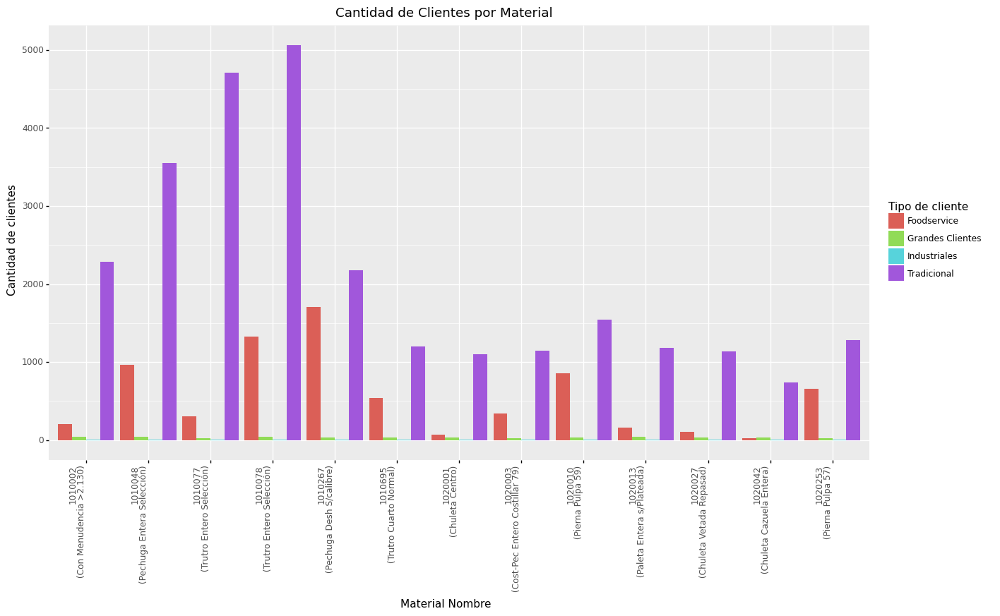

<ggplot: (145573298426)>

In [20]:
#list_ggplot=[]
list_ggplot.append\
(ggplot(df, aes(x='Material Nombre', y='Cantidad de clientes', fill='Tipo de cliente'))
     
        + geom_col(position='dodge',show_legend=True)
                   
        +ggtitle('Cantidad de Clientes'+ ' por Material ')
        
        +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(15,8))
                  )
list_ggplot[len(list_ggplot)-1]

#### Cantidad de clientes por año 

In [21]:
data.head(1)

,Zona de ventas,Zona de ventas.1,Cliente,Cliente.1,Cliente - Local,Cliente - Local.1,Material,Día natural,Kilos Venta KG,Venta Neta,...,Cluster,Segmento,Segmento.1,Categoría Cliente,Zona de reparto,Año Creación,Material Favorito,Semana,Mes,Año
0,Z001,Santiago,10003742,Ferrer Leiva Sonia,Ferrer Leiva Sonia,38458,1010077,2018-02-09,12.0,13685.0,...,Clásico,50,Cobertura Pequeno SD,Especialista en Proc,1513112010,2007,1010077,6,2,2018


In [22]:
DF_Full.columns

Index(['Zona de ventas', 'Zona de ventas.1', 'Cliente', 'Cliente.1',
       'Cliente - Local', 'Cliente - Local.1', 'Material', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio',
       'Frecuencia Historica', 'Centro', 'Centro.1', 'Población',
       'Tipo de cliente', 'Cluster', 'Segmento', 'Segmento.1',
       'Categoría Cliente', 'Zona de reparto', 'Año Creación',
       'Material Favorito', 'Semana', 'Mes', 'Año', 'Nivel 4', 'Nivel 4.1',
       'Sector', 'Tipo de material', 'Tipo de material.1', 'Marca', 'Nivel 2',
       'Granel/Envasado', 'Marinado', 'Nivel 3', 'Grupo artículos', 'Estado',
       'Estandar', 'Envase', 'Material Nombre'],
      dtype='object')

In [23]:
#data_fecha_medio= data_fecha_medio[data_fecha_medio['Precio Promedio'].notna()]
#print(len(data_fecha_medio['Material Nombre'].unique()))


In [24]:
#Agrupación de cantidad de productos que compra al año
df_C=DF_Full.groupby(['Tipo de cliente','Cliente','Año']).count().reset_index()
df_C=df_C[['Tipo de cliente', 'Cliente', 'Año', 'Material']]
df_C=df_C[df_C.Material>0]

#Cantidad de clientes que han comprado en cada año 
df_C=df_C.groupby(['Tipo de cliente','Año']).count().reset_index()
df_C=df_C[['Tipo de cliente', 'Año', 'Cliente']]
#Cambio de nombre
df_C=df_C.rename(columns={'Cliente': 'Cantidad de clientes'})
df_C.head()

,Tipo de cliente,Año,Cantidad de clientes
0,Foodservice,2018,808
1,Foodservice,2019,1105
2,Foodservice,2020,1707
3,Foodservice,2021,2037
4,Grandes Clientes,2018,36


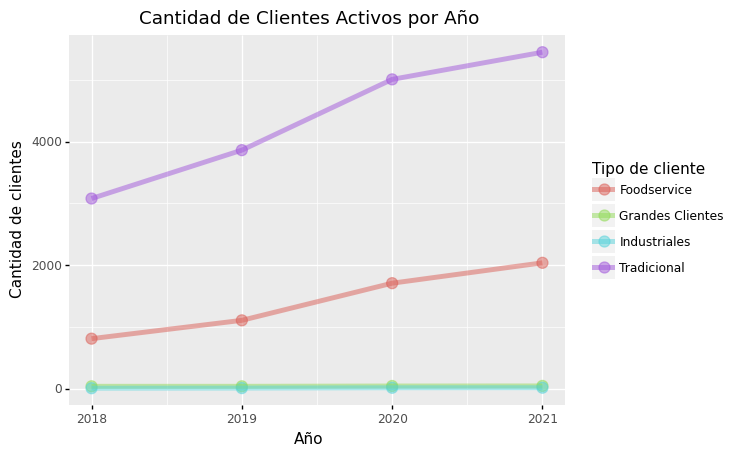

<ggplot: (145573169225)>

In [25]:
ggplot(df_C,
       aes(y='Cantidad de clientes',x='Año',color='Tipo de cliente'))\
+geom_point(size=4, alpha=0.5)\
+geom_line(size=2, alpha=0.5)\
+ggtitle('Cantidad de Clientes Activos por Año')

In [26]:
 df_C.Año.unique()

array([2018, 2019, 2020, 2021], dtype=int64)

In [27]:
df_C
s='Foodservice'

for s in df_C['Tipo de cliente'].unique():
    print(s)
    delta=[]
    for i in [2018, 2019, 2020]:
        
        x_i=df_C[df_C['Tipo de cliente']==s]
        """

        print(x_i[x_i.Año==i].iloc[0],x_i[x_i.Año==(i+1)].iloc[0]
             ,'\n ---------------------------------------------------------------------'
             )
        print(x_i[x_i.Año==i]['Cantidad de clientes'].iloc[0],x_i[x_i.Año==(i+1)]['Cantidad de clientes'].iloc[0])
        """
        delta.append((x_i[x_i.Año==(i+1)]['Cantidad de clientes'].iloc[0] 
                      - x_i[x_i.Año==i]['Cantidad de clientes'].iloc[0])
                    )
    print(delta)
    print(np.mean(delta))
    
print(delta)
print(np.mean(delta))


Foodservice
[297, 602, 330]
409.6666666666667
Grandes Clientes
[0, 5, 1]
2.0
Industriales
[2, 5, 1]
2.6666666666666665
Tradicional
[784, 1147, 440]
790.3333333333334
[784, 1147, 440]
790.3333333333334


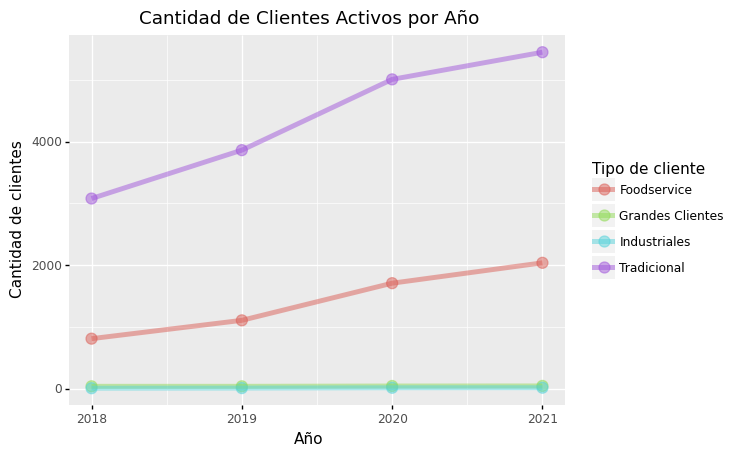

<ggplot: (145572956413)>

In [28]:
list_ggplot.append(
ggplot(df_C,
       aes(y='Cantidad de clientes',x='Año',color='Tipo de cliente'))\
+geom_point(size=4, alpha=0.5)\
+geom_line(size=2, alpha=0.5)\
+ggtitle('Cantidad de Clientes Activos por Año')
)#append
list_ggplot[len(list_ggplot)-1]

#### PDF save

In [29]:
start_time = time.time()
save_as_pdf_pages(list_ggplot,file_direct_Graphic+'/Generales/'+"/Graficos Cantidad de clientes.pdf")
time_convert(time.time()-start_time)

C:\Users\rolft\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/rolft/Documents/Repositorios/Graficos/Generales//Graficos Cantidad de clientes.pdf


Time Lapsed = 0:0:10.888468027114868 
 H:m:s


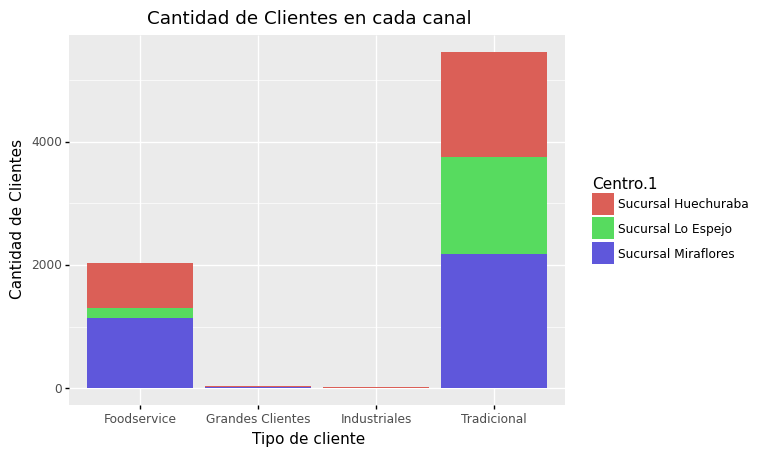

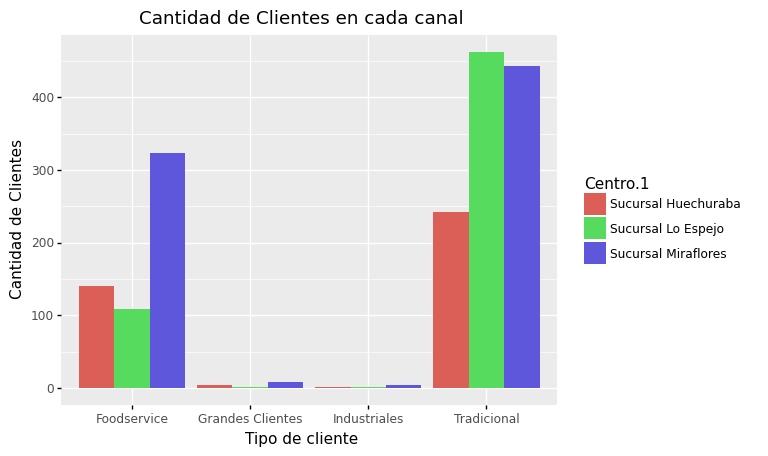

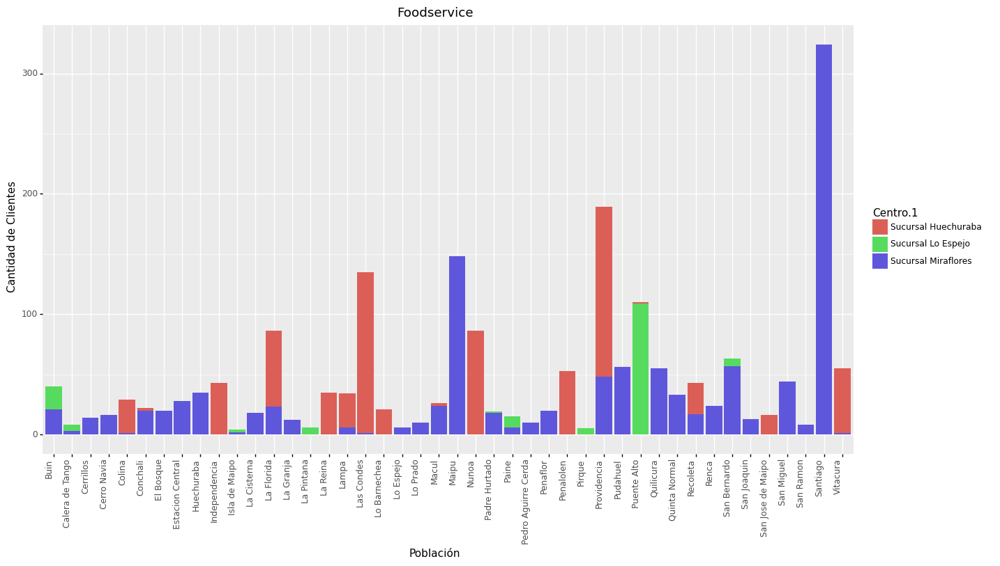

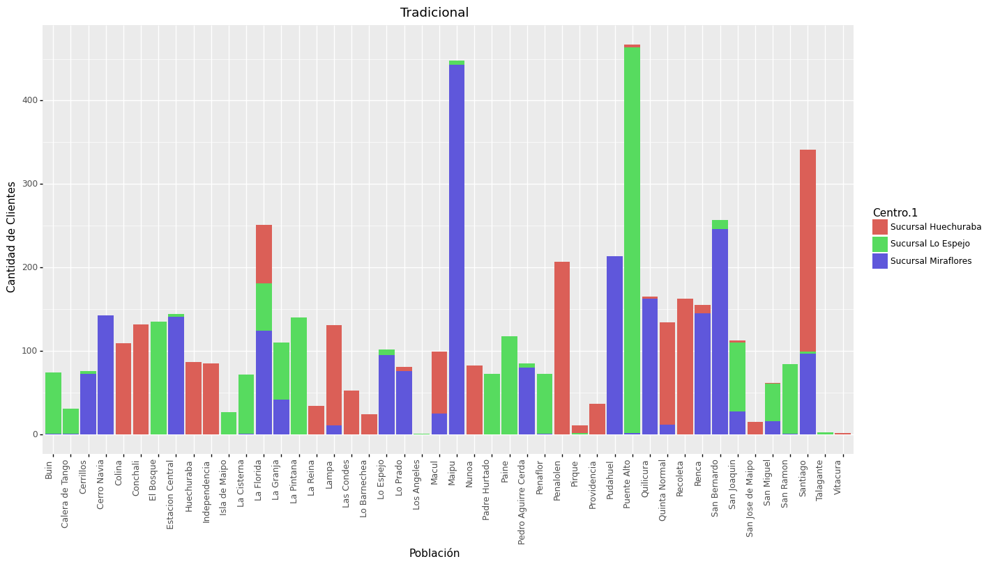

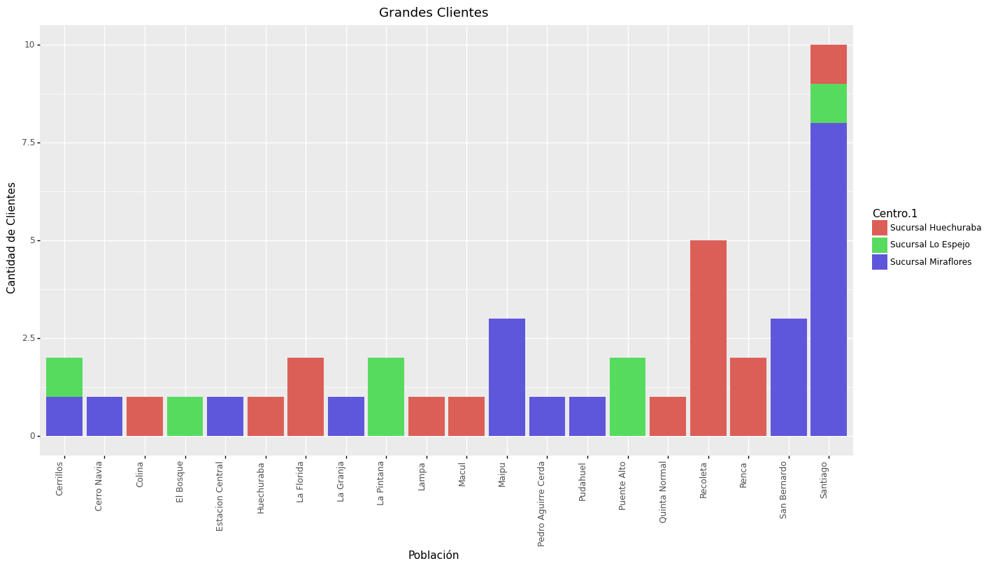

...

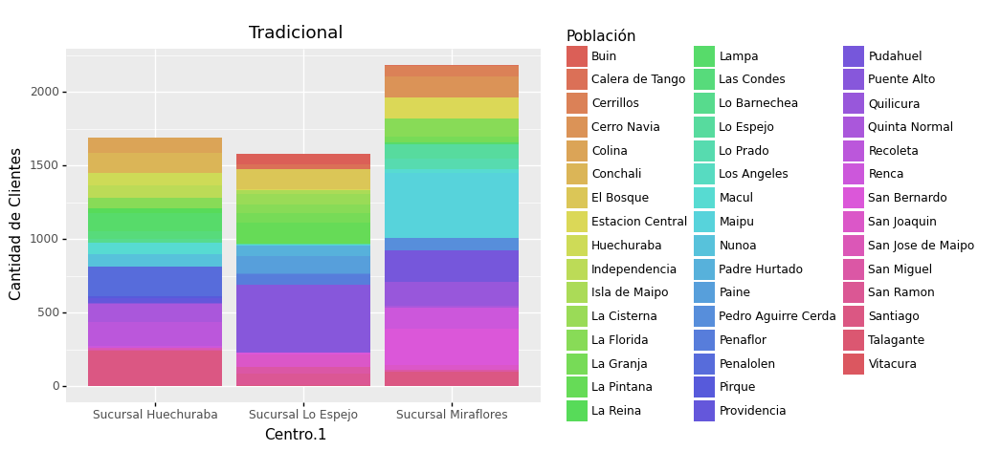

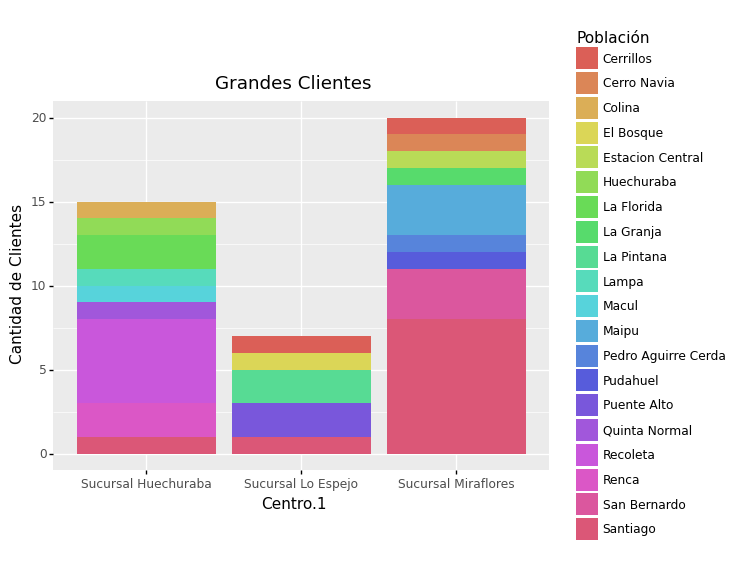

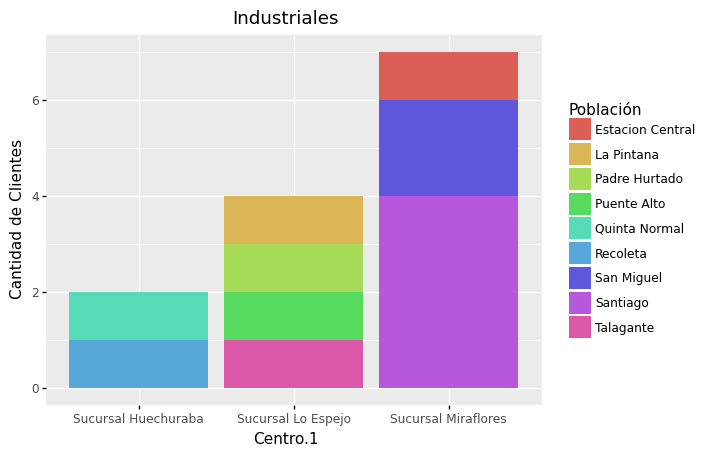

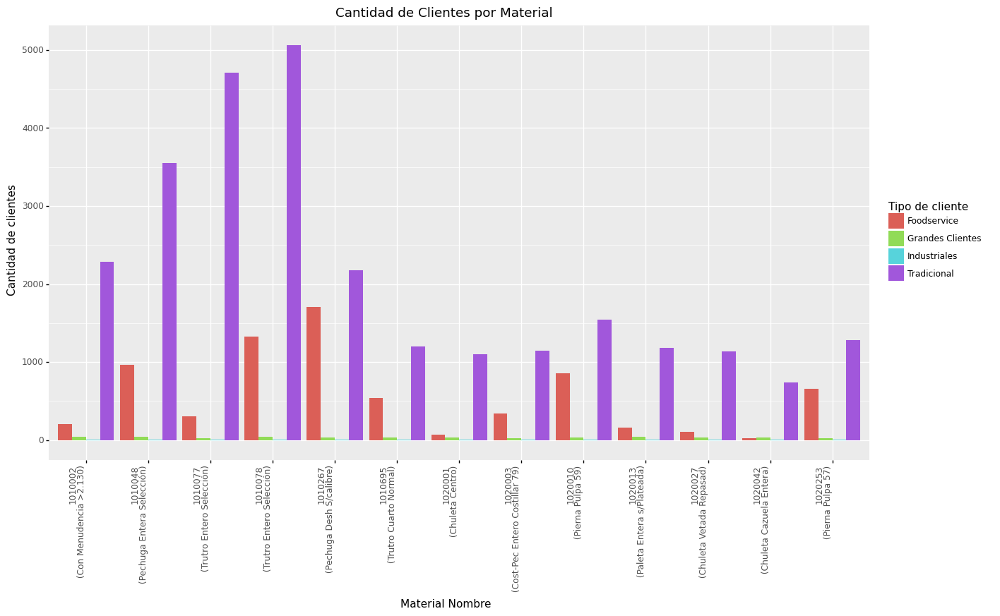

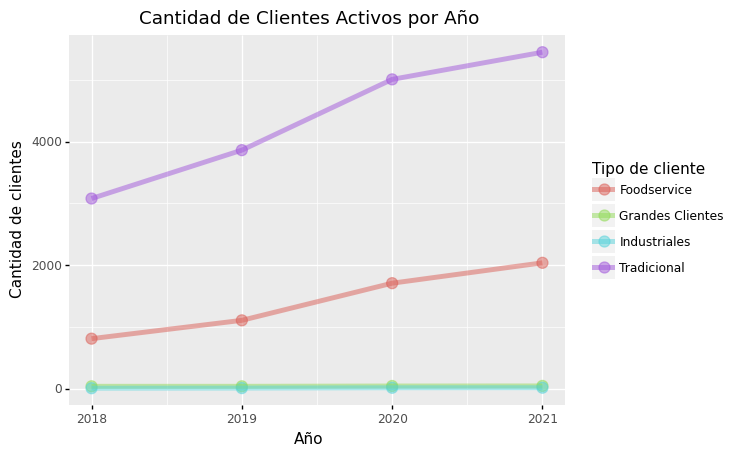

[<ggplot: (145547789306)>,
 <ggplot: (145547740877)>,
 <ggplot: (145547710763)>,
 <ggplot: (145547671805)>,
 <ggplot: (145547645043)>,
 <ggplot: (145547602685)>,
 <ggplot: (145547604947)>,
 <ggplot: (145547604848)>,
 <ggplot: (145547673968)>,
 <ggplot: (145547734995)>,
 <ggplot: (145573298426)>,
 <ggplot: (145572956413)>]

In [30]:
list_ggplot

###  Frecuencia de compra
La cantidad de compras promedio de cada cliente(Anualmente) por Canal.

Productos con más frecuencia de compra

__Fijarse que la frecuencia d compra mensual, no deberia sobrepasar los dias que tiene el mes__
Error surge ya que junta las compras de aos distintas como si fueran realizadas en el mismo año. a causa de no segmentar en un paso por año. previo a calcular el proemdio

In [67]:
#================================================
#La cantidad de compras promedio de cada cliente(Anualmente) por Canal.
#================================================

data.groupby(['Tipo de cliente','Centro.1',
              'Cliente','Día natural'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1','Cliente'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1']).mean()

Día natural  Zona de ventas  \
Tipo de cliente  Centro.1                                           
Foodservice      Sucursal Huechuraba    63.767978       63.767978   
                 Sucursal Lo Espejo     57.153005       57.153005   
                 Sucursal Miraflores    64.936945       64.936945   
Grandes Clientes Sucursal Huechuraba   343.642857      343.642857   
                 Sucursal Lo Espejo    463.625000      463.625000   
                 Sucursal Miraflores   237.631579      237.631579   
Industriales     Sucursal Huechuraba    88.000000       88.000000   
                 Sucursal Lo Espejo     28.000000       28.000000   
                 Sucursal Miraflores    25.714286       25.714286   
Tradicional      Sucursal Huechuraba    71.490288       71.490288   
                 Sucursal Lo Espejo     71.231150       71.231150   
                 Sucursal Miraflores    84.930938       84.930938   

                                      Zona de ventas.1   Cliente.1  \
Tipo de cliente  Centro.1                                            
Foodservice      Sucursal Huechuraba         63.767978   63.767978   
                 Sucursal Lo Espejo          57.153005   57.153005   
                 Sucursal Miraflores         64.936945   64.936945   
Grandes Clientes Sucursal Huechuraba        343.642857  343.642857   
                 Sucursal Lo Espejo         463.625000  463.625000   
                 Sucursal Miraflores        237.631579  237.631579   
Industriales     Sucursal Huechuraba         88.000000   88.000000   
                 Sucursal Lo Espejo          28.000000   28.000000   
                 Sucursal Miraflores         25.714286   25.714286   
Tradicional      Sucursal Huechuraba         71.490288   71.490288   
                 Sucursal Lo Espejo          71.231150   71.231150   
                 Sucursal Miraflores         84.930938   84.930938   

                                      Cliente - Local  Cliente - Local.1  \
Tipo de cliente  Centro.1                                                  
Foodservice      Sucursal Huechuraba        63.767978          63.767978   
                 Sucursal Lo Espejo         57.153005          57.153005   
                 Sucursal Miraflores        64.936945          64.936945   
Grandes Clientes Sucursal Huechuraba       343.642857         343.642857   
                 Sucursal Lo Espejo        463.625000         463.625000   
                 Sucursal Miraflores       237.631579         237.631579   
Industriales     Sucursal Huechuraba        88.000000          88.000000   
                 Sucursal Lo Espejo         28.000000          28.000000   
                 Sucursal Miraflores        25.714286          25.714286   
Tradicional      Sucursal Huechuraba        71.490288          71.490288   
                 Sucursal Lo Espejo         71.231150          71.231150   
                 Sucursal Miraflores        84.930938          84.930938   

                                        Material  Kilos Venta KG  Venta Neta  \
Tipo de cliente  Centro.1                                                      
Foodservice      Sucursal Huechuraba   63.767978       63.767978   63.767978   
                 Sucursal Lo Espejo    57.153005       57.153005   57.153005   
                 Sucursal Miraflores   64.936945       64.936945   64.936945   
Grandes Clientes Sucursal Huechuraba  343.642857      343.642857  343.642857   
                 Sucursal Lo Espejo   463.625000      463.625000  463.625000   
                 Sucursal Miraflores  237.631579      237.631579  237.631579   
Industriales     Sucursal Huechuraba   88.000000       88.000000   88.000000   
                 Sucursal Lo Espejo    28.000000       28.000000   28.000000   
                 Sucursal Miraflores   25.714286       25.714286   25.714286   
Tradicional      Sucursal Huechuraba   71.490288       71.490288   71.490288   
                 Sucursal Lo Espejo    71.231150       71.231150 

In [68]:
#================================================
#La cantidad de compras promedio de cada cliente(Anualmente) por Canal.
#================================================

df=data.groupby(['Tipo de cliente','Centro.1',
              'Cliente','Día natural'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1','Cliente'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1']).mean().reset_index()[['Centro.1',
              'Tipo de cliente','Día natural']]#.head(20)
df=df.rename(columns={'Día natural':'Frecuencia historica promedio'})
df.head()

,Centro.1,Tipo de cliente,Frecuencia historica promedio
0,Sucursal Huechuraba,Foodservice,63.767978
1,Sucursal Lo Espejo,Foodservice,57.153005
2,Sucursal Miraflores,Foodservice,64.936945
3,Sucursal Huechuraba,Grandes Clientes,343.642857
4,Sucursal Lo Espejo,Grandes Clientes,463.625000


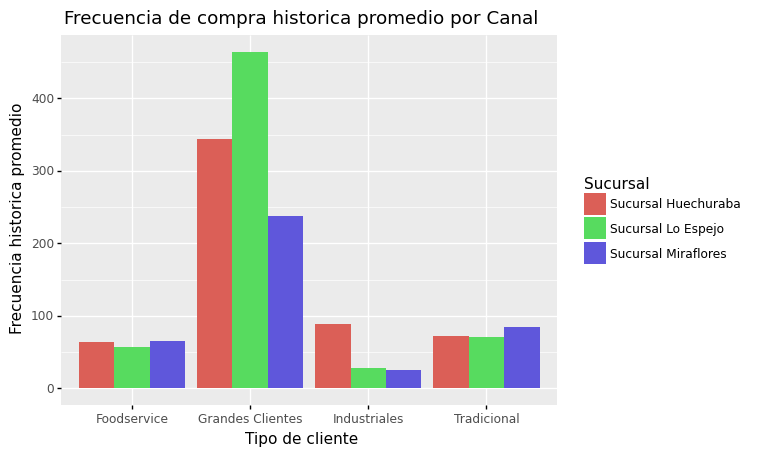

[<ggplot: (121098635918)>]

In [69]:
list_ggplot=[]
list_ggplot.append(ggplot(df.rename(columns={'Centro.1':'Sucursal'}),
                          aes(x='Tipo de cliente', y='Frecuencia historica promedio', fill='Sucursal'))
     
        + geom_col(position='dodge',show_legend=True)
                   
        +ggtitle('Frecuencia de compra historica promedio'+ ' por Canal')
                  )
list_ggplot

#### Frecuencia Anual 

In [70]:
#================================================
#La cantidad de compras promedio de cada cliente(Anualmente) por Canal.
#================================================

df=data.groupby(['Tipo de cliente','Año',
              'Cliente','Día natural'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Año','Cliente'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Año']).mean().reset_index()[['Año',
              'Tipo de cliente','Día natural']]#.head(20)
df.Año=df.Año.astype('category')
df=df.rename(columns={'Día natural':'Frecuencia de compra promedio'})
df.head()
#frecuencia promedio de cada año para cada Canal
#--------------------------------------------------

,Año,Tipo de cliente,Frecuencia de compra promedio
0,2018,Foodservice,32.721472
1,2019,Foodservice,27.730873
2,2020,Foodservice,19.808163
3,2021,Foodservice,19.123656
4,2018,Grandes Clientes,105.250000


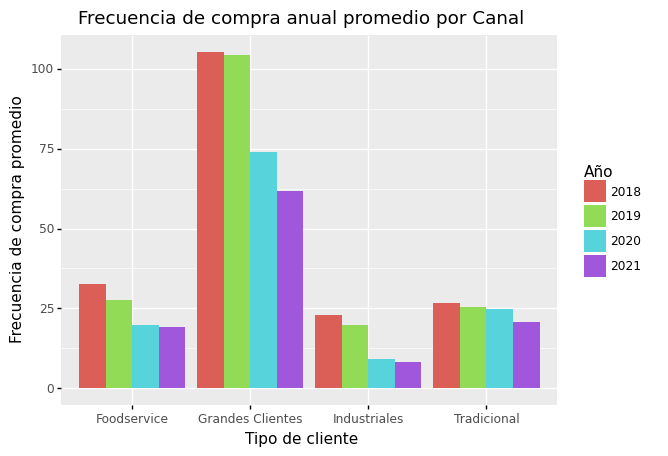

<ggplot: (121124648753)>

In [71]:
list_ggplot.append(ggplot(df,
                          aes(x='Tipo de cliente', y='Frecuencia de compra promedio', fill='Año'))
     
        + geom_col(position='dodge',show_legend=True)
                   
        +ggtitle('Frecuencia de compra anual promedio'+ ' por Canal')
                  )
list_ggplot[len(list_ggplot)-1]

##### Mensual

###### Paso a Paso 

In [72]:
"""
.reset_index().groupby([ 'Tipo de cliente','Mes','Cliente'
             ]).count()

.reset_index().groupby([ 'Tipo de cliente','Mes']).mean()

.reset_index()[['Mes','Tipo de cliente','Día natural']]#.head(20)
"""
data.groupby(['Tipo de cliente','Mes',
              'Cliente','Día natural']).count()


Zona de ventas  Zona de ventas.1  \
Tipo de cliente Mes Cliente  Día natural                                     
Foodservice     1   10013064 2021-01-13                1                 1   
                    10014397 2020-01-15                1                 1   
                             2021-01-09                2                 2   
                             2021-01-16                1                 1   
                             2021-01-23                1                 1   
...                                                  ...               ...   
Tradicional     12  9994662  2020-12-17                1                 1   
                    9994800  2020-12-16                1                 1   
                    9997223  2019-12-11                1                 1   
                             2020-12-09                1                 1   
                             2020-12-19                1                 1   

                                          Cliente.1  Cliente - Local  \
Tipo de cliente Mes Cliente  Día natural                               
Foodservice     1   10013064 2021-01-13           1                1   
                    10014397 2020-01-15           1                1   
                             2021-01-09           2                2   
                             2021-01-16           1                1   
                             2021-01-23           1                1   
...                                             ...              ...   
Tradicional     12  9994662  2020-12-17           1                1   
                    9994800  2020-12-16           1                1   
                    9997223  2019-12-11           1                1   
                             2020-12-09           1                1   
                             2020-12-19           1                1   

                                          Cliente - Local.1  Material  \
Tipo de cliente Mes Cliente  Día natural                                
Foodservice     1   10013064 2021-01-13                   1         1   
                    10014397 2020-01-15                   1         1   
                             2021-01-09                   2         2   
                             2021-01-16                   1         1   
                             2021-01-23                   1         1   
...                                                     ...       ...   
Tradicional     12  9994662  2020-12-17                   1         1   
                    9994800  2020-12-16                   1         1   
                    9997223  2019-12-11                   1         1   
                             2020-12-09                   1         1   
                             2020-12-19                   1         1   

                                          Kilos Venta KG  Venta Neta  \
Tipo de cliente Mes Cliente  Día natural                               
Foodservice     1   10013064 2021-01-13                1           1   
                    10014397 2020-01-15                1           1   
                             2021-01-09                2           2   
                             2021-01-16                1           1   
                             2021-01-23                1           1   
...                                                  ...         ...   
Tradicional     12  9994662  2020-12-17                1           1   
                    9994800  2020-12-16                1           1   
                    9997223  2019-12-11                1           1   
                             2020-12-09                1           1   
                             2020-12-19                1           1   

                                          Precio Promedio  \
Tipo de cliente Mes Cliente  Día natural                    
Foodservice     1   10013064 2021-01-13                 1   
                    

<AxesSubplot:>

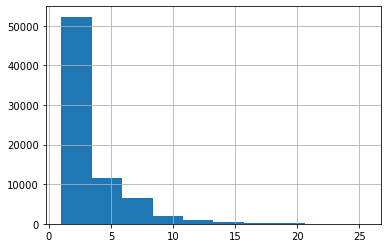

In [73]:
data.groupby(['Tipo de cliente','Mes','Cliente','Año'
              ,'Día natural']).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente','Año'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente'
             ]).mean().reset_index()['Día natural'].hist()

In [74]:
"""
.reset_index().groupby([ 'Tipo de cliente','Mes']).mean()

.reset_index()[['Mes','Tipo de cliente','Día natural']]#.head(20)
"""
df_x=data.groupby(['Tipo de cliente','Mes','Cliente','Año'
              ,'Día natural']).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente','Año'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente'
             ]).mean().reset_index().groupby([ 'Tipo de cliente','Mes'
             ]).mean().reset_index()[['Mes','Tipo de cliente','Día natural']]#.head(20)
df_x#[df_x['Tipo de cliente']=='Grandes Clientes']

,Mes,Tipo de cliente,Día natural
0,1,Foodservice,2.986713
1,2,Foodservice,2.863542
2,3,Foodservice,2.992364
3,4,Foodservice,2.907955
4,5,Foodservice,2.895037
5,6,Foodservice,2.907112
6,7,Foodservice,3.044369
7,8,Foodservice,3.232858
8,9,Foodservice,2.906169
9,10,Foodservice,2.974625


In [75]:
"""
.reset_index()[['Mes','Tipo de cliente','Día natural']]#.head(20)
"""
data.groupby(['Tipo de cliente','Mes',
              'Cliente','Día natural']).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Mes']).mean()


Día natural  Zona de ventas  Zona de ventas.1  \
Tipo de cliente  Mes                                                  
Foodservice      1       7.204068        7.204068          7.204068   
                 2       6.739386        6.739386          6.739386   
                 3       6.999389        6.999389          6.999389   
                 4       6.146857        6.146857          6.146857   
                 5       6.346486        6.346486          6.346486   
                 6       6.342735        6.342735          6.342735   
                 7       6.701365        6.701365          6.701365   
                 8       7.299609        7.299609          7.299609   
                 9       6.566298        6.566298          6.566298   
                 10      6.993258        6.993258          6.993258   
                 11      6.097627        6.097627          6.097627   
                 12      6.164642        6.164642          6.164642   
Grandes Clientes 1      30.157895       30.157895         30.157895   
                 2      28.710526       28.710526         28.710526   
                 3      32.600000       32.600000         32.600000   
                 4      28.150000       28.150000         28.150000   
                 5      28.894737       28.894737         28.894737   
                 6      27.024390       27.024390         27.024390   
                 7      29.463415       29.463415         29.463415   
                 8      29.925000       29.925000         29.925000   
                 9      26.157895       26.157895         26.157895   
                 10     26.463415       26.463415         26.463415   
                 11     22.263158       22.263158         22.263158   
                 12     21.894737       21.894737         21.894737   
Industriales     1       5.714286        5.714286          5.714286   
                 2       3.800000        3.800000          3.800000   
                 3       4.285714        4.285714          4.285714   
                 4       4.333333        4.333333          4.333333   
                 5       4.428571        4.428571          4.428571   
                 6       3.000000        3.000000          3.000000   
                 7       3.083333        3.083333          3.083333   
                 8       4.000000        4.000000          4.000000   
                 9       3.750000        3.750000          3.750000   
                 10      4.461538        4.461538          4.461538   
                 11      5.000000        5.000000          5.000000   
                 12      4.300000        4.300000          4.300000   
Tradicional      1       7.874939        7.874939          7.874939   
                 2       7.103540        7.103540          7.103540   
                 3       8.408970        8.408970          8.408970   
                 4       7.997014        7.997014          7.997014   
                 5       7.800655        7.800655          7.800655   
                 6       7.952660        7.952660          7.952660   
                 7       8.282147        8.282147          8.282147   
                 8       8.562879        8.562879          8.562879   
                 9       7.524201        7.524201          7.524201   
                 10      8.032939        8.032939          8.032939   
                 11      6.763785        6.763785          6.763785   
                 12      6.759313        6.759313          6.759313   

                      Cliente.1  Cliente - Local  Cliente - Local.1  \
Tipo de cliente  Mes                                                  
Foodservice      1     7.204068         7.204068           7.204068   
                 2     6.739386         6.739386           6.739386   
                 3     6.999389         6.999389           6.999389   
                 4     6.146857         6.146857           6.146857   
                 5     6.346486         6.346

In [76]:
"""
#.head(20)
"""
data.groupby(['Tipo de cliente','Mes',
              'Cliente','Día natural']).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Mes']).mean().reset_index()[['Mes','Tipo de cliente','Día natural']]


,Mes,Tipo de cliente,Día natural
0,1,Foodservice,7.204068
1,2,Foodservice,6.739386
2,3,Foodservice,6.999389
3,4,Foodservice,6.146857
4,5,Foodservice,6.346486
5,6,Foodservice,6.342735
6,7,Foodservice,6.701365
7,8,Foodservice,7.299609
8,9,Foodservice,6.566298
9,10,Foodservice,6.993258


###### Aplicación 

In [77]:
#================================================
#La cantidad de compras promedio de cada cliente(Anualmente) por Canal.
#================================================

df=data.groupby(['Tipo de cliente','Mes','Cliente','Año'
              ,'Día natural']).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente','Año'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Mes','Cliente'
             ]).mean().reset_index().groupby([ 'Tipo de cliente','Mes'
             ]).mean().reset_index()[['Mes','Tipo de cliente','Día natural']]#.head(20)#.head(20)
df.Mes=df.Mes.apply(lambda x: Mes_name(x))
df=df.rename(columns={'Día natural':'Frecuencia de compra promedio'})
df.head()
#frecuencia promedio de cada año para cada Canal
#--------------------------------------------------

,Mes,Tipo de cliente,Frecuencia de compra promedio
0,Enero,Foodservice,2.986713
1,Febrero,Foodservice,2.863542
2,Marzo,Foodservice,2.992364
3,Abril,Foodservice,2.907955
4,Mayo,Foodservice,2.895037


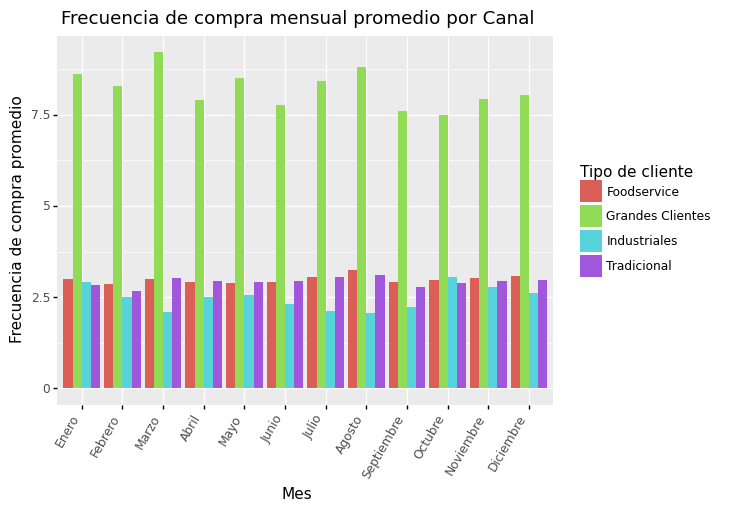

<ggplot: (121098586543)>

In [78]:
list_ggplot.append(ggplot(df,
            aes(x='Mes', y='Frecuencia de compra promedio', fill='Tipo de cliente'))
     
        + geom_col(position='dodge',show_legend=True)
                   
        +ggtitle('Frecuencia de compra mensual promedio'+ ' por Canal')

+ scale_x_discrete(limits= ['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre'])
                     +theme(axis_text_x = element_text(angle=60, hjust=1))
                            #,figure_size=(15,8))
                  
                  
)
list_ggplot[len(list_ggplot)-1]

#### Por Material promedio Anual


posee Errores en el calculo, ya que no segmenta bien 

In [79]:
#======================
# SUCURSAL
#====================
data.groupby(['Tipo de cliente','Centro.1',
              'Cliente','Material','Día natural'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1','Cliente','Material'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1','Material']).mean()

Día natural  Zona de ventas  \
Tipo de cliente Centro.1            Material                                
Foodservice     Sucursal Huechuraba 1010002      7.595238        7.595238   
                                    1010048     32.501577       32.501577   
                                    1010077      4.384615        4.384615   
                                    1010078     23.991935       23.991935   
                                    1010267     47.307325       47.307325   
...                                                   ...             ...   
Tradicional     Sucursal Miraflores 1020010     20.570571       20.570571   
                                    1020013     25.092224       25.092224   
                                    1020027     25.609127       25.609127   
                                    1020042     16.669697       16.669697   
                                    1020253     13.299645       13.299645   

                                              Zona de ventas.1  Cliente.1  \
Tipo de cliente Centro.1            Material                                
Foodservice     Sucursal Huechuraba 1010002           7.595238   7.595238   
                                    1010048          32.501577  32.501577   
                                    1010077           4.384615   4.384615   
                                    1010078          23.991935  23.991935   
                                    1010267          47.307325  47.307325   
...                                                        ...        ...   
Tradicional     Sucursal Miraflores 1020010          20.570571  20.570571   
                                    1020013          25.092224  25.092224   
                                    1020027          25.609127  25.609127   
                                    1020042          16.669697  16.669697   
                                    1020253          13.299645  13.299645   

                                              Cliente - Local  \
Tipo de cliente Centro.1            Material                    
Foodservice     Sucursal Huechuraba 1010002          7.595238   
                                    1010048         32.501577   
                                    1010077          4.384615   
                                    1010078         23.991935   
                                    1010267         47.307325   
...                                                       ...   
Tradicional     Sucursal Miraflores 1020010         20.570571   
                                    1020013         25.092224   
                                    1020027         25.609127   
                                    1020042         16.669697   
                                    1020253         13.299645   

                                              Cliente - Local.1  \
Tipo de cliente Centro.1            Material                      
Foodservice     Sucursal Huechuraba 1010002            7.595238   
                                    1010048           32.501577   
                                    1010077            4.384615   
                                    1010078           23.991935   
                                    1010267           47.307325   
...                                                         ...   
Tradicional     Sucursal Miraflores 1020010           20.570571   
                                    1020013           25.092224   
                                    1020027           25.609127   
                                    1020042           16.669697   
                                    1020253           13.299645   

                                              Kilos Venta KG  Venta Neta  \
Tipo de cliente Centro.1            Material                               
Foodservice     Sucursal Huechuraba 1010002         7.595238    7.595238   
                                    1010048        32.501577   32.501577   
                    

In [80]:
#================================================
#Productos con más frecuencia de compra.
#================================================

df=DF_Full.groupby(['Tipo de cliente','Centro.1',
              'Cliente','Material Nombre','Año','Día natural'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1','Cliente','Material Nombre','Año'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Centro.1','Material Nombre','Año']).mean().reset_index()\
[[ 'Tipo de cliente','Centro.1','Material Nombre','Año','Día natural']]
df=df.rename(columns={'Día natural':'Frecuencia historica promedio'})
df.head()

,Tipo de cliente,Centro.1,Material Nombre,Año,Frecuencia historica promedio
0,Foodservice,Sucursal Huechuraba,1010002\n (Con Menudencia >2.130),2018,7.500000
1,Foodservice,Sucursal Huechuraba,1010002\n (Con Menudencia >2.130),2019,8.294118
2,Foodservice,Sucursal Huechuraba,1010002\n (Con Menudencia >2.130),2020,3.166667
3,Foodservice,Sucursal Huechuraba,1010002\n (Con Menudencia >2.130),2021,2.777778
4,Foodservice,Sucursal Huechuraba,1010048\n (Pechuga Entera Selección),2018,23.983740


In [81]:
#================================================
#Productos con más frecuencia de compra.
#================================================

df=DF_Full.groupby(['Tipo de cliente',
              'Cliente','Material Nombre','Año','Día natural'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Cliente','Material Nombre','Año'
             ]).count().reset_index().groupby([ 'Tipo de cliente','Material Nombre']).mean().reset_index()\
[[ 'Tipo de cliente','Material Nombre','Día natural']]
df=df.rename(columns={'Día natural':'Frecuencia de compra promedio'})
df.head()

,Tipo de cliente,Material Nombre,Frecuencia de compra promedio
0,Foodservice,1010002\n (Con Menudencia >2.130),7.754902
1,Foodservice,1010048\n (Pechuga Entera Selección),14.757779
2,Foodservice,1010077\n (Trutro Entero Selección),2.443936
3,Foodservice,1010078\n (Trutro Entero Selección),10.754182
4,Foodservice,1010267\n (Pechuga Desh S/calibre),18.983151


In [82]:
#==========
#Corregido
#=================
df=DF_Full.groupby(['Tipo de cliente',
              'Cliente','Material Nombre','Año','Día natural'
             ]).count()\
            .reset_index().groupby([ 'Tipo de cliente','Cliente','Material Nombre','Año']).count()\
           .reset_index().groupby([ 'Tipo de cliente','Material Nombre', 'Cliente']).mean()\
            .reset_index().groupby([ 'Tipo de cliente','Material Nombre']).mean()\
            .reset_index()[[ 'Tipo de cliente','Material Nombre','Día natural']]
df=df.rename(columns={'Día natural':'Frecuencia de compra promedio'})
df.head()

,Tipo de cliente,Material Nombre,Frecuencia de compra promedio
0,Foodservice,1010002\n (Con Menudencia >2.130),4.864332
1,Foodservice,1010048\n (Pechuga Entera Selección),10.284872
2,Foodservice,1010077\n (Trutro Entero Selección),2.059406
3,Foodservice,1010078\n (Trutro Entero Selección),8.097785
4,Foodservice,1010267\n (Pechuga Desh S/calibre),15.653053


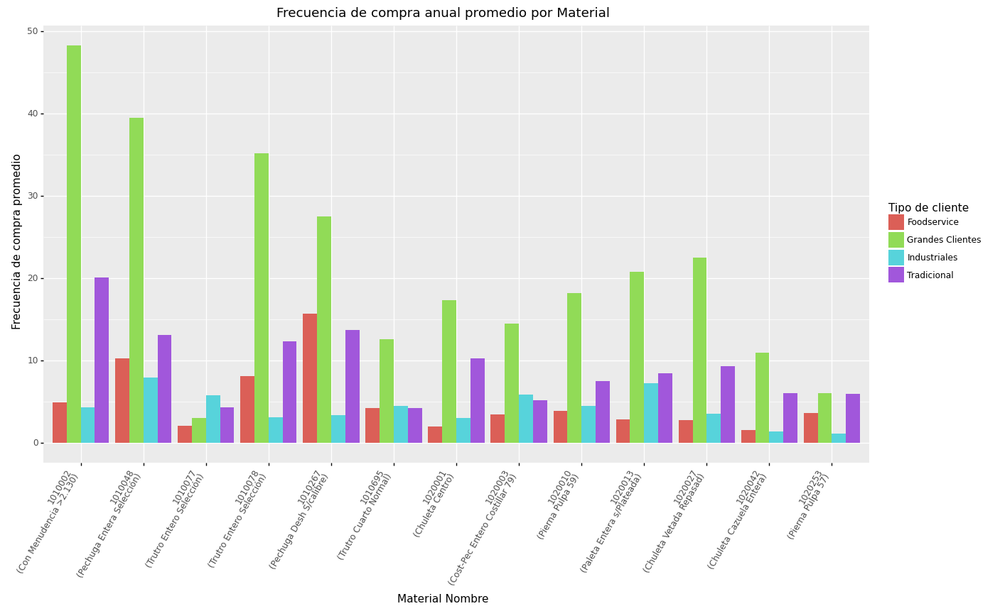

<ggplot: (121098795593)>

In [83]:
#list_ggplot=[]
list_ggplot.append(ggplot(df, aes(x='Material Nombre', y='Frecuencia de compra promedio', fill='Tipo de cliente'))
     
        + geom_col(position='dodge',show_legend=True)
                   
        +ggtitle('Frecuencia de compra anual promedio'+ ' por Material')
        
        +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
                  )
list_ggplot[len(list_ggplot)-1]

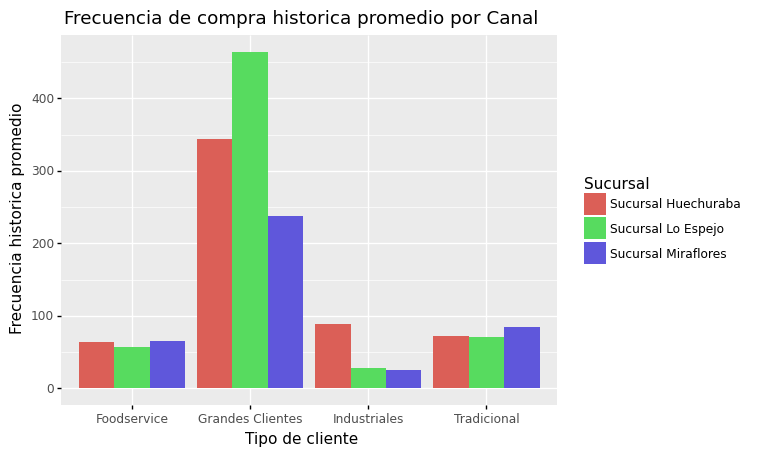

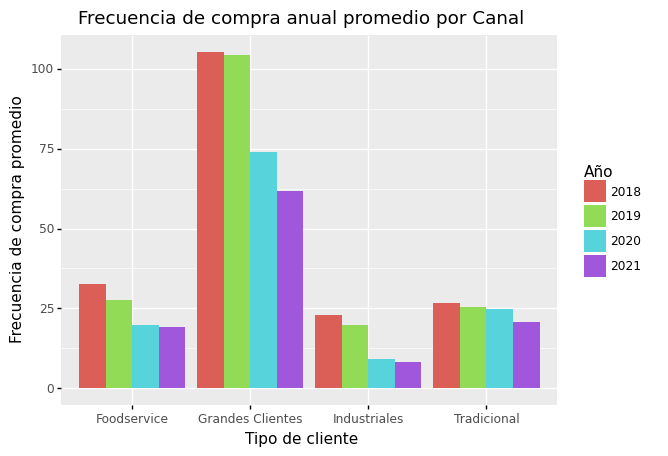

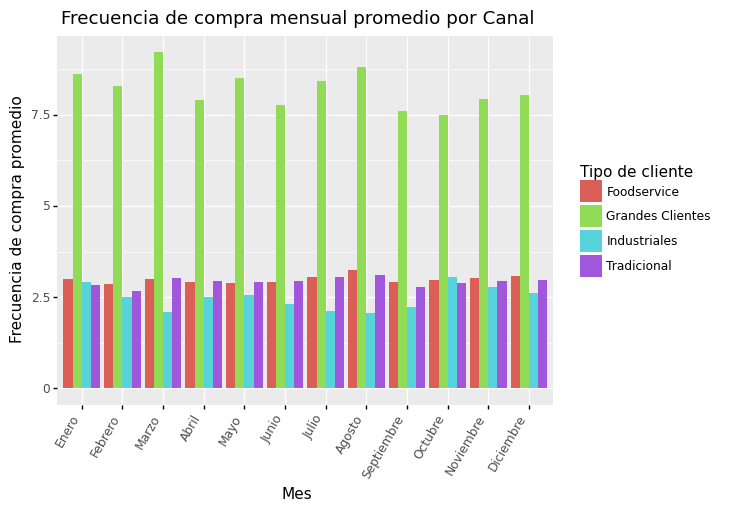

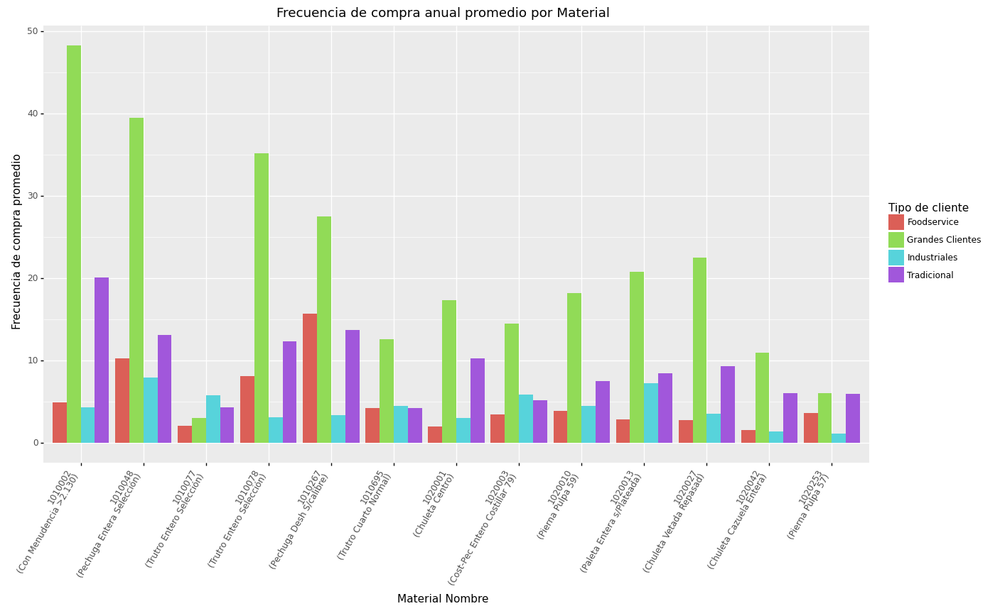

[<ggplot: (121098635918)>,
 <ggplot: (121124648753)>,
 <ggplot: (121098586543)>,
 <ggplot: (121098795593)>]

In [84]:
list_ggplot

#### PDF save 

In [85]:
save_as_pdf_pages(list_ggplot,file_direct_Graphic+'/Generales/'+"/Frecuencia de Compra.pdf")

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Frecuencia de Compra.pdf


# Material Precios y volumen por venta

## Box plot material Cliente 

##### Data

In [13]:
#'Material Nombre'
DF_Full.columns

Index(['Zona de ventas', 'Zona de ventas.1', 'Cliente', 'Cliente.1',
       'Cliente - Local', 'Cliente - Local.1', 'Material', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio',
       'Frecuencia Historica', 'Centro', 'Centro.1', 'Población',
       'Tipo de cliente', 'Cluster', 'Segmento', 'Segmento.1',
       'Categoría Cliente', 'Zona de reparto', 'Año Creación',
       'Material Favorito', 'Semana', 'Mes', 'Año', 'Nivel 4', 'Nivel 4.1',
       'Sector', 'Tipo de material', 'Tipo de material.1', 'Marca', 'Nivel 2',
       'Granel/Envasado', 'Marinado', 'Nivel 3', 'Grupo artículos', 'Estado',
       'Estandar', 'Envase', 'Material Nombre'],
      dtype='object')

In [14]:
df=DF_Full.copy()

### Filtrado 

- De las transacciones que se encuentran en los datos 
__¿Qué porcentaje de ellas sobrepasa la media tonelada?__

- De los regristros de cada canal 
__¿Qué porcentaje de las facturaciones de cada canal sobrepasan la media tonelada?__

- Para cada canal, 
__¿Qué porcentaje de clientes del canal, en promedio de sus transacciones (por material o ind) sobrepasan la media tonelada?__

#### Preguntas de Filtrado

#####  preguntas 1 a 2

In [15]:
X_G='Material Nombre'
y_G='Kilos Venta KG'
Color_G='Tipo de cliente'

###### Distribucion por año

In [16]:
df[[y_G,'Material Nombre','Tipo de cliente']].std()

Kilos Venta KG    285.128327
dtype: float64

In [17]:
df[[y_G,'Material Nombre','Año','Tipo de cliente']].groupby('Año').describe()

Kilos Venta KG                                                        
              count        mean         std  min   25%   50%   75%      max
Año                                                                        
2018       213147.0  113.015431  381.078910  1.0  22.0  39.0  74.0  52550.0
2019       249253.0   92.936121  266.458422  2.0  22.0  39.0  67.0  21625.0
2020       306741.0   86.620113  275.937985  2.0  22.0  36.0  66.0  23767.0
2021       290521.0   78.853191  219.439736  2.0  22.0  36.0  66.0  23710.0

###### Porcentaje de las transacciones por material, que sobrepasan la  tonelada

In [18]:
Segm='Material Nombre'

Proporci=[]
for m in df[Segm].unique():
    Proporci.append(df[(df[Segm]==m)&
                       (df[y_G]>0.5*10**3)
                      ].shape[0]/\
     df[(df[Segm]==m)].shape[0]*100)

df_Proporci=    pd.DataFrame(
    { Segm:df[Segm].unique(),
    'Casos sobre tonelada %':Proporci
    })
print('Promedio',(df_Proporci.iloc[:,1]).mean())
df_Proporci

Promedio 3.3336019009332074


,Material Nombre,Casos sobre tonelada %
0,1010077\n (Trutro Entero Selección),0.267044
1,1010078\n (Trutro Entero Selección),3.406479
2,1010048\n (Pechuga Entera Selección),2.604707
3,1020253\n (Pierna Pulpa 57),1.899952
4,1020042\n (Chuleta Cazuela Entera),1.360038
5,1020027\n (Chuleta Vetada Repasad),2.140985
6,1020013\n (Paleta Entera s/Plateada),7.871309
7,1020010\n (Pierna Pulpa 59),3.206761
8,1020003\n (Cost-Pec Entero Costillar 79),2.537205
9,1020001\n (Chuleta Centro),1.135442


###### Porcentaje de las transacciones por CANAL que sobrepasan la media tonelada

codigo

In [23]:
Segm='Tipo de cliente'
Proporci=[]
for m in df[Segm].unique():
    Proporci.append(df[(df[Segm]==m)&
                       (df[y_G]>0.5*10**3)
                      ].shape[0]/\
     df[(df[Segm]==m)].shape[0]*100)

df_Proporci=    pd.DataFrame(
    { Segm:df[Segm].unique(),
    'Casos sobre tonelada %':Proporci
    })
out=[
('Promedio',(df_Proporci.iloc[:,1]).mean())
,('Promedio excluyendo a grandes clientes',df_Proporci[
    df_Proporci[Segm]!='Grandes Clientes'
].mean() )
,df_Proporci]

resultado 

In [26]:
for i in out[:2]:
    print(i)
out[2]

('Promedio', 7.839474185888061)
('Promedio excluyendo a grandes clientes', Casos sobre tonelada %    2.667329
dtype: float64)


,Tipo de cliente,Casos sobre tonelada %
0,Tradicional,2.037552
1,Foodservice,1.890360
2,Grandes Clientes,23.355910
3,Industriales,4.074074


#####  ¿Qué porcentaje de clientes del canal, en promedio de sus transacciones (por material o ind) sobrepasan la media tonelada?

__Plan de trabajo:__
1. Hacer un grouoby que calcule el proemdio de las toneladas, por cliente, para así estiamr el pedido promedio de cad cliente.
2. Atributos de estos clientes que deben ser guardados
    - Tipo de cliente (Canal)
    -  Material tal vez
    - Año
3. tomar en cuenta que entre más atributos en el primer groupby, se segmenta a tal que el analisis puiede ser erroneo.

4. desde el groupby, se crea un dataframe, este se utiliza para segmentar al numero de clientes que tienen en promedio un pedido sobre la tonelada o media tonelada, para cada _Canal, Material(Esto despues).

#### Boxplot de las distribuciones, de los clientes (Precio KG)
- En promedio promedio, de los que paga cada cliente en proemdio. 

- La distribución de lo que pagan los clientes de cada canal en proemdio.

Distribución consumo promedio de los clientes.


##### Canal /Producto

Se Observa, que los clientes que realizan pedidos de alto volumen en promedio, son independientes de los años, esto se corroboro acotando el intevalo de tiempo aumentandolo.

Dado que hay clientes que relizan compras de altos volumenes, y cumplen con los requisitos de tener al menos 6 compras en su historia y que hayan comprado en el 2021, no se recomienda limitar los datos por volumen, ya que se esta haciendo clusterin por tanto esos clientes deben ser asignados a un grupo de clientes tambien.

###### Codigo

In [66]:
#[df.Año>2020]\
df_group_kg=df\
.groupby(['Tipo de cliente', 'Material Nombre','Cliente']
                      ).mean().reset_index()\
[['Cliente','Material Nombre','Tipo de cliente',
  'Kilos Venta KG' ,'Precio Promedio'
  ]]
df_group_kg.head()

,Cliente,Material Nombre,Tipo de cliente,Kilos Venta KG,Precio Promedio
0,10031085,1010002\n (Con Menudencia >2.130),Foodservice,18.0,1300.0
1,10083379,1010002\n (Con Menudencia >2.130),Foodservice,175.0,1325.0
2,10127654,1010002\n (Con Menudencia >2.130),Foodservice,97.0,1575.0
3,10510981,1010002\n (Con Menudencia >2.130),Foodservice,18.0,1800.0
4,10571591,1010002\n (Con Menudencia >2.130),Foodservice,144.0,1950.0


In [73]:
#=====================================================
#  Grafica que contiene el zoom realizado a los datos,
#  descartando  los  clientes  con promedios más altos
#=====================================================

X_G='Material Nombre'
y_G='Kilos Venta KG'
Color_G='Tipo de cliente'
gglist_Box_KG=[]

#=================================
# Sin filtro
#=================================
gglist_Box_KG.append(ggplot(
    df_group_kg
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     #+ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto')
 +ggtitle('Distribución consumo promedio de los clientes.')
 
 +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)
#=================================
# Filtrado de 2 Ton
#=================================
gglist_Box_KG.append(ggplot(
    df_group_kg[df_group_kg[y_G] <= 2*10**3
               ]
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     #+ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto')
    +ggtitle('Distribución consumo promedio de los clientes.')

    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)


###### Grafico 

Se contruyo, una muestra con volumenes en promedio que solicita cada cliente y su respectivo precio promedio para cada producto, de esta forma evaluar como distribuyen los clientes de los diversos canales de venta.

Debido a las grandes diferencia de escala que poseen los clientes estudiados, se procedio a construir un segúndo grafico dejando fuera a los clientes con un consumo promedio sobre la tonelada por producto.

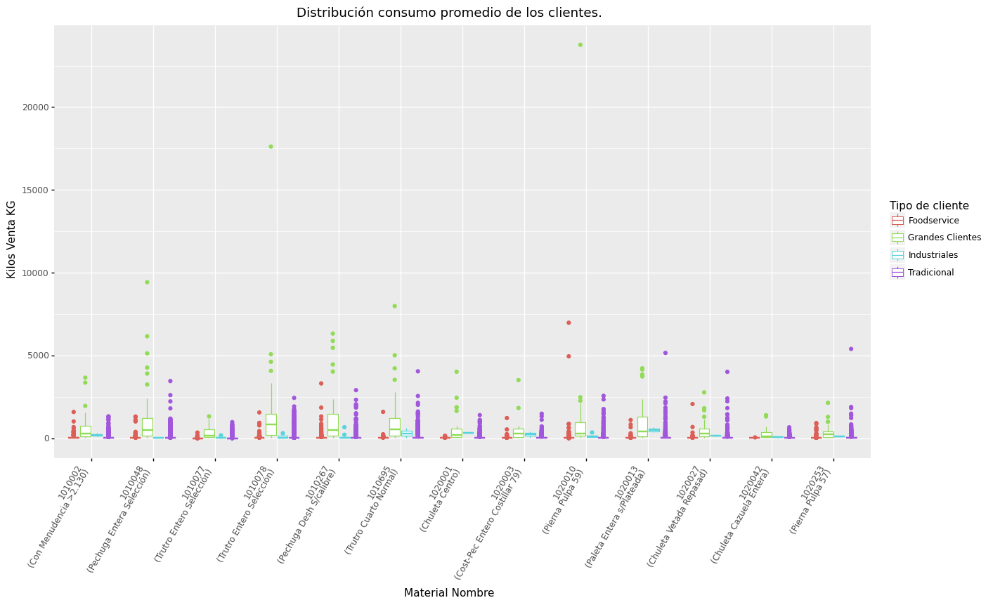

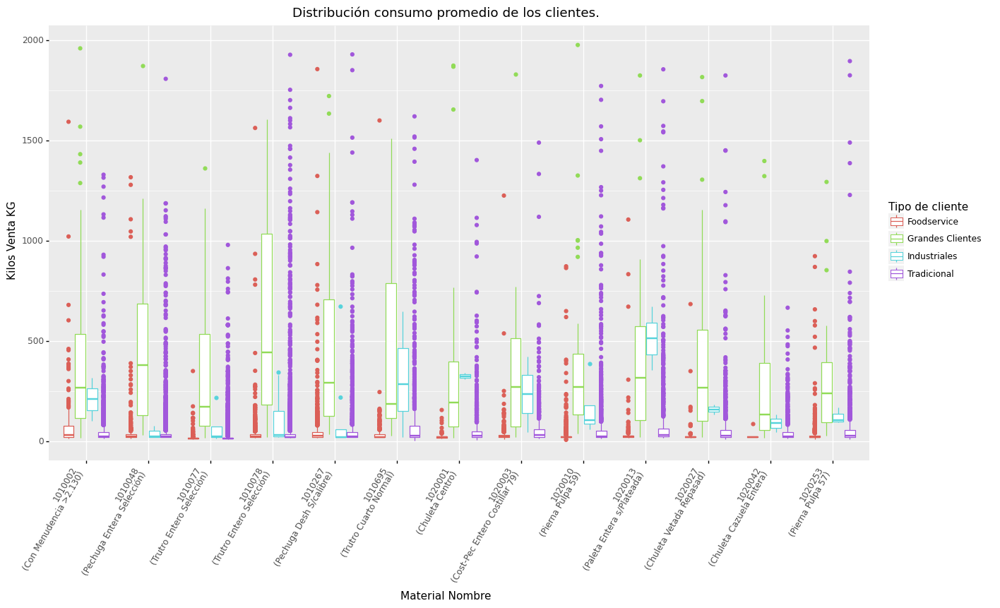

[<ggplot: (189758298013)>, <ggplot: (189810493781)>]

In [74]:

gglist_Box_KG

Se vizualiza que existen clientes,q ue cumplen los requisitos y se comportan como mayoristas en el proemdio de sus facturaciones. Esto representa que de los pedidos que realizan sosilican gran volumne de un mismo producto. 

El ultimo grafico nos muestra como los clientes del canal \textit{Grandes Clientes} compran en volumnes mayores a los otros clientes. Pese a que son clientes de volumen y periocidad mayor, este canal es menos influeyente en lo que respecta a volumen en contraste al canal Tradicional.


El comportamiento de compra promedio de los clientes del canal Tradicional, se explica por el tipo de infraestructura y clientes que son, frecuentemente personas que posee un almacen de barrio u inclusive personas naturales que revenden los productos carnicos.

###### PDF

In [75]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(
        gglist_Box_KG
                  ,file_direct_Graphic+'/Generales/Boxplot'+"/Boxplot mean Client prodc.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales/Boxplot/Boxplot mean Client prodc.pdf


Time Lapsed = 0:0:8.06862211227417 
 H:m:s


###### Precio 

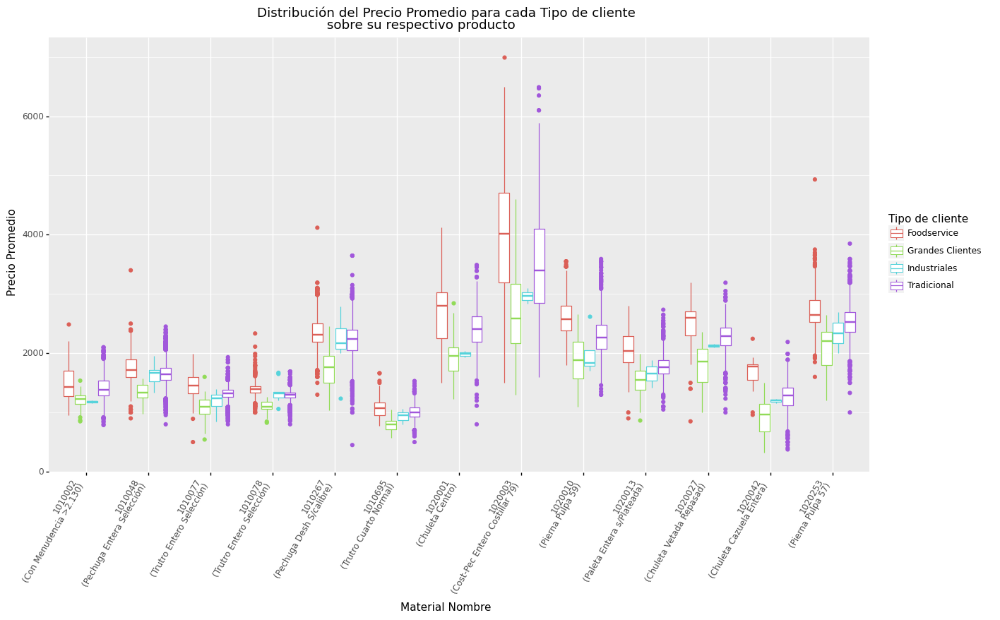

<ggplot: (189752314736)>

In [46]:
X_G='Material Nombre'
y_G='Precio Promedio'
Color_G='Tipo de cliente'
(ggplot(
    df_group_kg
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto\
             ')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)


###### Canal / Año

In [53]:
df_group_kg=df[['Cliente','Material Nombre','Tipo de cliente',  'Kilos Venta KG','Año' ,'Precio Promedio'
  ]].groupby(['Año','Tipo de cliente', 'Material Nombre','Cliente']).mean().reset_index()
df_group_kg.Año=df_group_kg.Año.astype('category')
df_group_kg.head()

,Año,Tipo de cliente,Material Nombre,Cliente,Kilos Venta KG,Precio Promedio
0,2018,Foodservice,1010002\n (Con Menudencia >2.130),12122226,19.000000,1200.000000
1,2018,Foodservice,1010002\n (Con Menudencia >2.130),14165940,24.571429,1357.142857
2,2018,Foodservice,1010002\n (Con Menudencia >2.130),14450952,16.000000,1200.000000
3,2018,Foodservice,1010002\n (Con Menudencia >2.130),14625675,78.636364,1222.727273
4,2018,Foodservice,1010002\n (Con Menudencia >2.130),14629688,22.457143,1238.571429


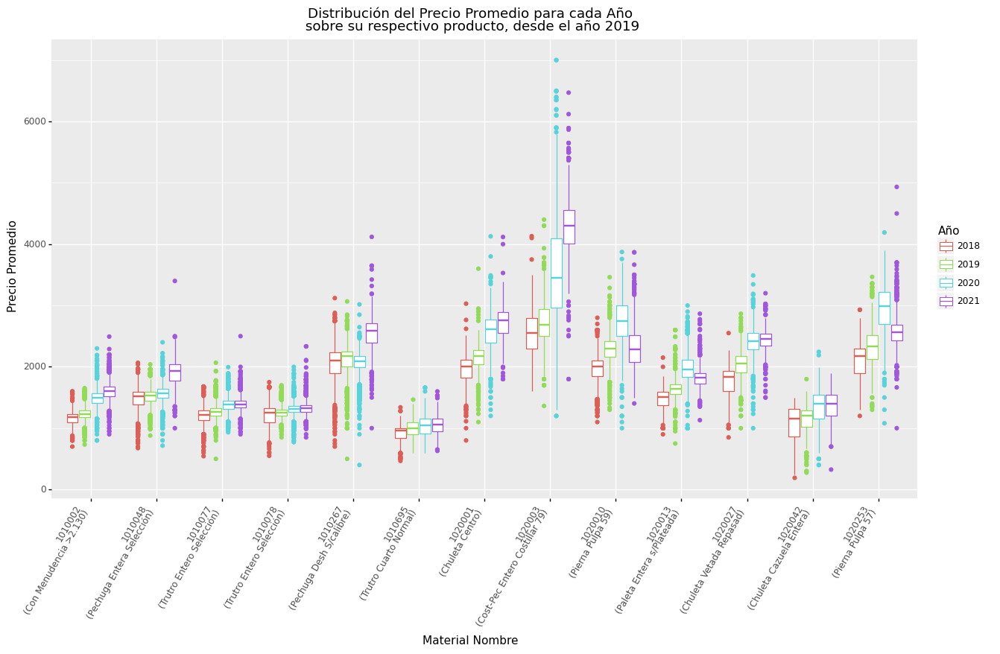

<ggplot: (189716652370)>

In [54]:
X_G='Material Nombre'
y_G='Kilos Venta KG'
y_G='Precio Promedio'
Color_G='Año'#'Tipo de cliente'
(ggplot(
    df_group_kg
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto, desde el año 2019')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)


Se visualiza que dentro de los clientes, existen algunos que emiten en proemdio, facuras por grandes volumnes de venta

### Box plot Precio Promedio de las transacciónes
Actualmente se tiene el precio de todas las transacciones, como segundo grafico.

Este se reeemplazará por un grafico que represente el precio promedio que paga cada cliente por un producto determinado.

Titulo: precio promedio del cliente.



##### Data

In [17]:
#'Material Nombre'
DF_Full.columns

Index(['Zona de ventas', 'Zona de ventas.1', 'Cliente', 'Cliente.1',
       'Cliente - Local', 'Cliente - Local.1', 'Material', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio',
       'Frecuencia Historica', 'Centro', 'Centro.1', 'Población',
       'Tipo de cliente', 'Cluster', 'Segmento', 'Segmento.1',
       'Categoría Cliente', 'Zona de reparto', 'Año Creación',
       'Material Favorito', 'Semana', 'Mes', 'Año', 'Nivel 4', 'Nivel 4.1',
       'Sector', 'Tipo de material', 'Tipo de material.1', 'Marca', 'Nivel 2',
       'Granel/Envasado', 'Marinado', 'Nivel 3', 'Grupo artículos', 'Estado',
       'Estandar', 'Envase', 'Material Nombre'],
      dtype='object')

In [18]:
df=DF_Full.copy()

##### Grafica Precio, Canal Producto

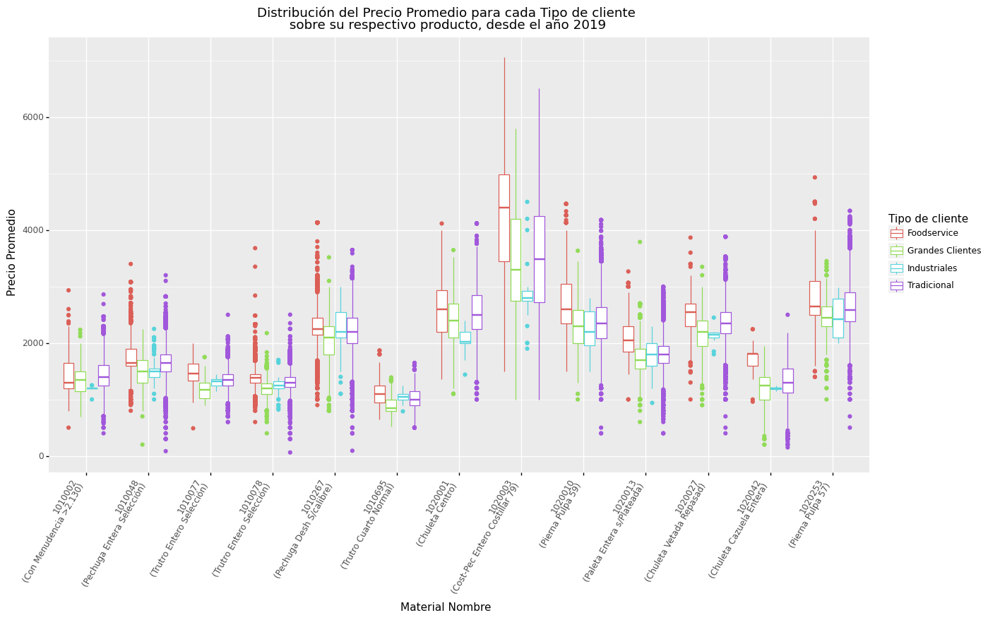

[<ggplot: (180276266999)>]

In [19]:
Box_plot=[]
X_G='Material Nombre'
y_G='Precio Promedio'
Color_G='Tipo de cliente'
Box_plot.append(ggplot(
    df[
        (df.Año>=2019)&(df[y_G]<10**4)
    ]
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto, desde el año 2019')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)
Box_plot

##### Grafica Precio, Por Año

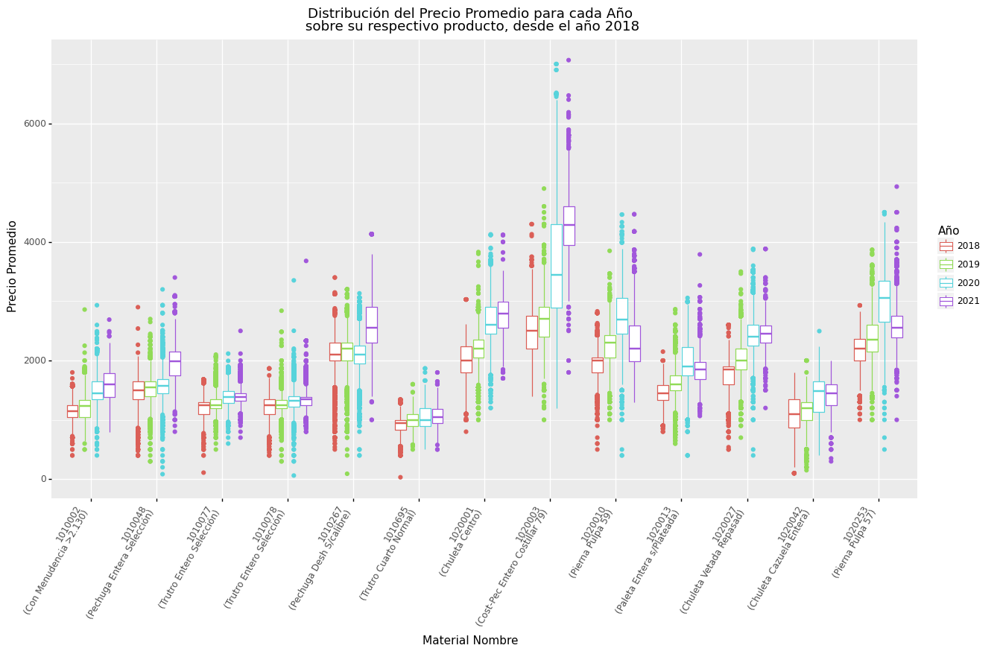

<ggplot: (180262274527)>

In [20]:
X_G='Material Nombre'
y_G='Precio Promedio'
Color_G='Año'
df_A=df.copy()
df_A.Año=df_A.Año.astype('category')
Box_plot.append(ggplot(
    df_A[(df_A[y_G]<10**4)]
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto, desde el año 2018')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)
Box_plot[1]

##### Grafica General 

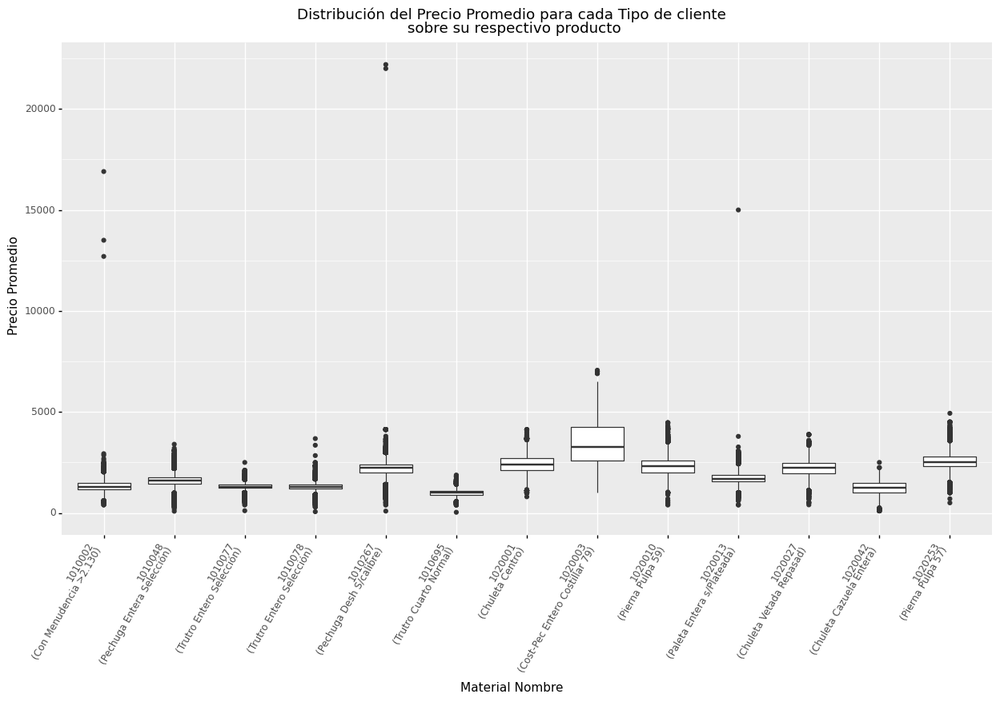

<ggplot: (180270721931)>

In [21]:
X_G='Material Nombre'
y_G='Precio Promedio'
Color_G='Tipo de cliente'
(ggplot(df
        ,aes(
            x=X_G,
            y= y_G ,))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

    +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))

)

##### Precio  promedio del cliente.

###### data
Realiza un grouoby, cliente, producto, tipon de cliente

Se descarta el año para no tener un analisis erroneo

In [29]:
#[df.Año>2020]\
df_group_kg=df[df.Año>2019]\
.groupby(['Tipo de cliente', 'Material Nombre','Cliente']
                      ).mean().reset_index()\
[['Cliente','Material Nombre','Tipo de cliente',
  'Kilos Venta KG' ,'Precio Promedio'
  ]]
df_group_kg.head()

,Cliente,Material Nombre,Tipo de cliente,Kilos Venta KG,Precio Promedio
0,10031085,1010002\n (Con Menudencia >2.130),Foodservice,18.0,1300.0
1,10083379,1010002\n (Con Menudencia >2.130),Foodservice,175.0,1325.0
2,10127654,1010002\n (Con Menudencia >2.130),Foodservice,97.0,1575.0
3,10510981,1010002\n (Con Menudencia >2.130),Foodservice,18.0,1800.0
4,10571591,1010002\n (Con Menudencia >2.130),Foodservice,144.0,1950.0


###### Precio 

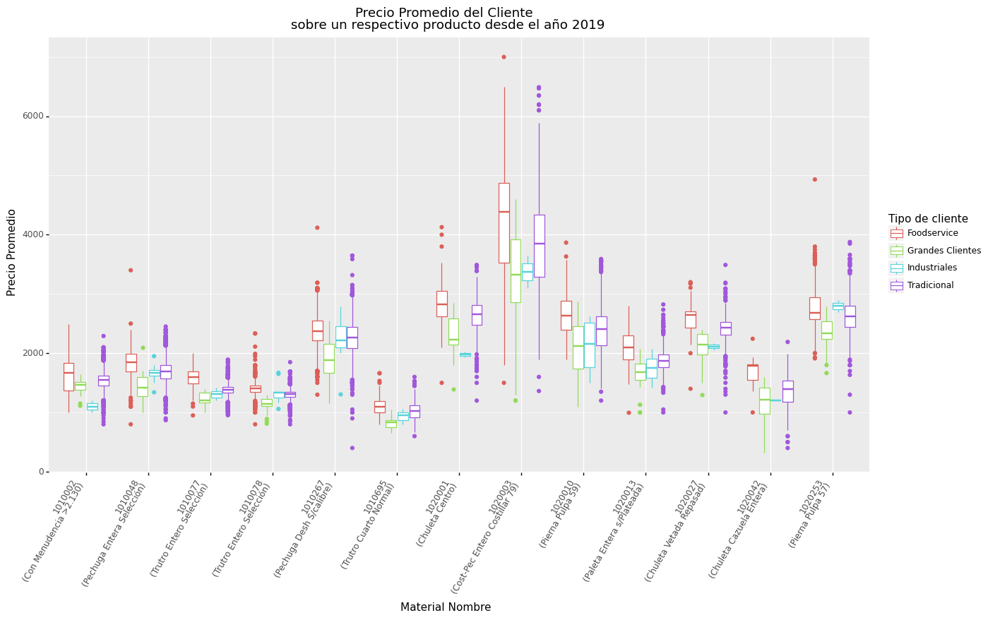

[<ggplot: (180271820810)>]

In [36]:
X_G='Material Nombre'
y_G='Precio Promedio'
Color_G='Tipo de cliente'

Prom_G=[(ggplot(
    df_group_kg
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

+ggtitle(y_G+' del Cliente \n sobre un respectivo producto desde el año 2019')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)]

Prom_G

#### PDF

In [37]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(
        Box_plot+Prom_G
                  ,file_direct_Graphic+'/Generales/'+"/Boxplot_Precio.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Boxplot_Precio.pdf


Time Lapsed = 0:0:23.689189672470093 
 H:m:s


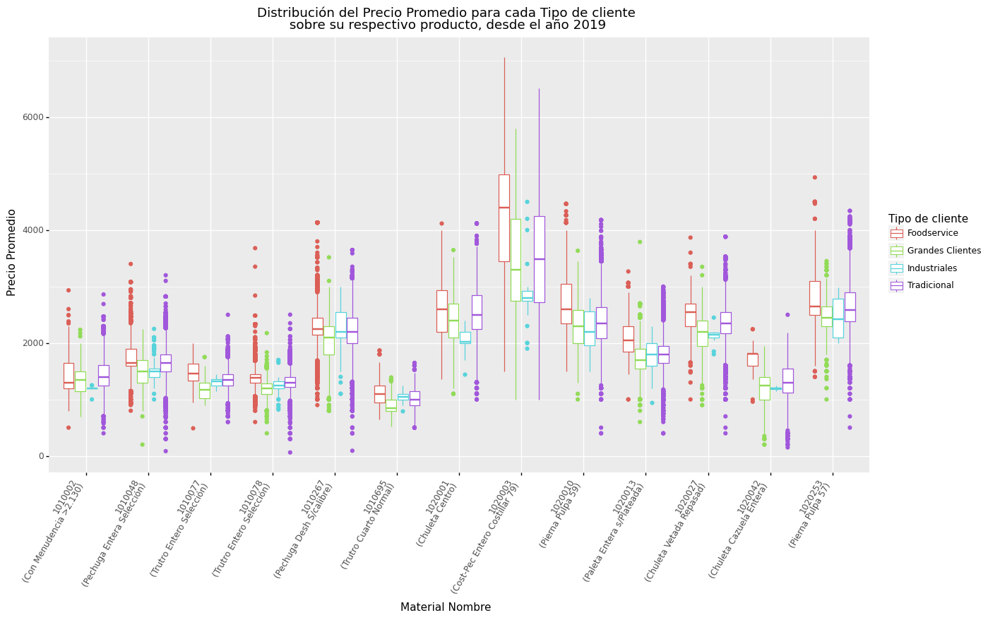

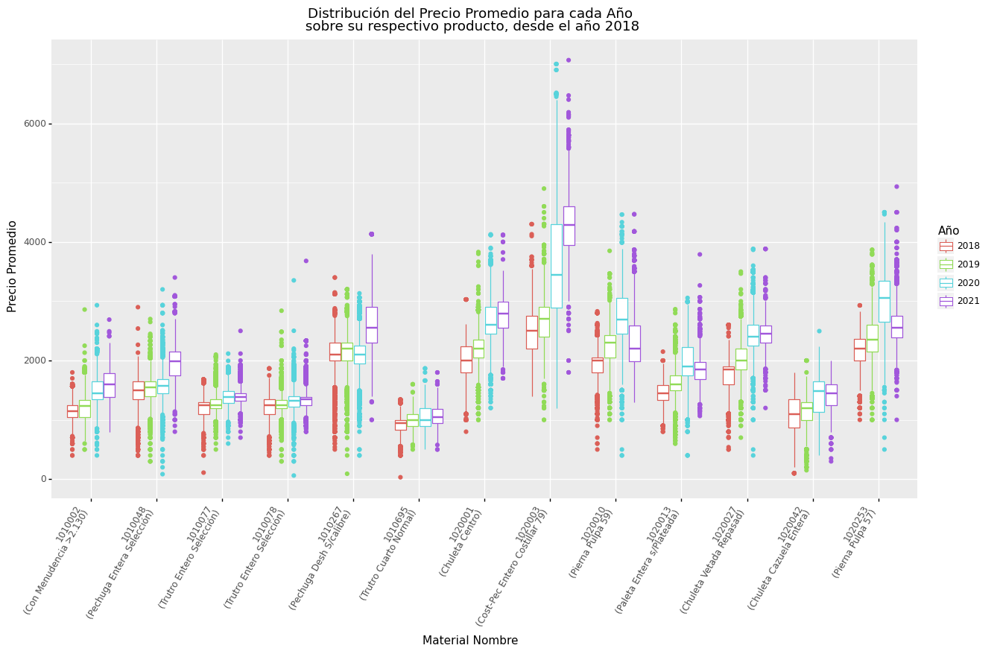

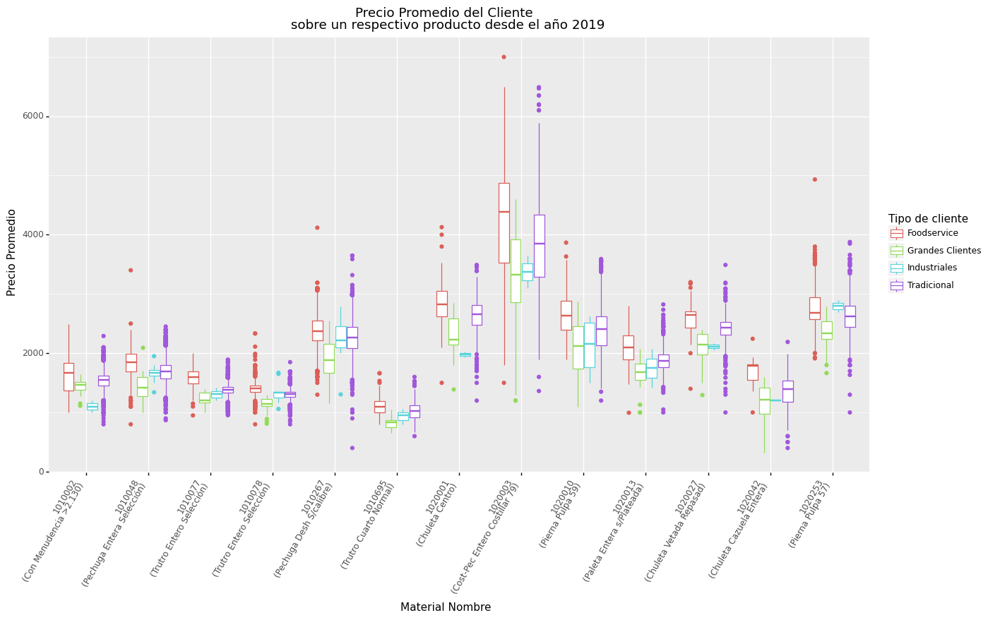

[<ggplot: (180276266999)>, <ggplot: (180262274527)>, <ggplot: (180271820810)>]

In [38]:
Box_plot+Prom_G

### Box plot Kilogramo de venta  de las transacciónes

#### Graficos 

##### Data

In [13]:
#'Material Nombre'
DF_Full.columns

Index(['Zona de ventas', 'Zona de ventas.1', 'Cliente', 'Cliente.1',
       'Cliente - Local', 'Cliente - Local.1', 'Material', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio',
       'Frecuencia Historica', 'Centro', 'Centro.1', 'Población',
       'Tipo de cliente', 'Cluster', 'Segmento', 'Segmento.1',
       'Categoría Cliente', 'Zona de reparto', 'Año Creación',
       'Material Favorito', 'Semana', 'Mes', 'Año', 'Nivel 4', 'Nivel 4.1',
       'Sector', 'Tipo de material', 'Tipo de material.1', 'Marca', 'Nivel 2',
       'Granel/Envasado', 'Marinado', 'Nivel 3', 'Grupo artículos', 'Estado',
       'Estandar', 'Envase', 'Material Nombre'],
      dtype='object')

In [14]:
df=DF_Full.copy()

##### Grafica KG, Canal Producto

In [15]:
df.columns

Index(['Zona de ventas', 'Zona de ventas.1', 'Cliente', 'Cliente.1',
       'Cliente - Local', 'Cliente - Local.1', 'Material', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio',
       'Frecuencia Historica', 'Centro', 'Centro.1', 'Población',
       'Tipo de cliente', 'Cluster', 'Segmento', 'Segmento.1',
       'Categoría Cliente', 'Zona de reparto', 'Año Creación',
       'Material Favorito', 'Semana', 'Mes', 'Año', 'Nivel 4', 'Nivel 4.1',
       'Sector', 'Tipo de material', 'Tipo de material.1', 'Marca', 'Nivel 2',
       'Granel/Envasado', 'Marinado', 'Nivel 3', 'Grupo artículos', 'Estado',
       'Estandar', 'Envase', 'Material Nombre'],
      dtype='object')

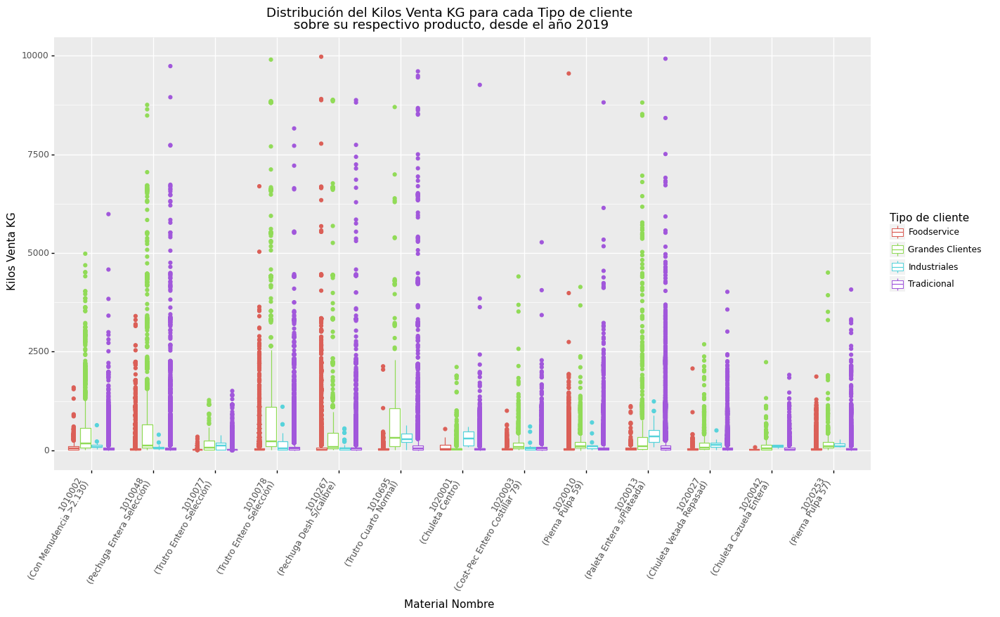

[<ggplot: (189753609725)>]

In [16]:
Box_plot_Venta=[]
X_G='Material Nombre'
y_G='Kilos Venta KG'
Color_G='Tipo de cliente'
Box_plot_Venta.append(ggplot(
    df[
        (df.Año>=2019)&(df[y_G]<10**4)
    ]
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto, desde el año 2019')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)
Box_plot_Venta

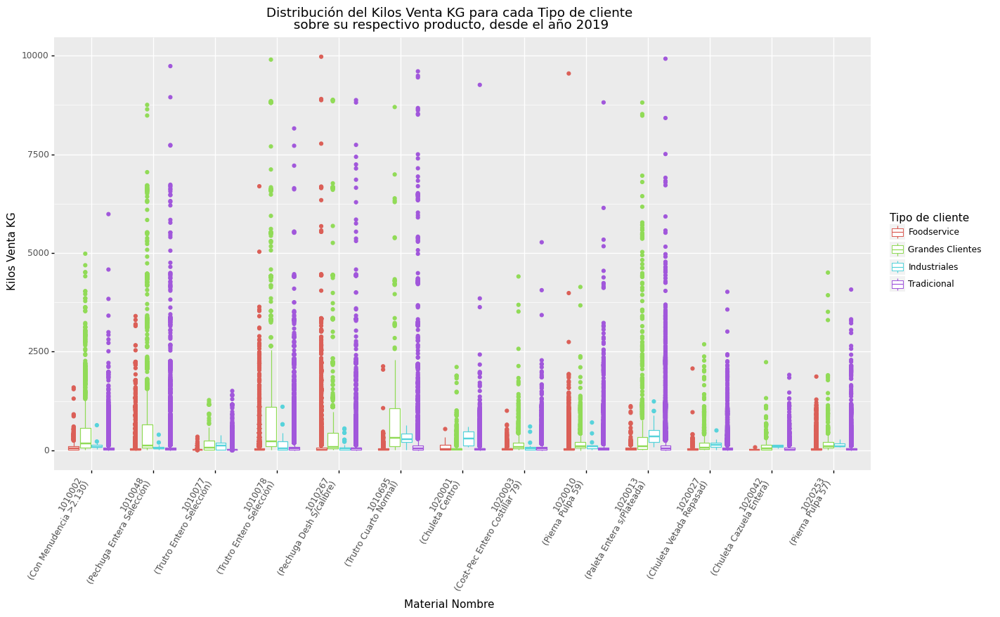

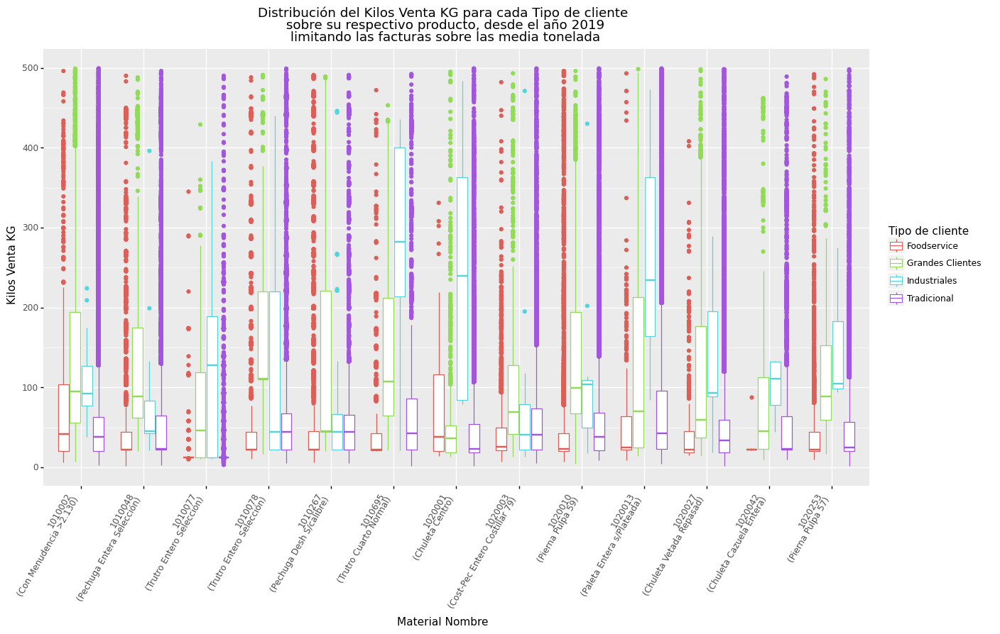

[<ggplot: (189753609725)>, <ggplot: (189717218774)>]

In [17]:
#Box_plot_Venta=[]
X_G='Material Nombre'
y_G='Kilos Venta KG'
Color_G='Tipo de cliente'
Box_plot_Venta.append(ggplot(
    df[
        (df.Año>=2019)&(df[y_G]<0.5*10**3)
    ]
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto, desde el año 2019'
              +'\n limitando las facturas sobre las media tonelada'
             )
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)
Box_plot_Venta

##### Grafica Precio, Por Año

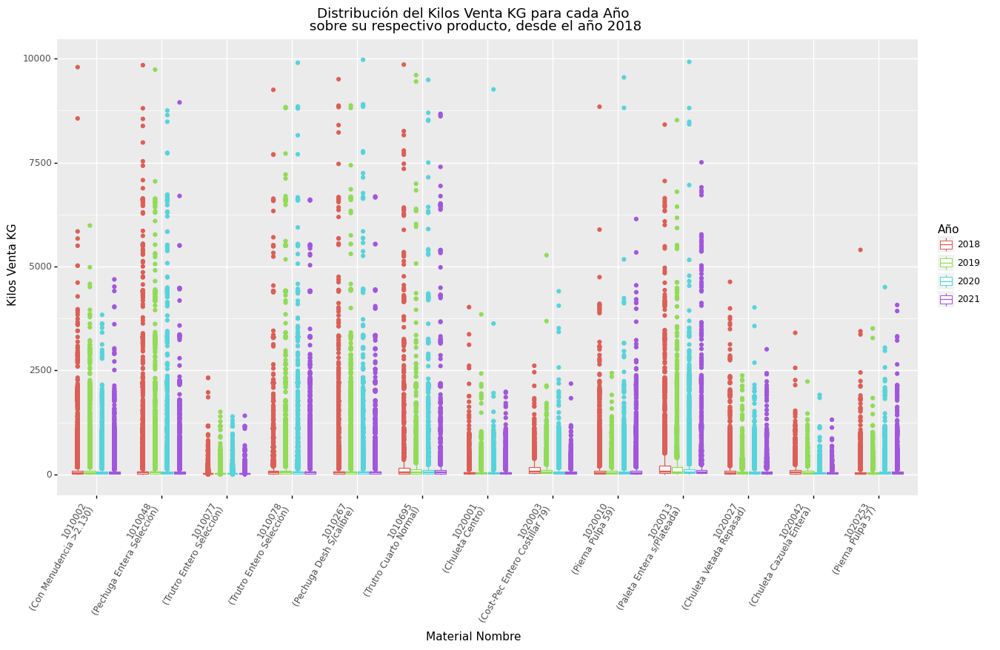

<ggplot: (189707392196)>

In [18]:
X_G='Material Nombre'
y_G='Kilos Venta KG'
Color_G='Año'
df_A=df.copy()
df_A.Año=df_A.Año.astype('category')
Box_plot_Venta.append(ggplot(
    df_A[(df_A[y_G]<10**4)]
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto, desde el año 2018')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)
Box_plot_Venta[2]

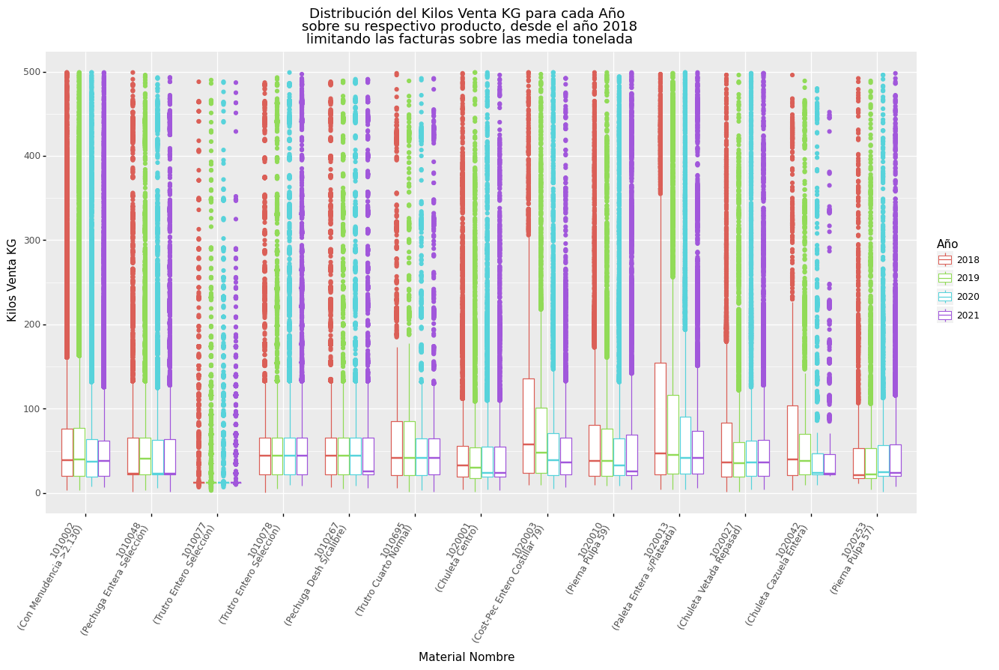

<ggplot: (189747532445)>

In [19]:
X_G='Material Nombre'
y_G='Kilos Venta KG'
Color_G='Año'
df_A=df.copy()
df_A.Año=df_A.Año.astype('category')
Box_plot_Venta.append(ggplot(
    df_A[(df_A[y_G]<(0.5*10**3))]
        ,aes(
            x=X_G,
            y= y_G ,
            color=Color_G ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto, desde el año 2018'
             +'\n limitando las facturas sobre las media tonelada'
             )
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))
)
Box_plot_Venta[3]

##### Grafica General 

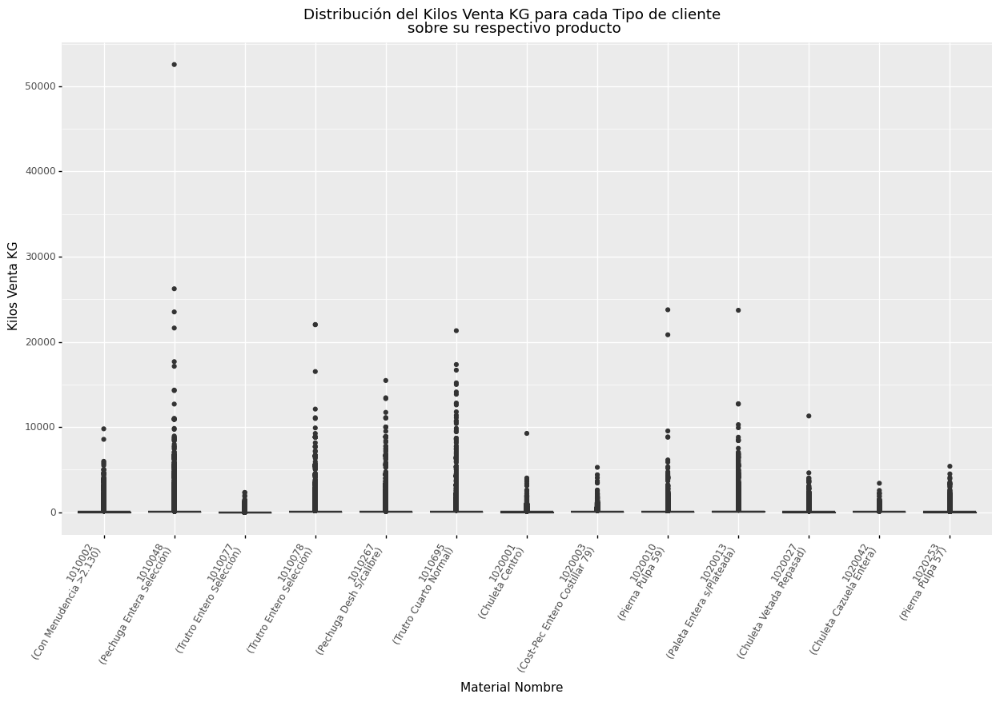

<ggplot: (189762034002)>

In [20]:
X_G='Material Nombre'
y_G='Kilos Venta KG'
Color_G='Tipo de cliente'
(ggplot(df
        ,aes(
            x=X_G,
            y= y_G ,))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

    +ggtitle('Distribución del '+y_G+' para cada '+Color_G+'\n sobre su respectivo producto')
    +theme(axis_text_x = element_text(angle=60, hjust=1),figure_size=(15,8))

)

#### PDF

In [26]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(
        Box_plot_Venta
                  ,file_direct_Graphic+'/Generales/'+"/Boxplot Kilogramo de Venta.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Boxplot Kilogramo de Venta.pdf


Time Lapsed = 0:1:15.94555950164795 
 H:m:s


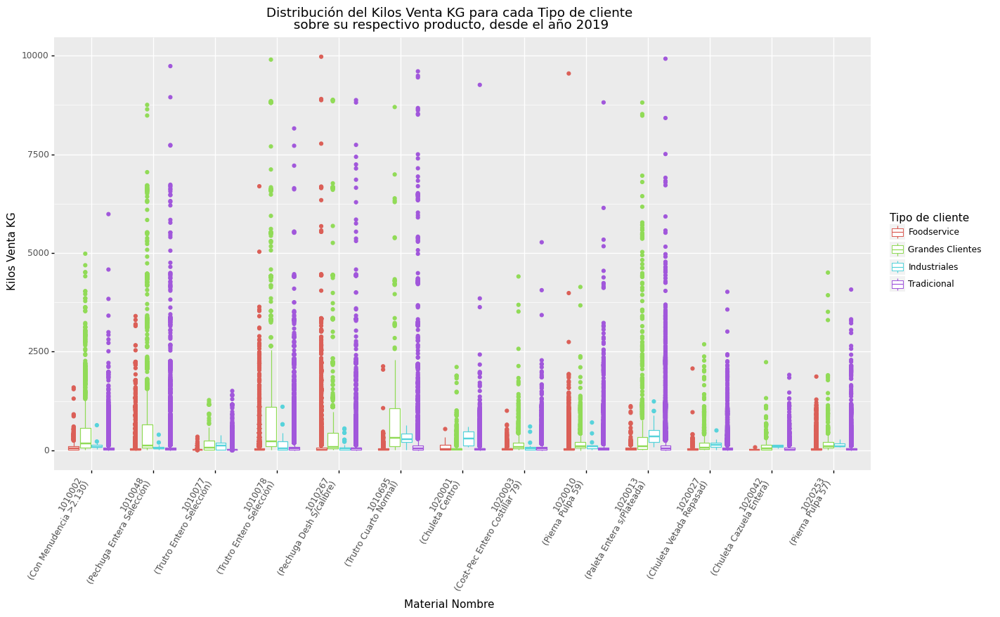

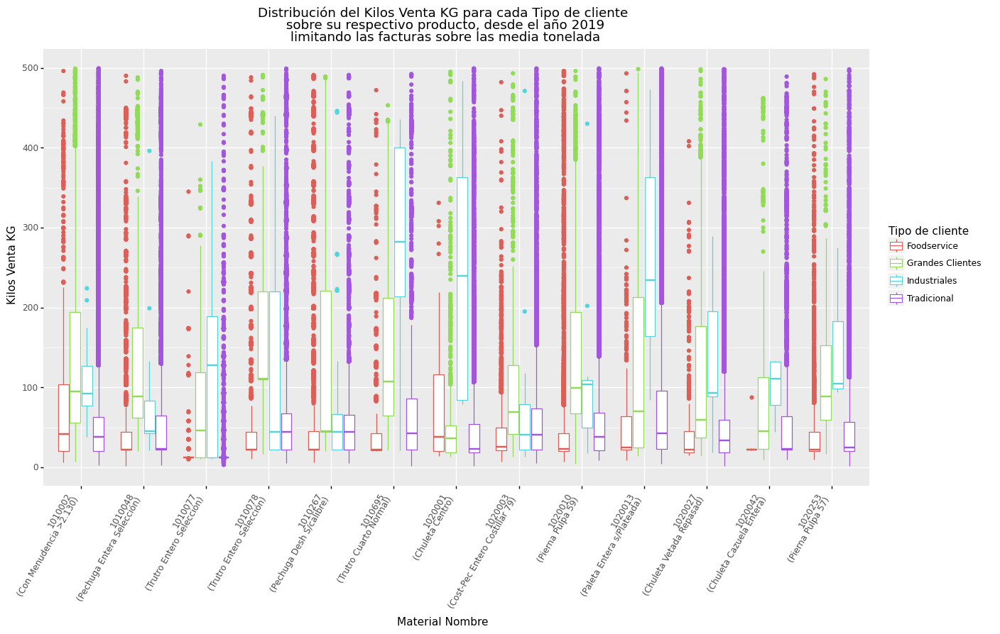

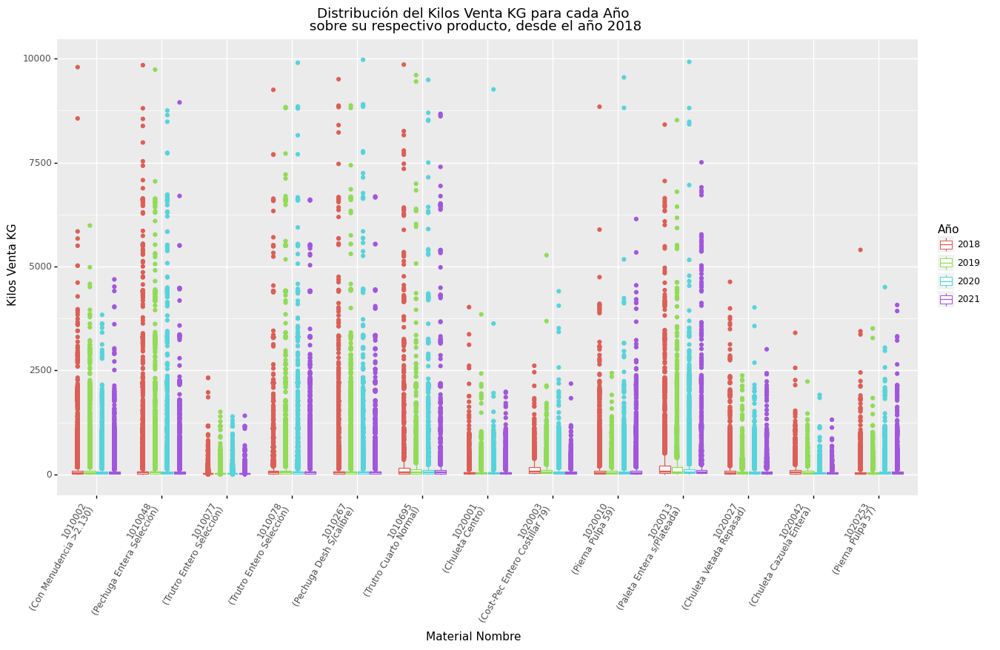

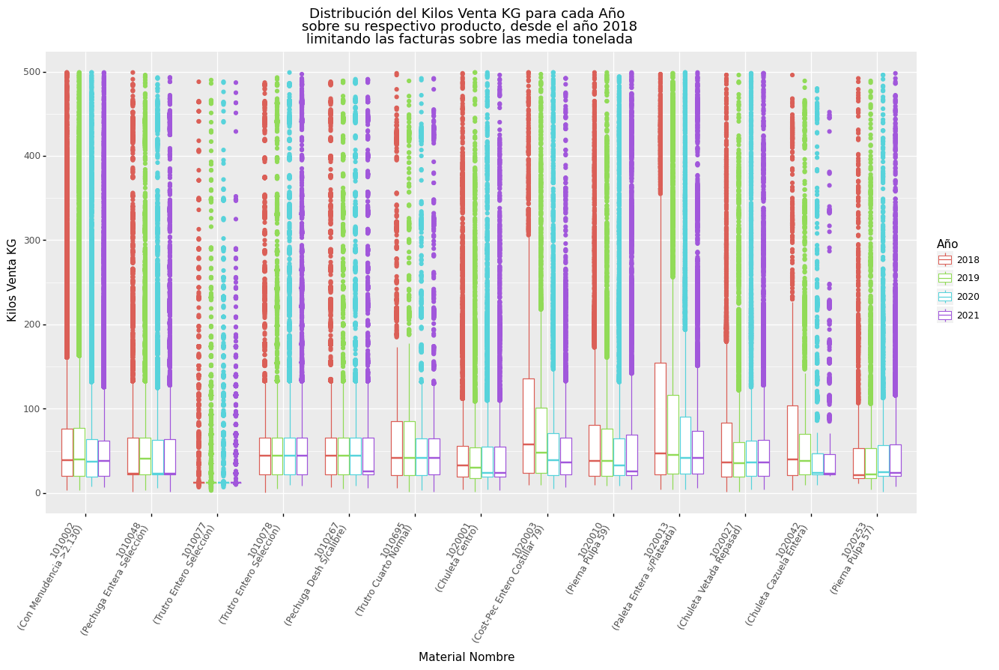

[<ggplot: (189753609725)>,
 <ggplot: (189717218774)>,
 <ggplot: (189707392196)>,
 <ggplot: (189747532445)>]

In [27]:
Box_plot_Venta

## Variacion precio tiempo

Se evaluará graficamente cada producto esta temporalidad


### Datos

In [28]:
DF_Full.columns

Index(['Zona de ventas', 'Zona de ventas.1', 'Cliente', 'Cliente.1',
       'Cliente - Local', 'Cliente - Local.1', 'Material', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio',
       'Frecuencia Historica', 'Centro', 'Centro.1', 'Población',
       'Tipo de cliente', 'Cluster', 'Segmento', 'Segmento.1',
       'Categoría Cliente', 'Zona de reparto', 'Año Creación',
       'Material Favorito', 'Semana', 'Mes', 'Año', 'Nivel 4', 'Nivel 4.1',
       'Sector', 'Tipo de material', 'Tipo de material.1', 'Marca', 'Nivel 2',
       'Granel/Envasado', 'Marinado', 'Nivel 3', 'Grupo artículos', 'Estado',
       'Estandar', 'Envase', 'Material Nombre'],
      dtype='object')

#### Dia

In [29]:
#==========================
# data con los valores promedio de las ventas
#(promedio por compra)
#==========================
#[DF_Full['Tipo de cliente']==Tipo_de_Cliente]
data_fecha_medio=DF_Full.groupby(['Tipo de cliente','Material','Nivel 4.1','Día natural']).mean().reset_index()
data_fecha_medio.head()

,Tipo de cliente,Material,Nivel 4.1,Día natural,Kilos Venta KG,Venta Neta,Precio Promedio,Semana,Mes,Año
0,Foodservice,1010002,Con Menudencia >2.130,2018-01-02,101.000000,135252.000000,1293.333333,1,1,2018
1,Foodservice,1010002,Con Menudencia >2.130,2018-01-04,100.666667,133888.222222,1280.444444,1,1,2018
2,Foodservice,1010002,Con Menudencia >2.130,2018-01-05,100.250000,120601.500000,1198.500000,1,1,2018
3,Foodservice,1010002,Con Menudencia >2.130,2018-01-06,20.000000,30225.000000,1550.000000,1,1,2018
4,Foodservice,1010002,Con Menudencia >2.130,2018-01-08,39.500000,50220.000000,1375.000000,2,1,2018


In [30]:
#==========================
# data con los valores promedio de las ventas
#(promedio por volumen)
#==========================
#[DF_Full['Tipo de cliente']==Tipo_de_Cliente]

data_fecha_medio=DF_Full.groupby(['Tipo de cliente','Material','Nivel 4.1','Día natural']).sum().reset_index()
data_fecha_medio['Precio Promedio']=data_fecha_medio['Venta Neta']/data_fecha_medio['Kilos Venta KG']

data_fecha_medio['Semana']=data_fecha_medio["Día natural"].apply(lambda x: x.isocalendar()[1] )
data_fecha_medio['Mes']=data_fecha_medio["Día natural"].apply(lambda x: x.month)
data_fecha_medio['Año']=data_fecha_medio["Día natural"].apply(lambda x: x.year)


data_fecha_medio.head()

,Tipo de cliente,Material,Nivel 4.1,Día natural,Kilos Venta KG,Venta Neta,Precio Promedio,Semana,Mes,Año
0,Foodservice,1010002,Con Menudencia >2.130,2018-01-02,303.0,405756.0,1339.128713,1,1,2018
1,Foodservice,1010002,Con Menudencia >2.130,2018-01-04,906.0,1204994.0,1330.015453,1,1,2018
2,Foodservice,1010002,Con Menudencia >2.130,2018-01-05,401.0,482406.0,1203.007481,1,1,2018
3,Foodservice,1010002,Con Menudencia >2.130,2018-01-06,20.0,30225.0,1511.250000,1,1,2018
4,Foodservice,1010002,Con Menudencia >2.130,2018-01-08,79.0,100440.0,1271.392405,2,1,2018


In [31]:
#==========================
# df para un producto en especifico
#
#==========================
df=data_fecha_medio.copy()#[data_fecha_medio['Material']== Y_producto].copy()#[Data['Precio Unitario CLP / KG']<5000]

df['Semana']=df['Semana'].astype('category')
df['Año']=df['Año'].astype('category')
df.Mes=df.Mes.astype('int64')

In [32]:
#=====================
# funcion dia a numero
#=====================
def D_num(x):
    return(x-datetime.date(x.year, 1, 1)).days+1
df['Día numero']=df['Día natural'].apply(D_num)
df.head()

,Tipo de cliente,Material,Nivel 4.1,Día natural,Kilos Venta KG,Venta Neta,Precio Promedio,Semana,Mes,Año,Día numero
0,Foodservice,1010002,Con Menudencia >2.130,2018-01-02,303.0,405756.0,1339.128713,1,1,2018,2
1,Foodservice,1010002,Con Menudencia >2.130,2018-01-04,906.0,1204994.0,1330.015453,1,1,2018,4
2,Foodservice,1010002,Con Menudencia >2.130,2018-01-05,401.0,482406.0,1203.007481,1,1,2018,5
3,Foodservice,1010002,Con Menudencia >2.130,2018-01-06,20.0,30225.0,1511.250000,1,1,2018,6
4,Foodservice,1010002,Con Menudencia >2.130,2018-01-08,79.0,100440.0,1271.392405,2,1,2018,8


In [33]:
#=====================
# Estandariza los dias de los años anteriores al año 2021
#=====================

def D_dia(x):
    return(datetime.date(2021, 1, 1)+datetime.timedelta(days=x-1))
df['Día año']=df['Día numero'].apply(D_dia)
df.head()

,Tipo de cliente,Material,Nivel 4.1,Día natural,Kilos Venta KG,Venta Neta,Precio Promedio,Semana,Mes,Año,Día numero,Día año
0,Foodservice,1010002,Con Menudencia >2.130,2018-01-02,303.0,405756.0,1339.128713,1,1,2018,2,2021-01-02
1,Foodservice,1010002,Con Menudencia >2.130,2018-01-04,906.0,1204994.0,1330.015453,1,1,2018,4,2021-01-04
2,Foodservice,1010002,Con Menudencia >2.130,2018-01-05,401.0,482406.0,1203.007481,1,1,2018,5,2021-01-05
3,Foodservice,1010002,Con Menudencia >2.130,2018-01-06,20.0,30225.0,1511.250000,1,1,2018,6,2021-01-06
4,Foodservice,1010002,Con Menudencia >2.130,2018-01-08,79.0,100440.0,1271.392405,2,1,2018,8,2021-01-08


### Grafico Lineal

In [34]:
#df[df.Material==i]['Nivel 4.1'].unique()[0]

In [35]:
#=========================================================
# Variacion Material 
#Movimiento del precio promedio del producto(Linealmente)
#=========================================================
Lis_G_lineal=[]
for i in df.Material.unique():
    s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    print(i,s)
    Lis_G_lineal.append(ggplot(df[df.Material==i],aes(x='Día numero',
                     y='Precio Promedio', color = "Año" ))\
    +  geom_line() +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(10,8)) 
                       +ggtitle(' Variacion diaria del precio promedio del '+ i+' ('+s+')' ) +facet_grid('Tipo de cliente~.')
)


1010002 Con Menudencia >2.130
1010048 Pechuga Entera Selección
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010267 Pechuga Desh S/calibre
1010695 Trutro Cuarto Normal
1020001 Chuleta Centro
1020003 Cost-Pec Entero Costillar 79
1020010 Pierna Pulpa 59
1020013 Paleta Entera s/Plateada
1020027 Chuleta Vetada Repasad
1020042 Chuleta Cazuela Entera
1020253 Pierna Pulpa 57


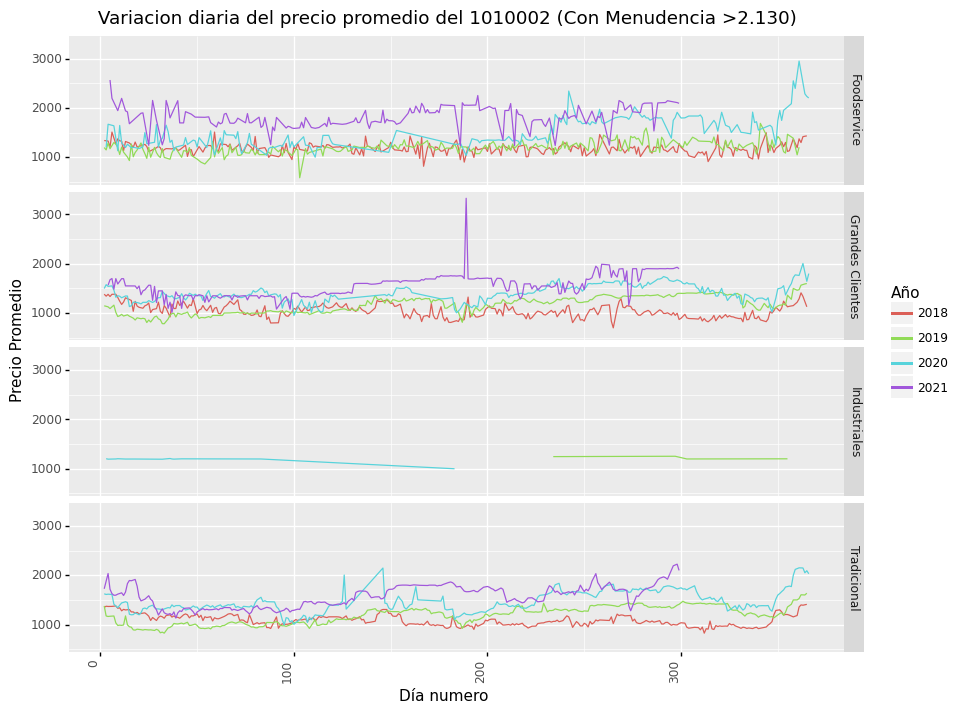

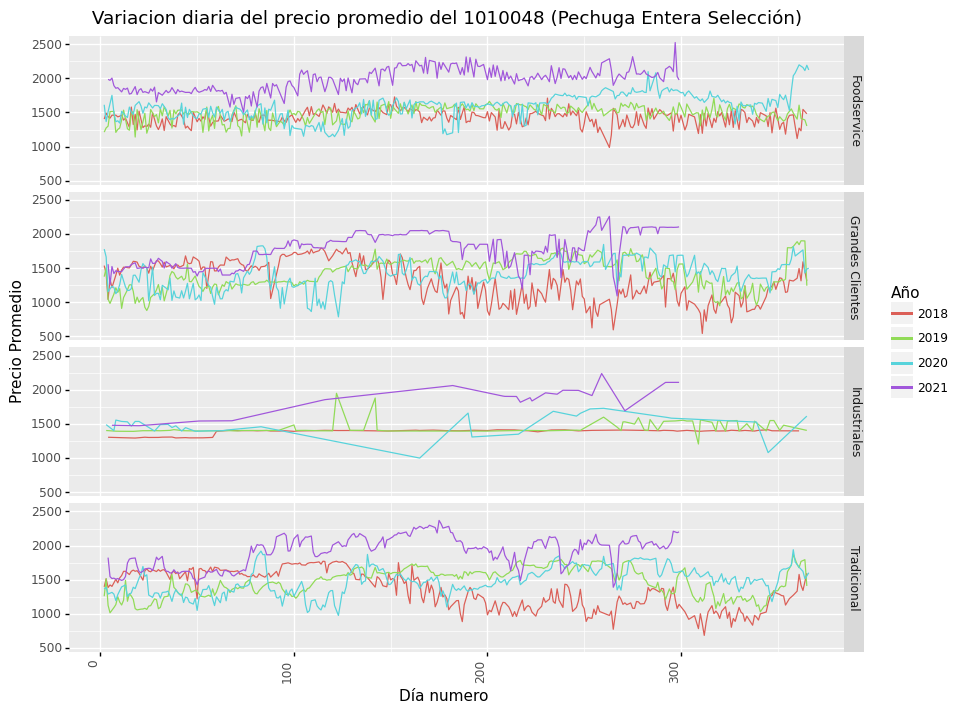

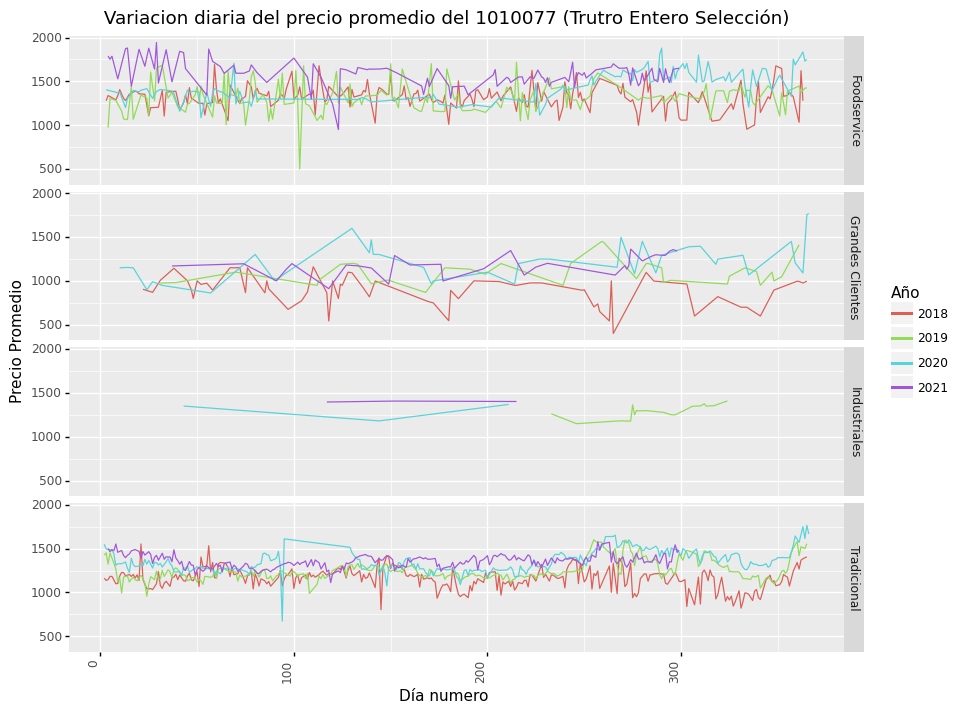

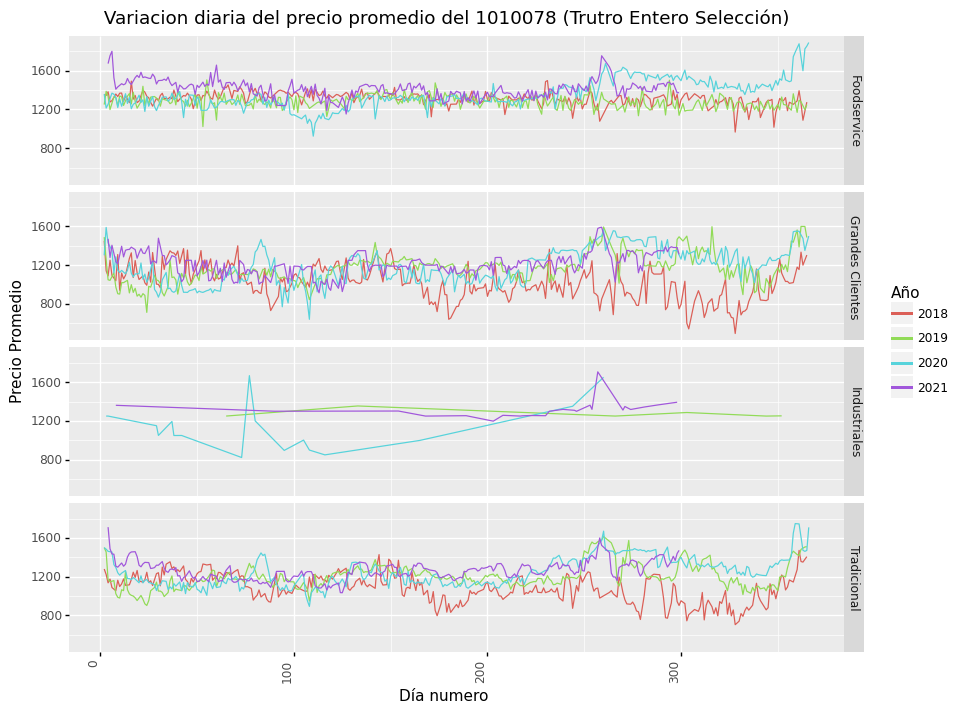

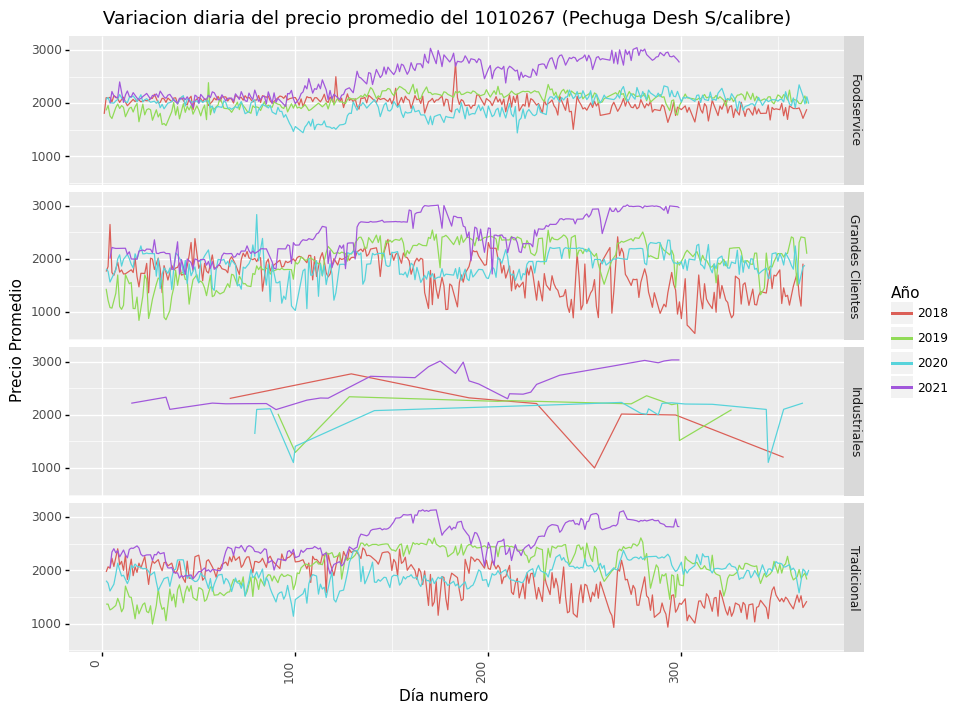

...

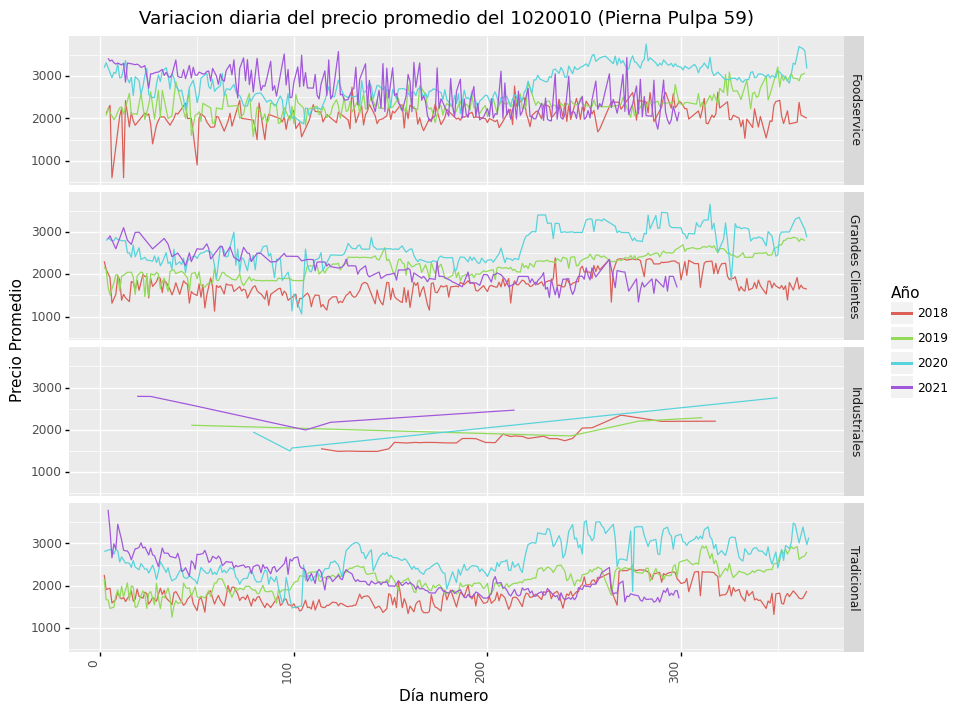

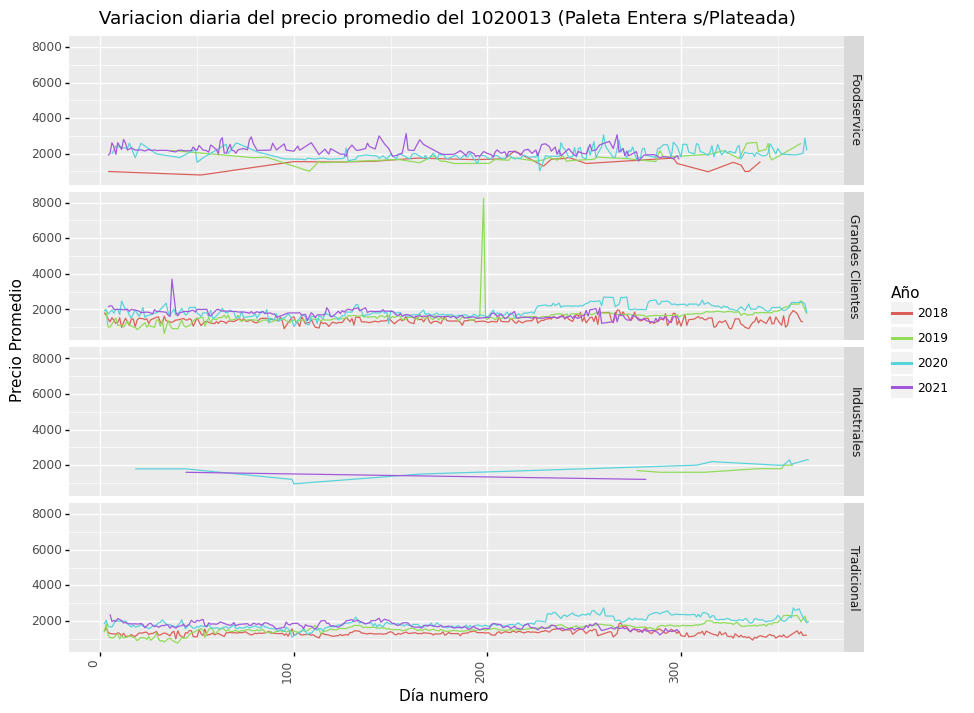

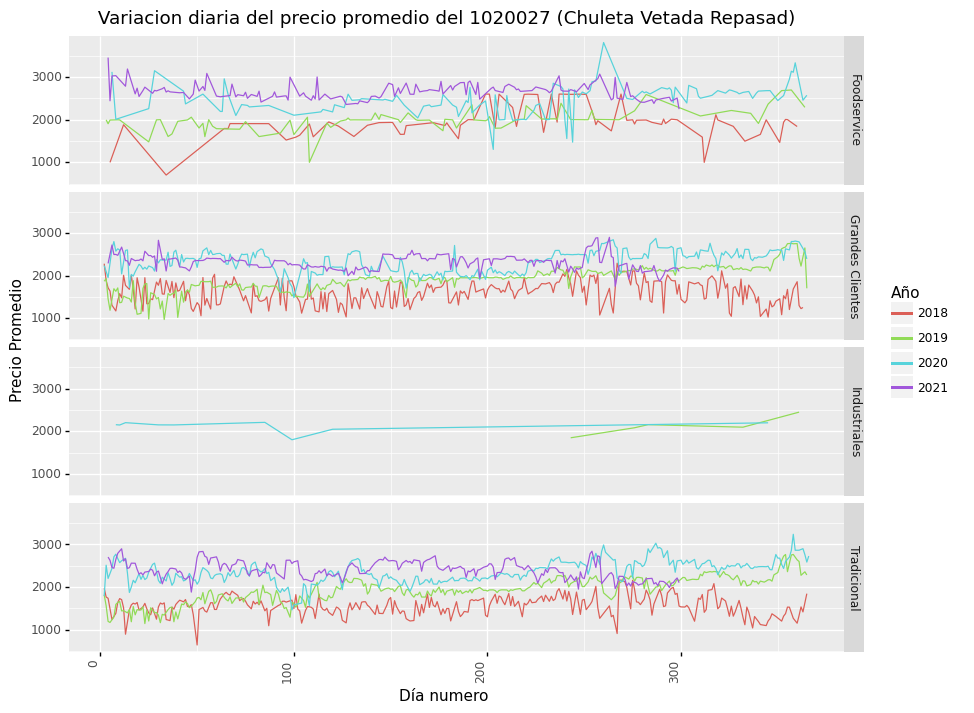

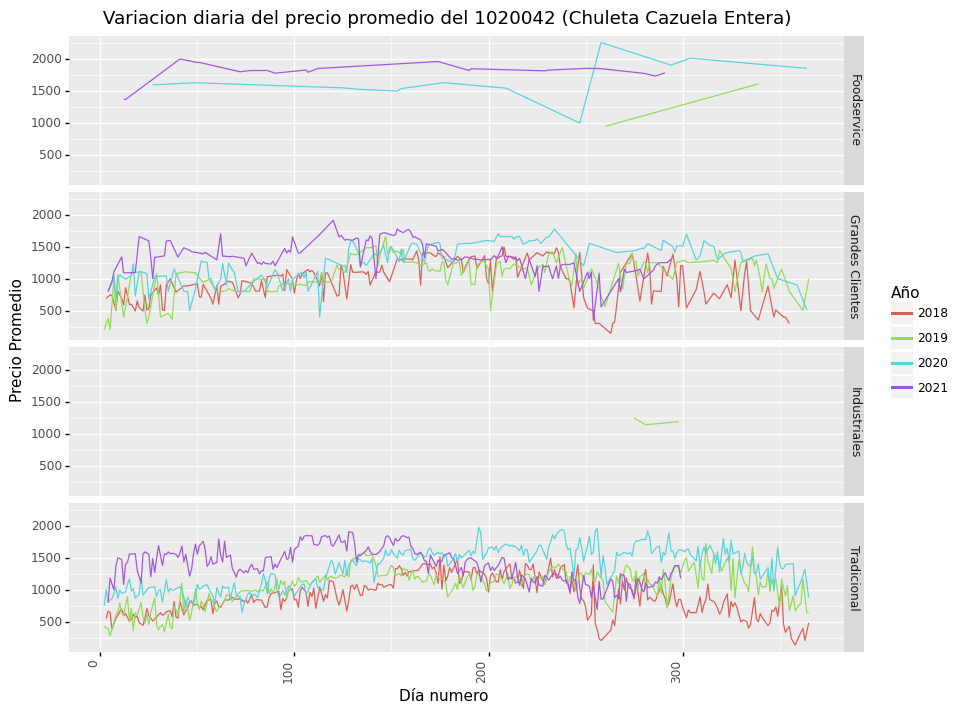

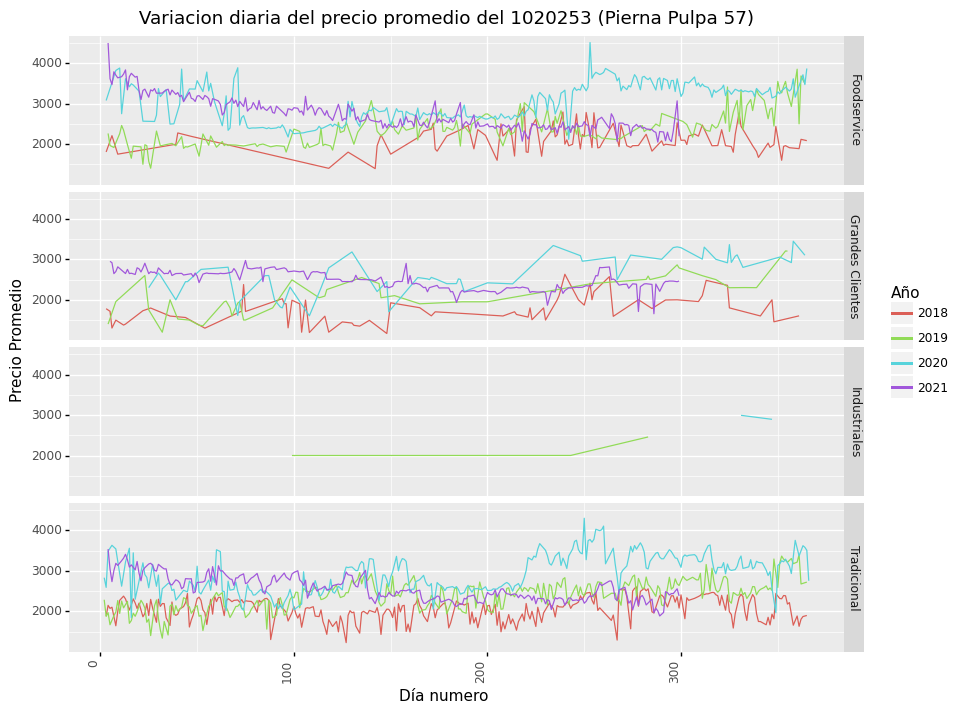

[<ggplot: (88595861402)>,
 <ggplot: (88594689208)>,
 <ggplot: (88594341738)>,
 <ggplot: (88594685778)>,
 <ggplot: (88594658916)>,
 <ggplot: (88594344569)>,
 <ggplot: (88594648206)>,
 <ggplot: (88595922583)>,
 <ggplot: (88594707785)>,
 <ggplot: (88595918312)>,
 <ggplot: (88594451767)>,
 <ggplot: (88594327390)>,
 <ggplot: (88595892026)>]

In [36]:
Lis_G_lineal

In [37]:
#=========================================================
# Variacion Tipo de Cliente 
#Movimiento del precio promedio del producto(Linealmente)
#=========================================================
Lis_G_lineal_Canal=[]
for i in df['Tipo de cliente'].unique():
    #s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    print(i,s)
    Lis_G_lineal_Canal.append(ggplot(df[df['Tipo de cliente']==i],aes(x='Día numero',
                     y='Precio Promedio', color = "Año" ))\
    +  geom_line() +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(30,8)) 
                       +ggtitle(' Variacion diaria del precio promedio del '+ i+' ('+Zona_df+')' )   
                              +facet_grid('.~ Material + Nivel 4.1')
)


Foodservice Pierna Pulpa 57
Grandes Clientes Pierna Pulpa 57
Industriales Pierna Pulpa 57
Tradicional Pierna Pulpa 57


In [38]:
df.columns

Index(['Tipo de cliente', 'Material', 'Nivel 4.1', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio', 'Semana', 'Mes',
       'Año', 'Día numero', 'Día año'],
      dtype='object')

In [39]:
#          Kilos de venta
#=========================================================
# Variacion Tipo de Cliente 
#Movimiento del Kilo de venta
#=========================================================
Lis_G_lineal_Canal_KG=[]
for i in df['Tipo de cliente'].unique():
    #s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    print(i,s)
    Lis_G_lineal_Canal_KG.append(ggplot(df[df['Tipo de cliente']==i],aes(x='Día numero',
                     y='Kilos Venta KG', color = "Año" ))\
    +  geom_line() +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(30,8)) 
                       +ggtitle(' Variacion diaria del Kilos de venta de todo el canal '+ i+' ('+Zona_df+')' )   
                              +facet_grid('.~ Material + Nivel 4.1')
)


Foodservice Pierna Pulpa 57
Grandes Clientes Pierna Pulpa 57
Industriales Pierna Pulpa 57
Tradicional Pierna Pulpa 57


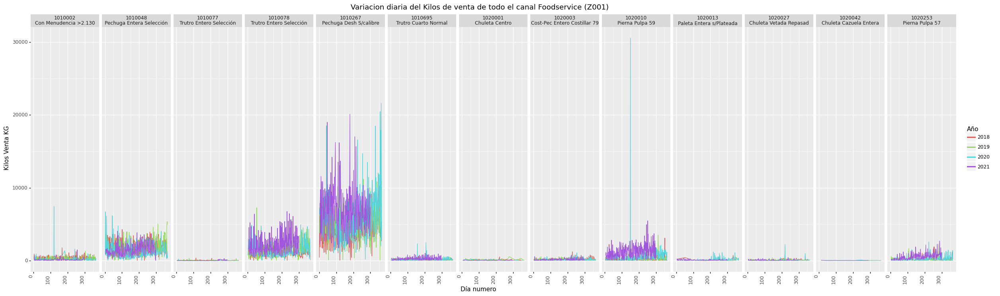

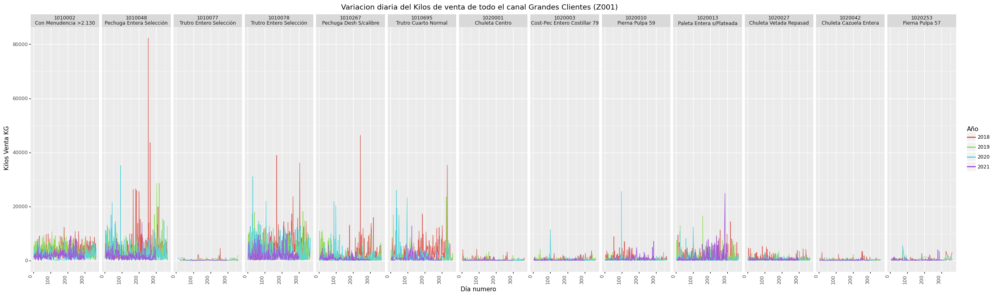

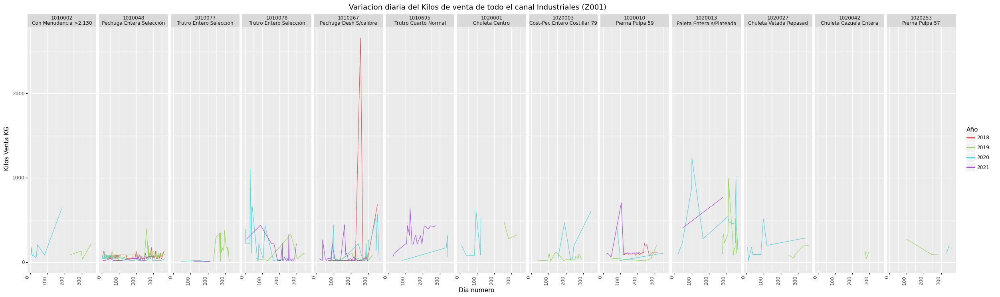

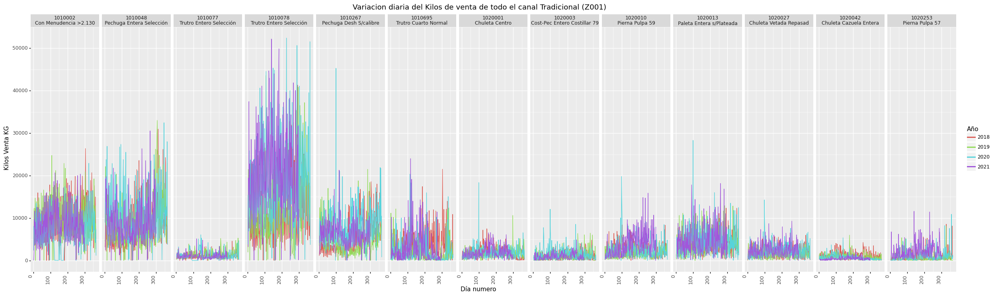

[<ggplot: (88594414650)>,
 <ggplot: (88641948106)>,
 <ggplot: (88594402868)>,
 <ggplot: (88642356700)>]

In [40]:
Lis_G_lineal_Canal_KG

#### PDF save

In [41]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(
    Lis_G_lineal+Lis_G_lineal_Canal +Lis_G_lineal_Canal_KG
                  ,file_direct_Graphic+'/Generales/'+"/Variacion diaria precio.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Variacion diaria precio.pdf


Time Lapsed = 0:0:19.671366214752197 
 H:m:s


### Dispersion de puntos

In [42]:
print(df['Material'].unique()[0])
print(df['Nivel 4.1'].unique()[0])

1010002
Con Menudencia >2.130


1010002 Con Menudencia >2.130
1010048 Pechuga Entera Selección
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010267 Pechuga Desh S/calibre
1010695 Trutro Cuarto Normal
1020001 Chuleta Centro
1020003 Cost-Pec Entero Costillar 79
1020010 Pierna Pulpa 59
1020013 Paleta Entera s/Plateada
1020027 Chuleta Vetada Repasad
1020042 Chuleta Cazuela Entera
1020253 Pierna Pulpa 57


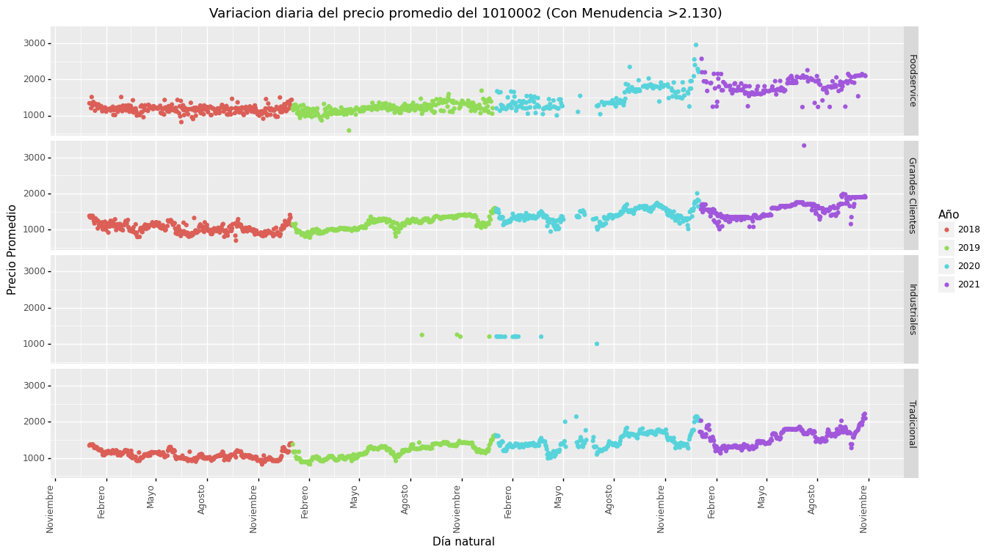

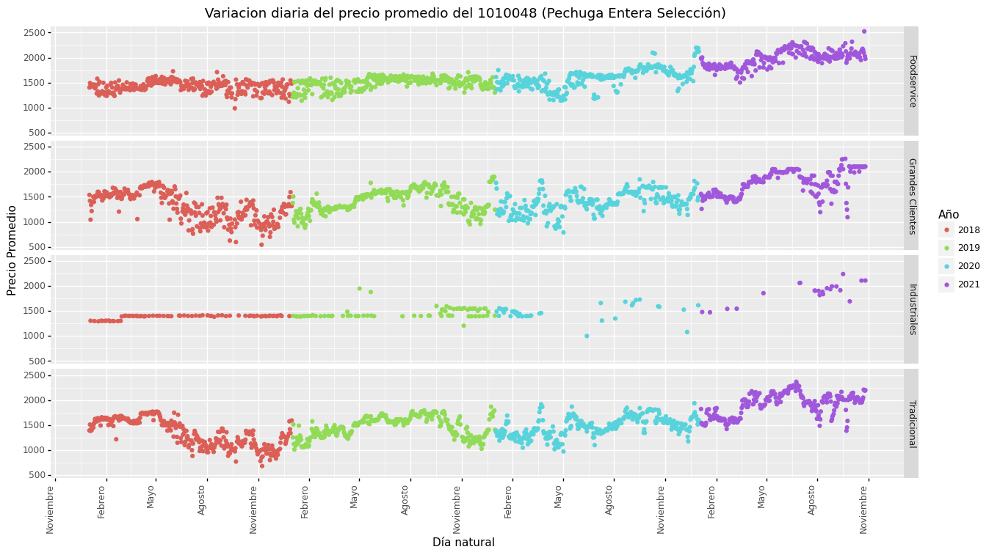

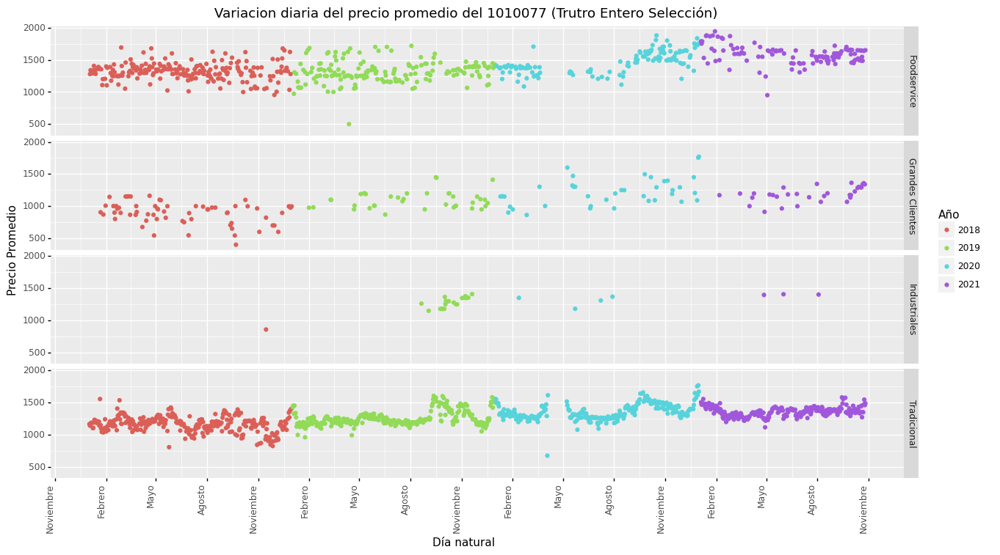

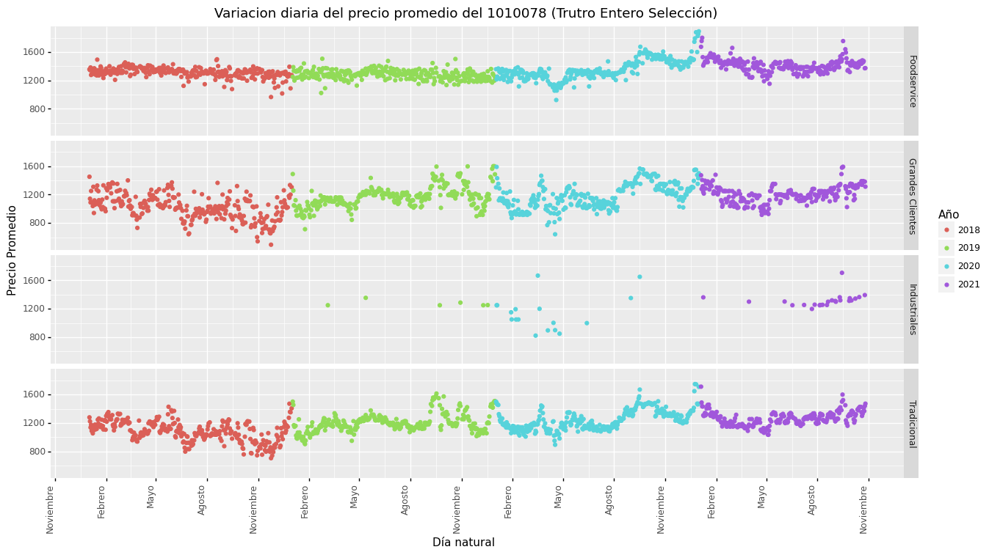

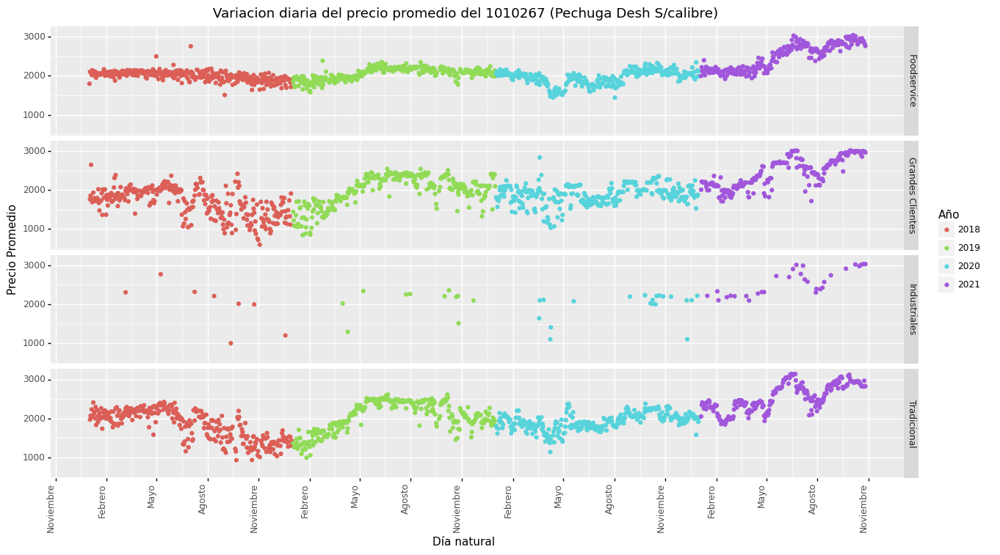

...

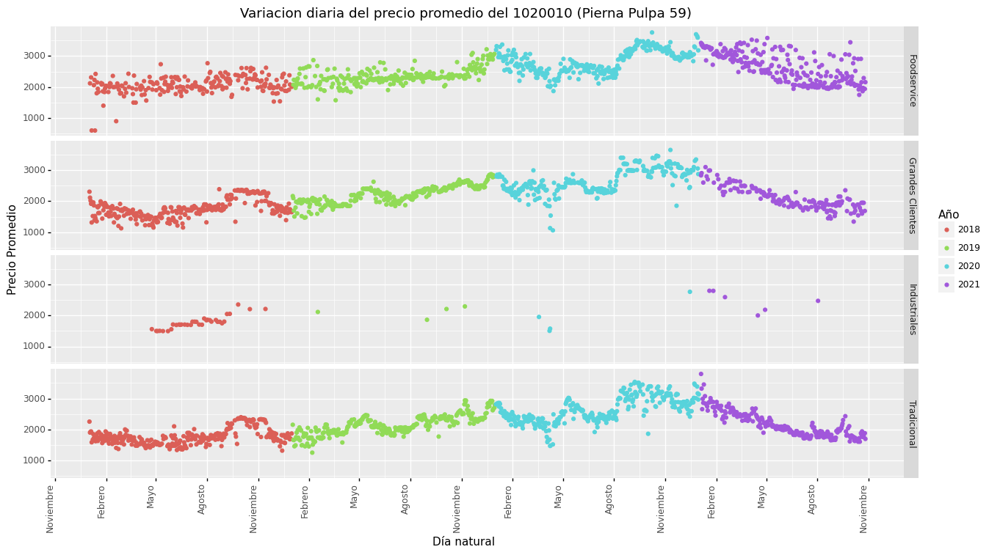

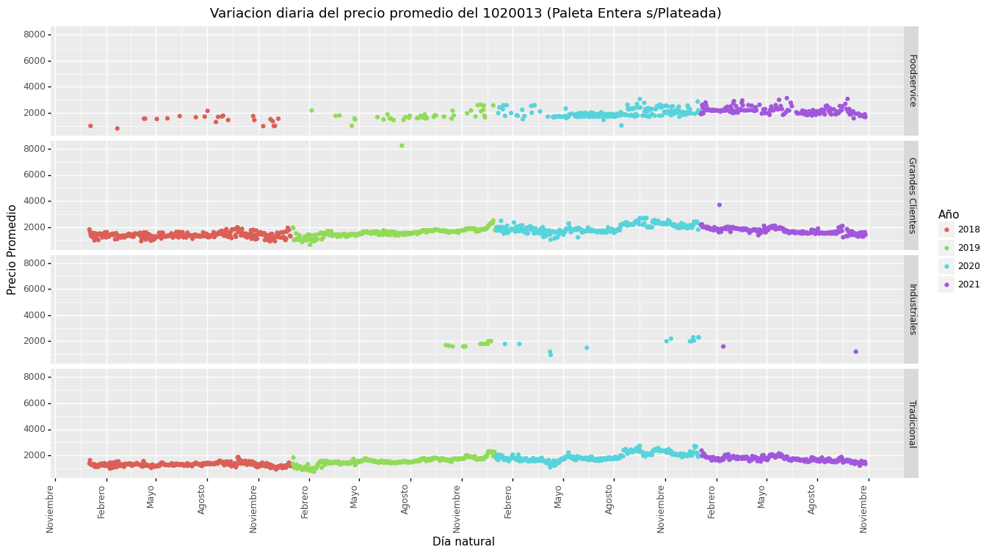

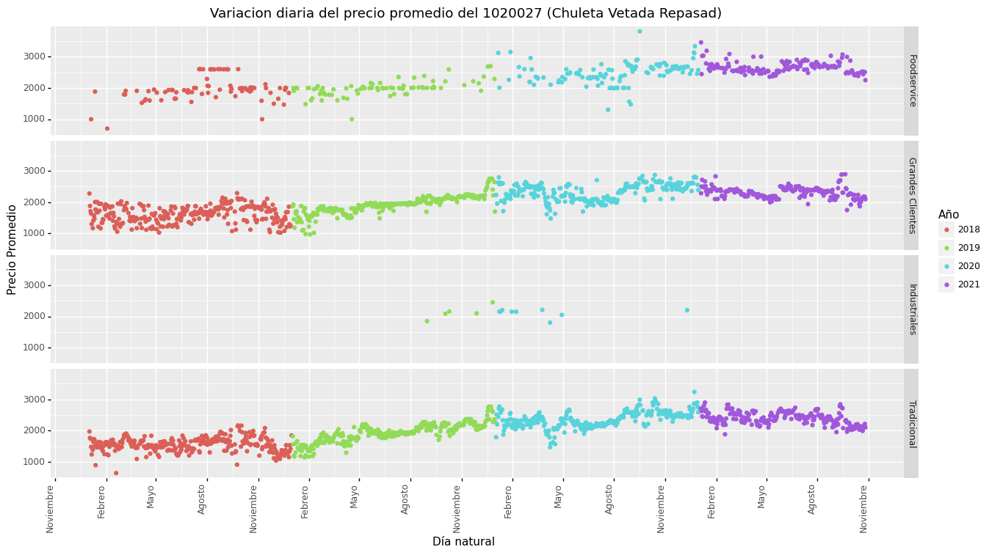

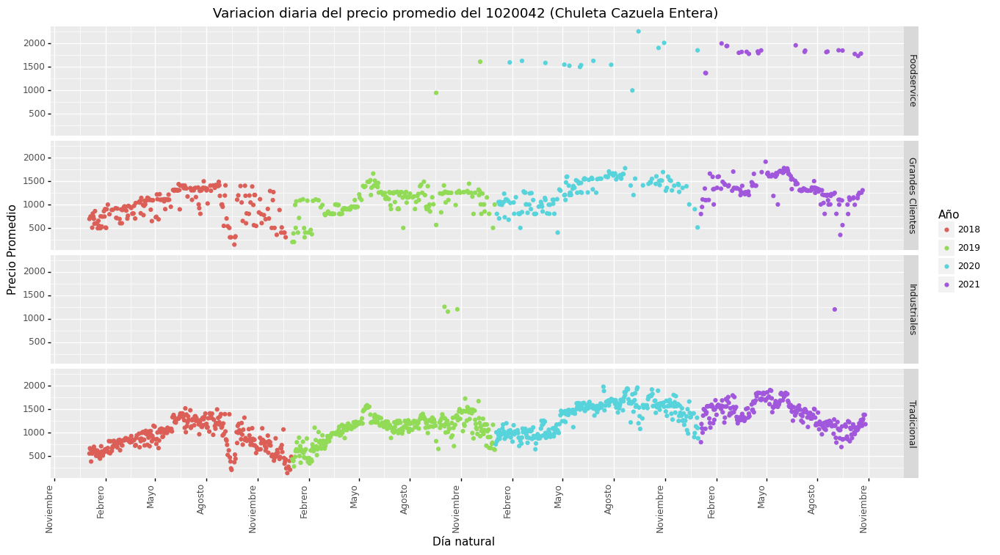

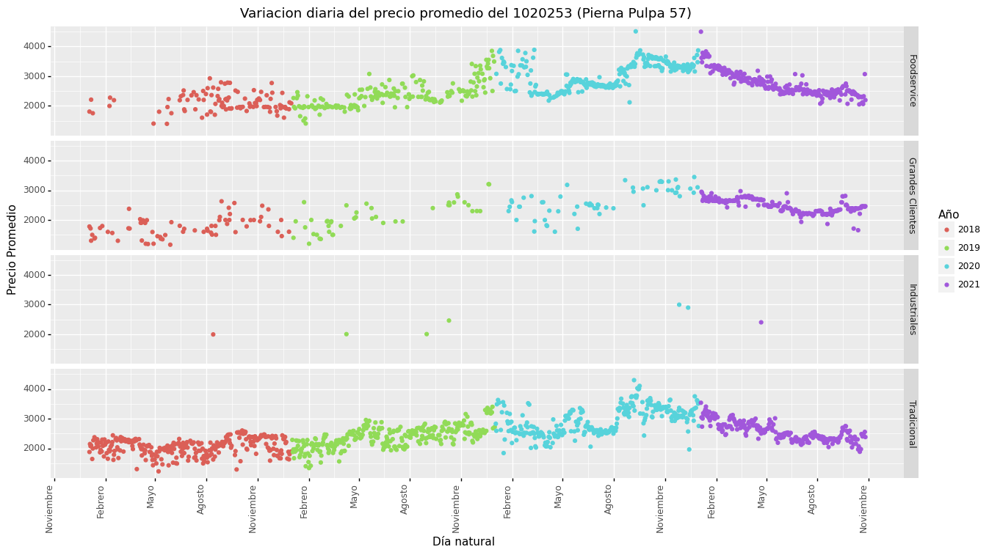

[<ggplot: (88606753521)>,
 <ggplot: (88606760701)>,
 <ggplot: (88606769872)>,
 <ggplot: (88606774260)>,
 <ggplot: (88606779028)>,
 <ggplot: (88606769541)>,
 <ggplot: (88606755259)>,
 <ggplot: (88606753181)>,
 <ggplot: (88606791461)>,
 <ggplot: (88606805489)>,
 <ggplot: (88606805495)>,
 <ggplot: (88606789639)>,
 <ggplot: (88606753461)>]

In [43]:
D=['Enero','Febrero','Marzo','Abril',
 'Mayo','Junio','Julio','Agosto',
 'Septiembre','Octubre',
 'Noviembre','Diciembre']
Month_dic={i:D[i-1]  for i in range(1,13)}

def custom_date_format1(breaks):
    """
    Function to format the date
    """
    return [Month_dic[x.month] if  x.day==1 else "" for x in breaks]

Lis_G_Puntos_A_continuo=[]
for i in df.Material.unique():
    s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    print(i,s)
    Lis_G_Puntos_A_continuo.append(ggplot(df[df.Material==i], aes(x='Día natural',
                     y='Precio Promedio' ,color='Año' ))\
    + geom_point()
 
      +scale_x_datetime(                                # modified
     breaks=date_breaks('3 month') ,labels=custom_date_format1)
    +facet_grid('Tipo de cliente~.')
 
     +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(15,8)) 
    +ggtitle(' Variacion diaria del precio promedio del '+ i+' ('+s+')' ) 
 
)
Lis_G_Puntos_A_continuo

1010002 Con Menudencia >2.130
1010048 Pechuga Entera Selección
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010267 Pechuga Desh S/calibre
1010695 Trutro Cuarto Normal
1020001 Chuleta Centro
1020003 Cost-Pec Entero Costillar 79
1020010 Pierna Pulpa 59
1020013 Paleta Entera s/Plateada
1020027 Chuleta Vetada Repasad
1020042 Chuleta Cazuela Entera
1020253 Pierna Pulpa 57


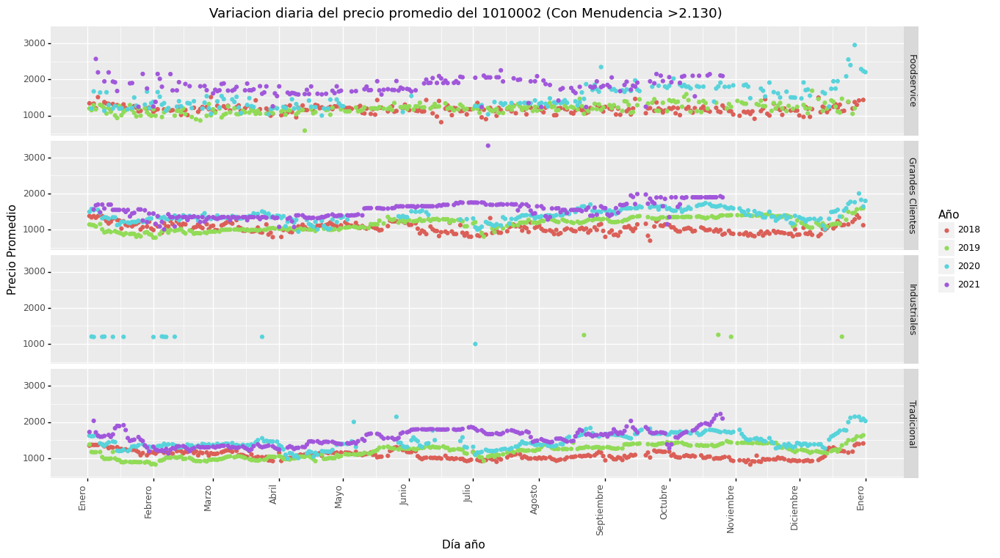

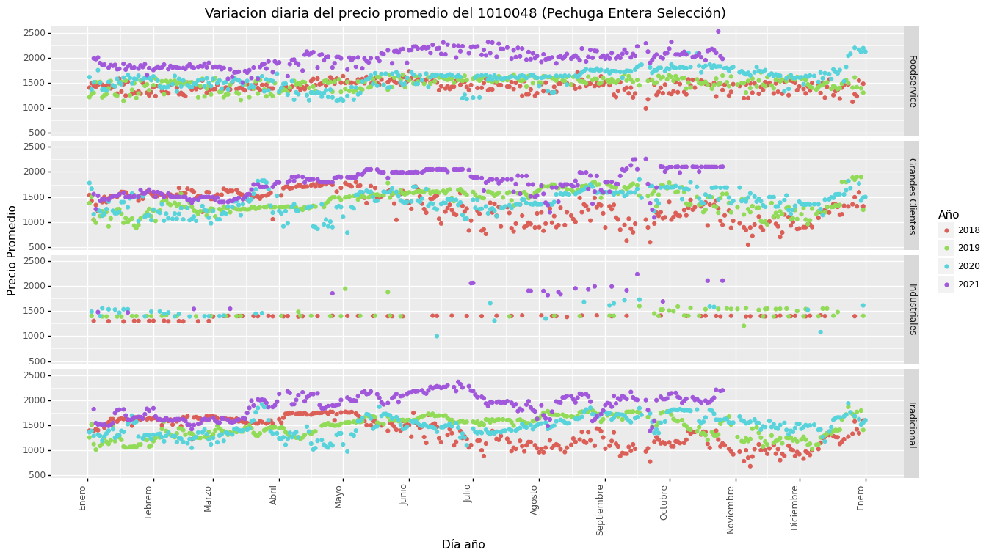

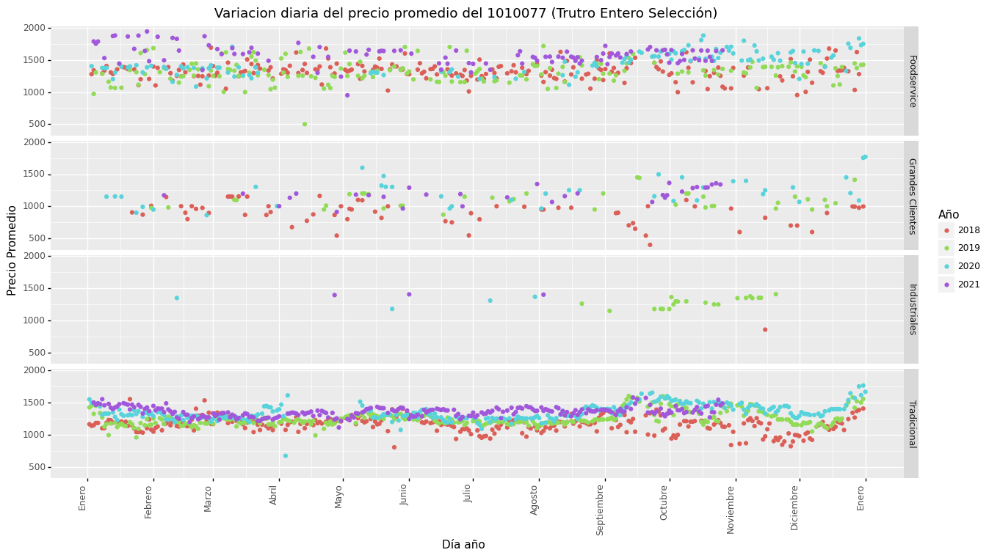

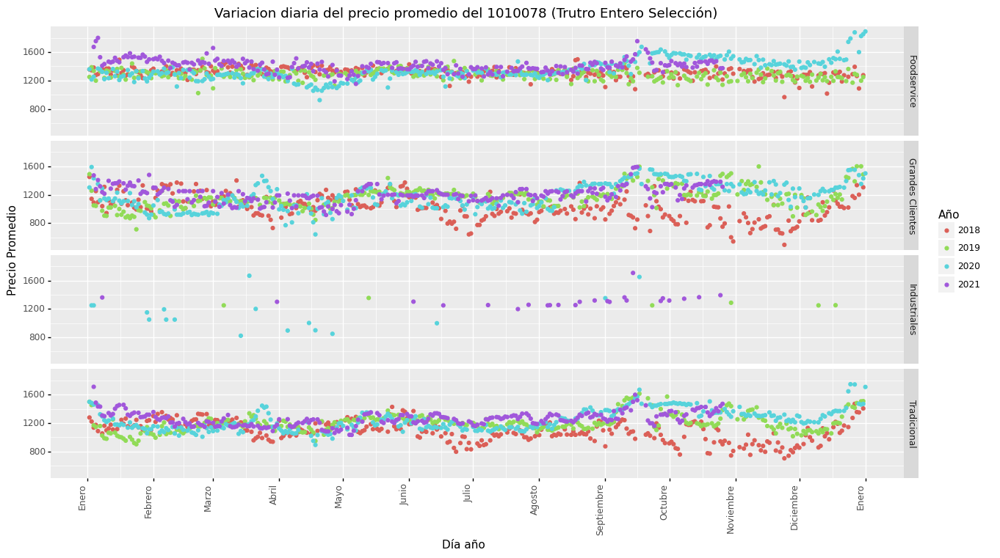

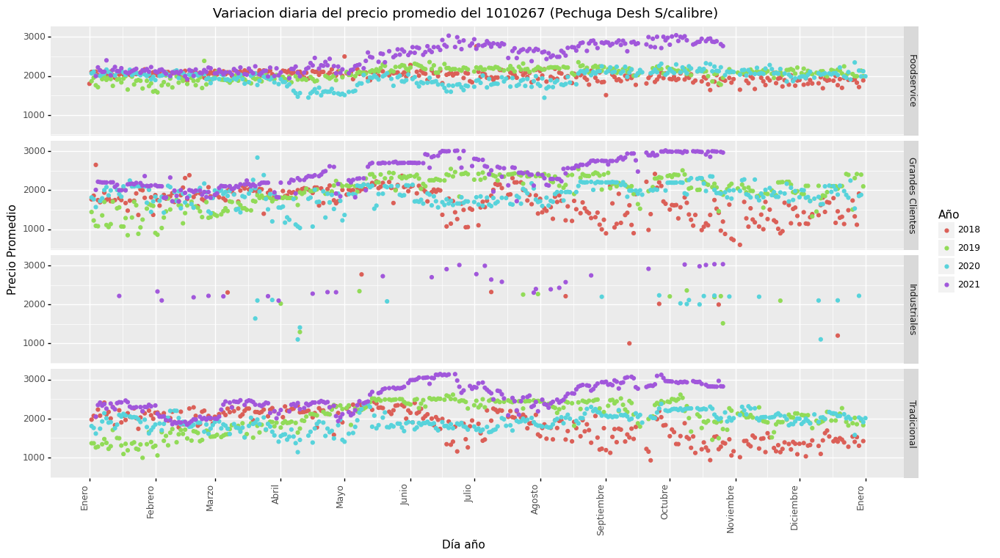

...

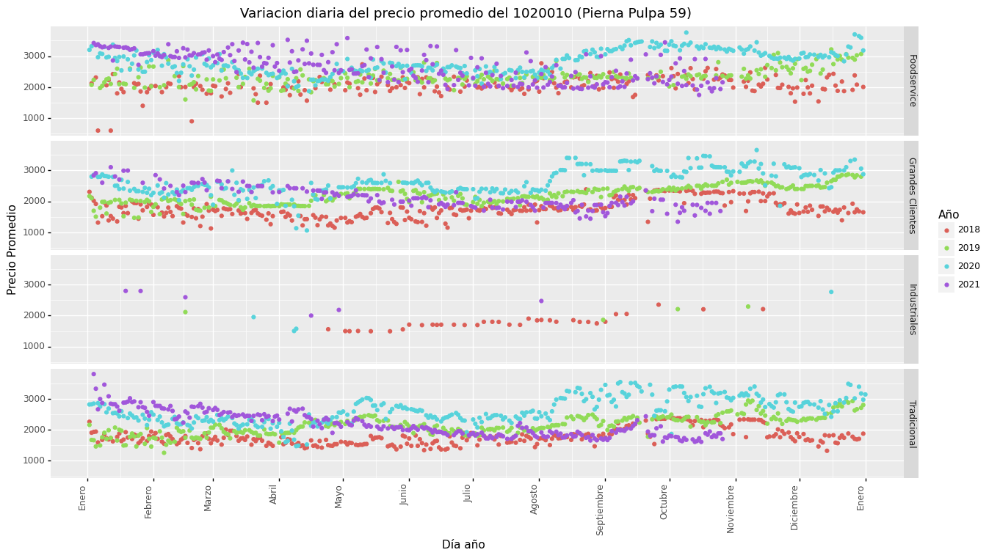

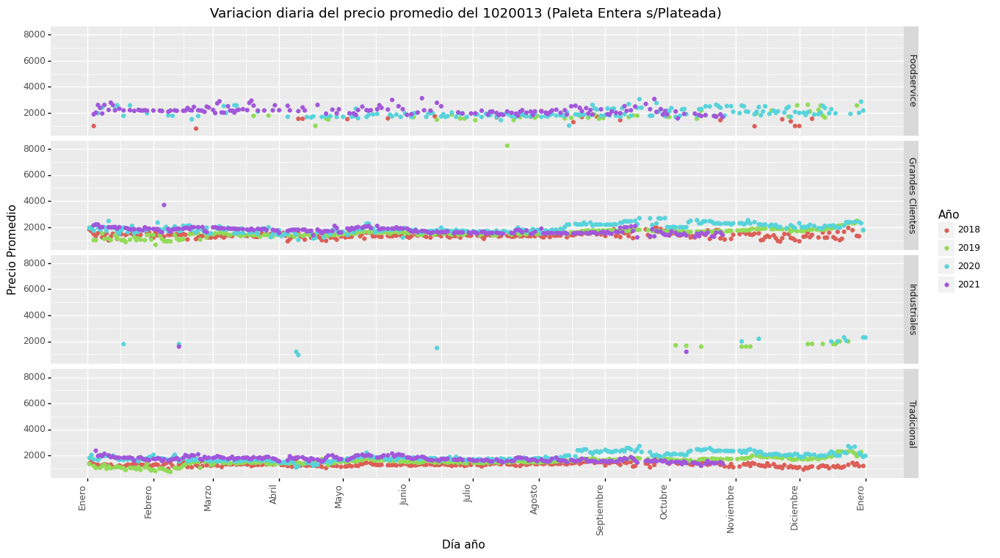

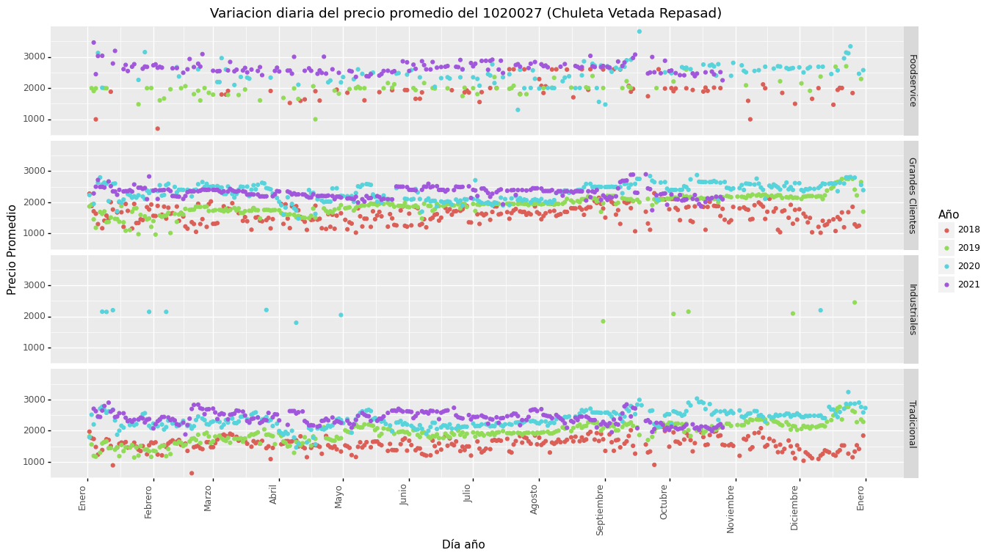

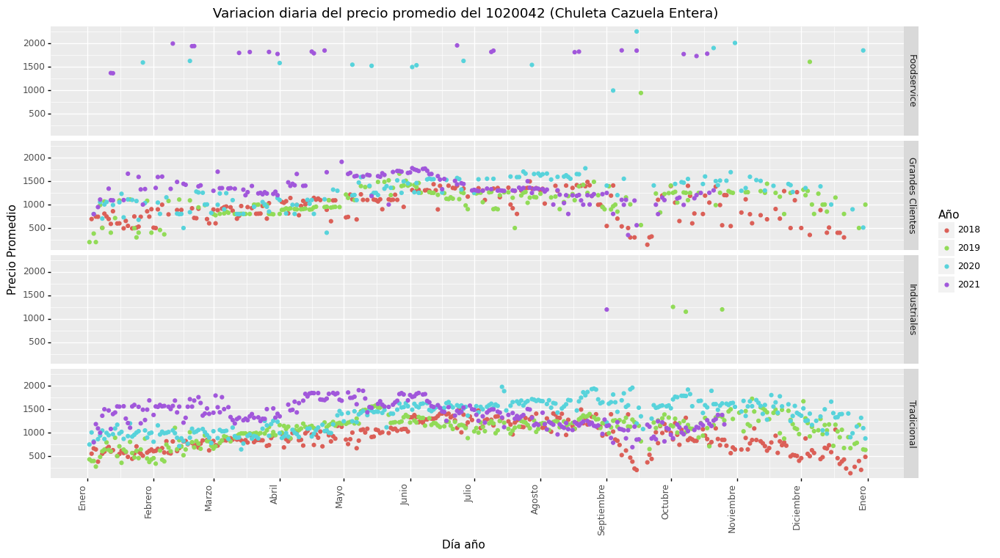

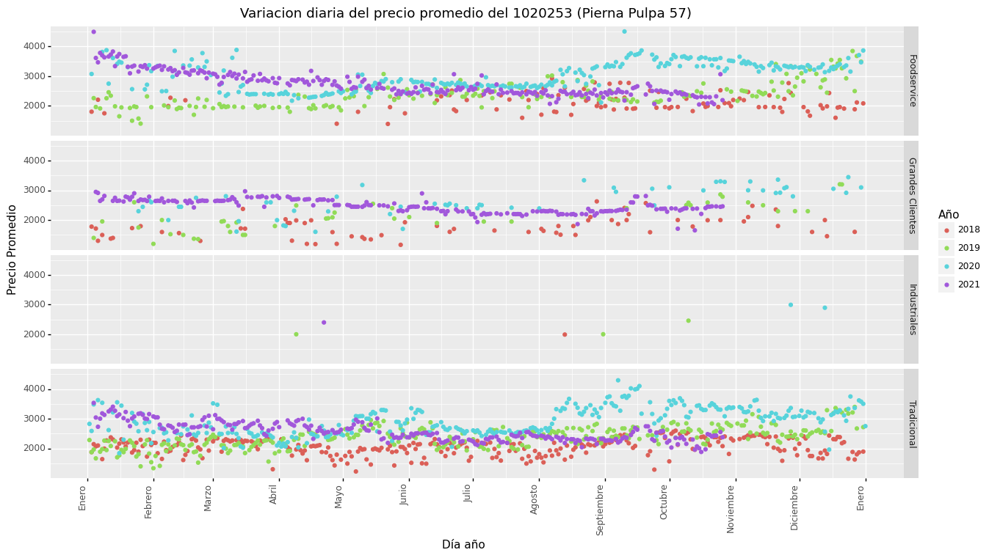

[<ggplot: (88606789922)>,
 <ggplot: (88606786190)>,
 <ggplot: (88606777890)>,
 <ggplot: (88598329507)>,
 <ggplot: (88599683063)>,
 <ggplot: (88598515167)>,
 <ggplot: (88606774176)>,
 <ggplot: (88599714874)>,
 <ggplot: (88599833631)>,
 <ggplot: (88600146405)>,
 <ggplot: (88619457669)>,
 <ggplot: (88600313902)>,
 <ggplot: (88606756377)>]

In [44]:
Lis_G_Puntos_=[]
for i in df.Material.unique():
    s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    print(i,s)
    Lis_G_Puntos_.append(ggplot(df[df.Material==i], aes(x='Día año',
                     y='Precio Promedio' ,color='Año' ))\
    + geom_point()
 
      +scale_x_datetime(                                # modified
     breaks=date_breaks('1 month') ,labels=custom_date_format1)
    +facet_grid('Tipo de cliente~.')
 
     +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(15,8)) 
    +ggtitle(' Variacion diaria del precio promedio del '+ i+' ('+s+')' ) 
 
)
Lis_G_Puntos_

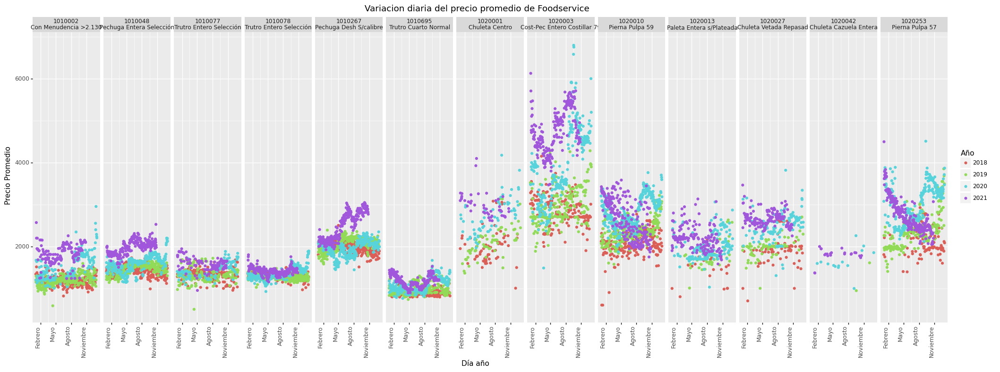

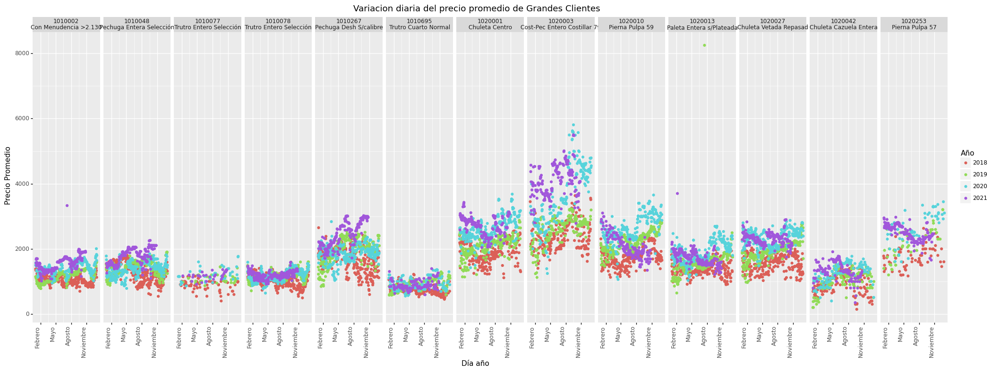

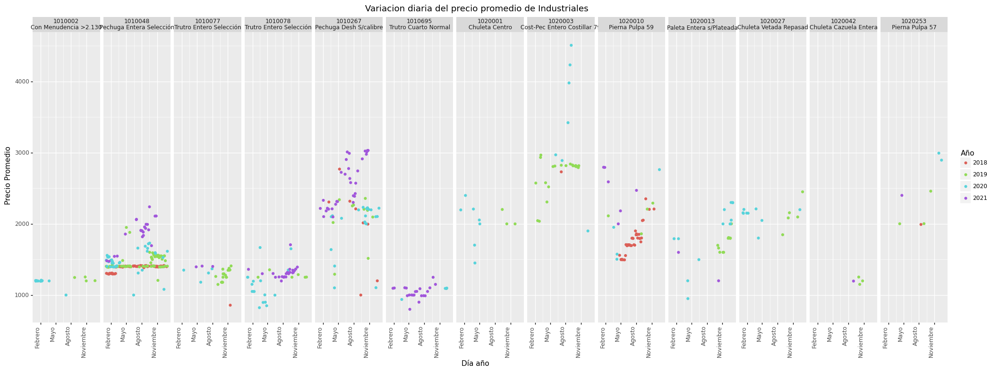

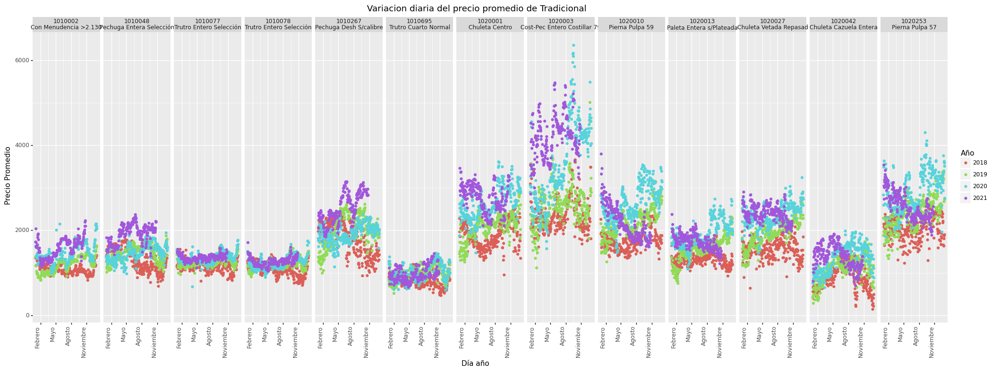

[<ggplot: (88595925712)>,
 <ggplot: (88606774435)>,
 <ggplot: (88600188992)>,
 <ggplot: (88596021902)>]

In [45]:
Lis_G_Puntos_Cliente=[]
for i in df['Tipo de cliente'].unique():
    #s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    #print(i,s)
    Lis_G_Puntos_Cliente.append(ggplot(df[df['Tipo de cliente']==i], aes(x='Día año',
                     y='Precio Promedio' ,color='Año' ))\
    + geom_point()
 
      +scale_x_datetime(                                # modified
     breaks=date_breaks('3 month') ,labels=custom_date_format1)
    +facet_grid('.~ Material + Nivel 4.1')
 
     +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(25,8)) 
    +ggtitle(' Variacion diaria del precio promedio de '+i ) 
 
)
Lis_G_Puntos_Cliente

In [46]:
D=['Enero','Febrero','Marzo','Abril',
 'Mayo','Junio','Julio','Agosto',
 'Septiembre','Octubre',
 'Noviembre','Diciembre']
Month_dic={i:D[i-1]  for i in range(1,13)}

def custom_date_format1(breaks):
    """
    Function to format the date
    """
    return [Month_dic[x.month] if  x.day==1 else "" for x in breaks]

Lis_G_Puntos_Agrup=[]

#=========================================
# Precios
#=========================================
for i in df.Material.unique():
    s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    print(i,s)
    #df['Kilos Venta KG']<=900) &
    Lis_G_Puntos_Agrup.append(ggplot(df[
                                        (df.Material==i) & (df['Tipo de cliente']==Tipo_de_Cliente) ]
                                          , aes(x='Día año',
                     y='Precio Promedio' ,color='Año' ))\
    + geom_point()
      +scale_x_datetime(                                # modified
     breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle(Tipo_de_Cliente+' \n'+'El Poducto de estudio es '+i+ '('+s+')')
     +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(15,8)) 
)
    
#=========================================
# Kilos de venta 
#=========================================
print('\n '+'-'.join(['-'for i in range(1,20)])+'\n'+'Kilos de venta')
for i in df.Material.unique():
    s=df[df.Material==i]['Nivel 4.1'].unique()[0]
    print(i,s)
    Lis_G_Puntos_Agrup.append(ggplot(df[
                                        (df.Material==i) & (df['Tipo de cliente']==Tipo_de_Cliente) ]
                                          , aes(x='Día año',
                     y='Kilos Venta KG' ,color='Año' ))\
    + geom_point()
      +scale_x_datetime(                                # modified
     breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle(Tipo_de_Cliente+' \n'+'El Poducto de estudio es '+i+' ('+s+')')
     +theme(axis_text_x = element_text(angle=90, hjust=1),figure_size=(15,8)) 
)

1010002 Con Menudencia >2.130
1010048 Pechuga Entera Selección
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010267 Pechuga Desh S/calibre
1010695 Trutro Cuarto Normal
1020001 Chuleta Centro
1020003 Cost-Pec Entero Costillar 79
1020010 Pierna Pulpa 59
1020013 Paleta Entera s/Plateada
1020027 Chuleta Vetada Repasad
1020042 Chuleta Cazuela Entera
1020253 Pierna Pulpa 57

 -------------------------------------
Kilos de venta
1010002 Con Menudencia >2.130
1010048 Pechuga Entera Selección
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010267 Pechuga Desh S/calibre
1010695 Trutro Cuarto Normal
1020001 Chuleta Centro
1020003 Cost-Pec Entero Costillar 79
1020010 Pierna Pulpa 59
1020013 Paleta Entera s/Plateada
1020027 Chuleta Vetada Repasad
1020042 Chuleta Cazuela Entera
1020253 Pierna Pulpa 57


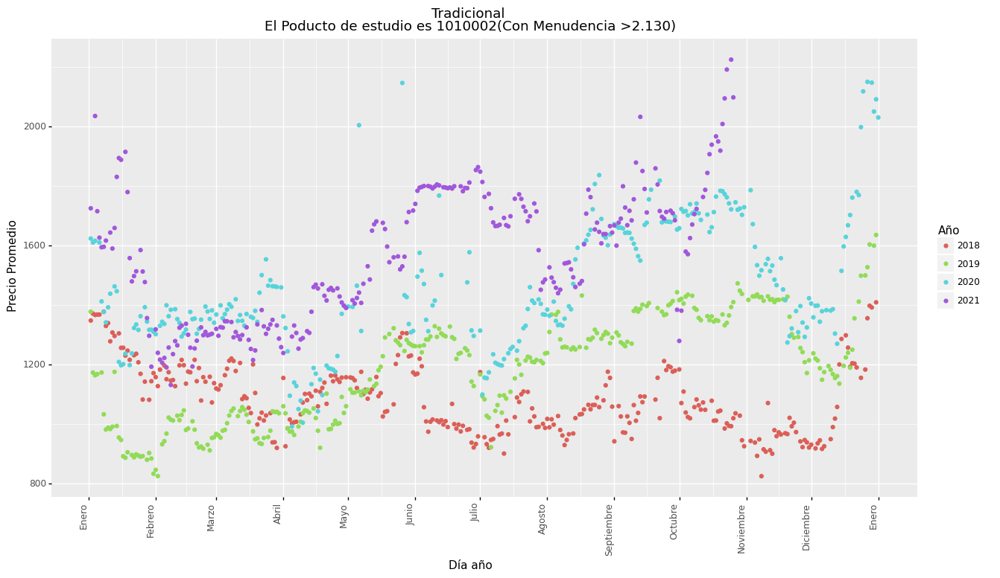

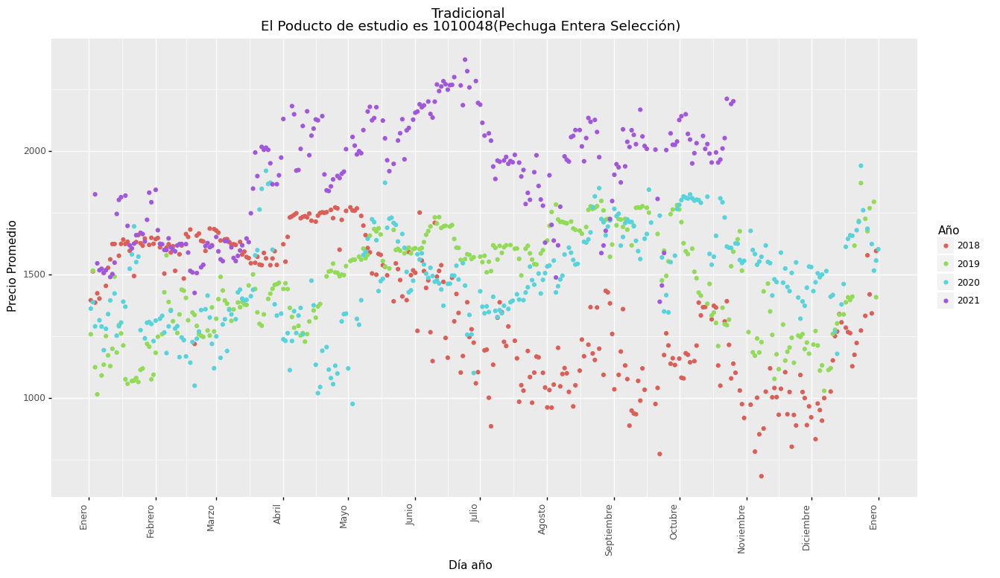

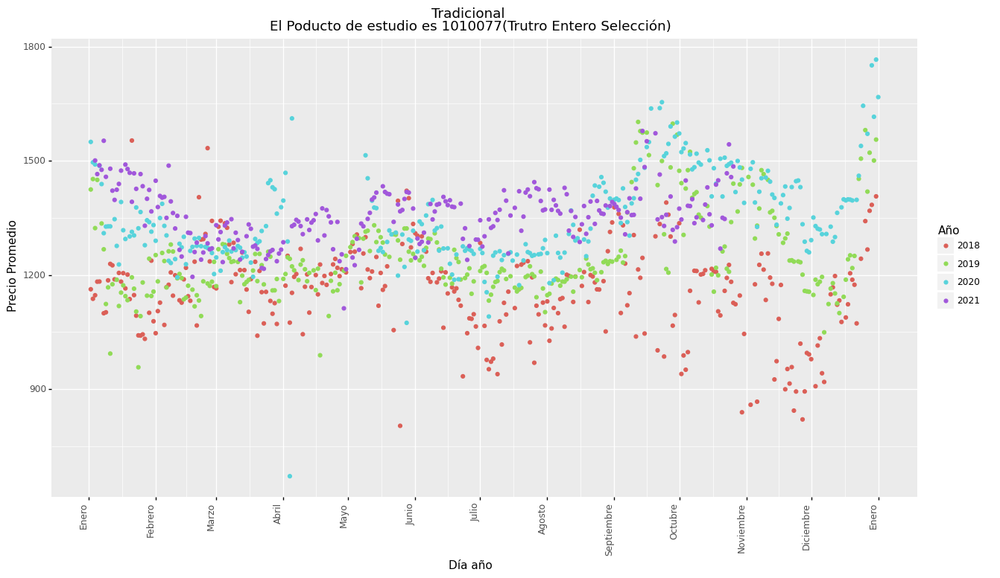

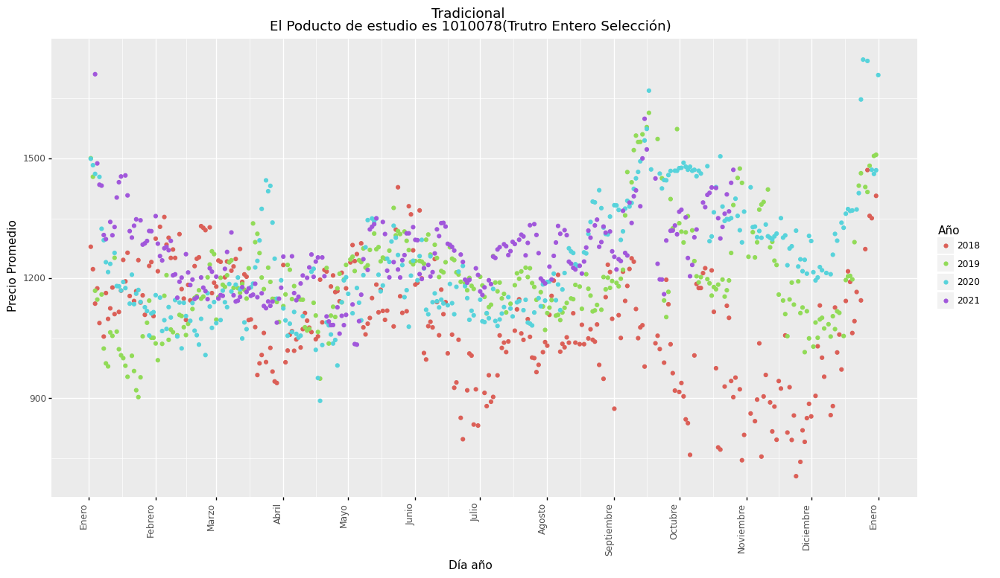

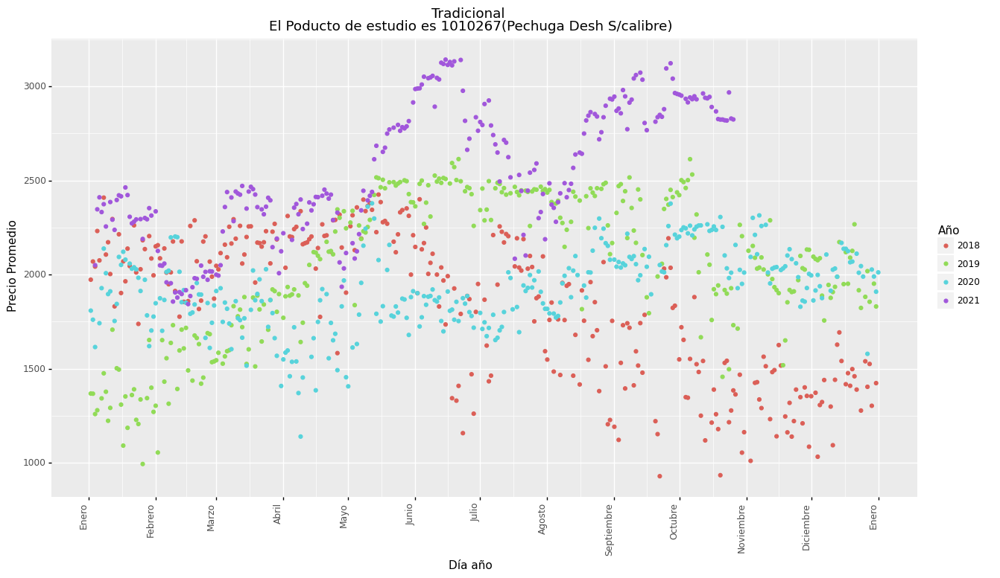

...

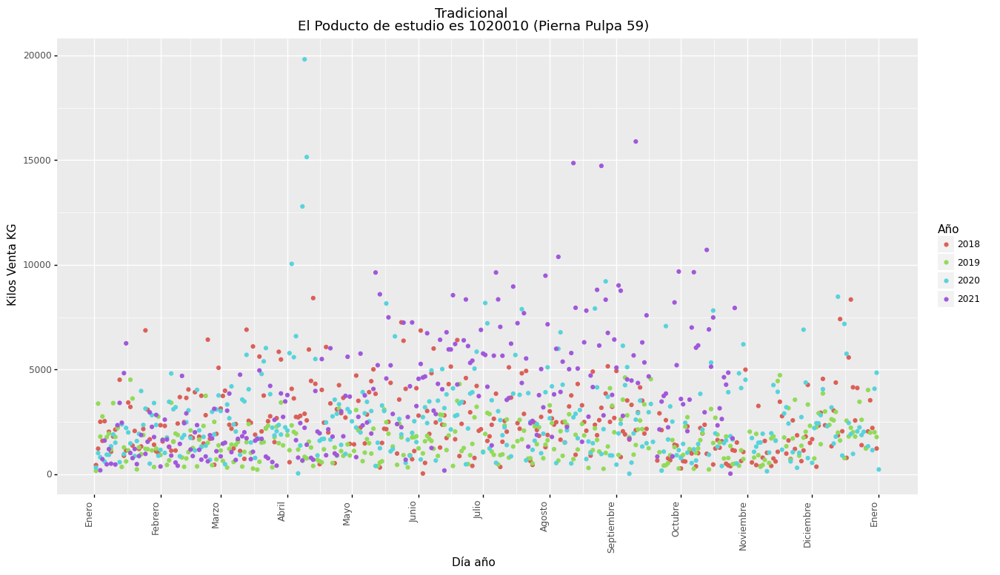

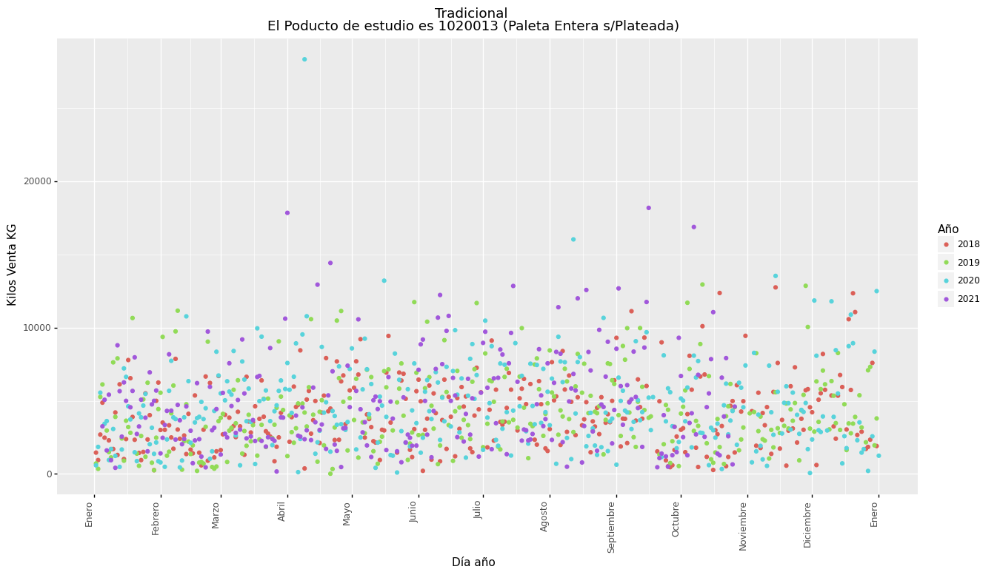

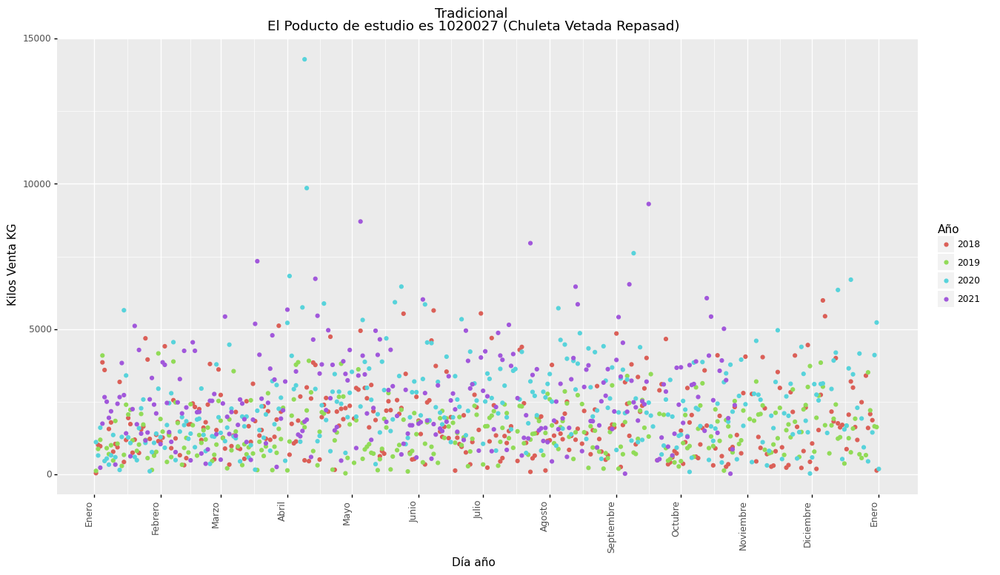

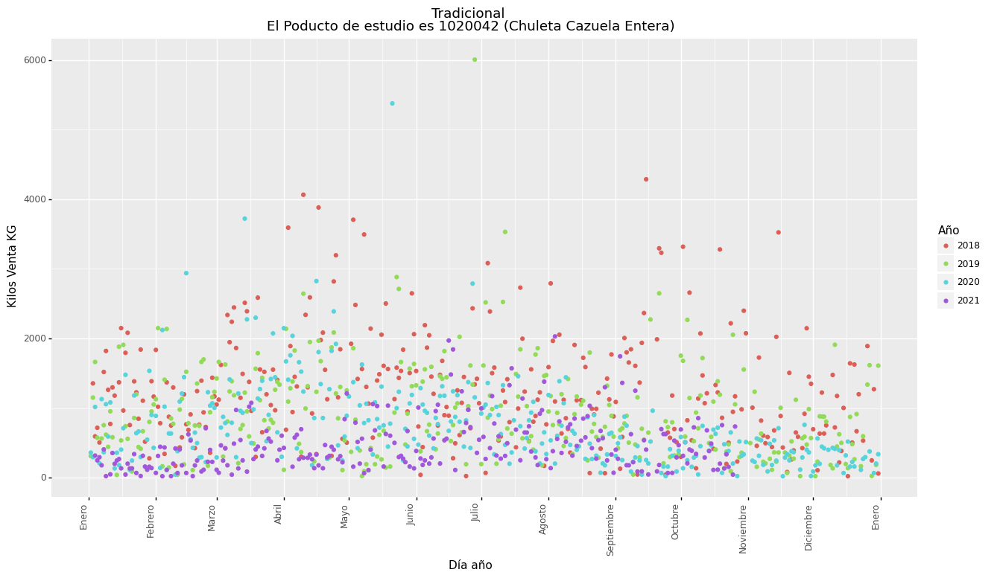

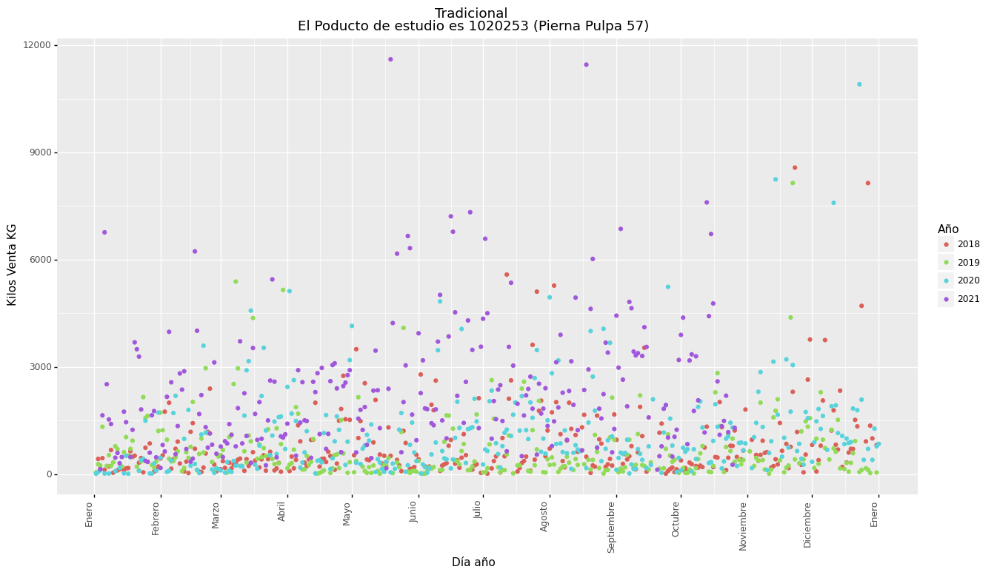

[<ggplot: (88606979913)>,
 <ggplot: (88594854768)>,
 <ggplot: (88606931014)>,
 <ggplot: (88618272130)>,
 <ggplot: (88606774269)>,
 <ggplot: (88600668022)>,
 <ggplot: (88619439496)>,
 <ggplot: (88600486015)>,
 <ggplot: (88633001415)>,
 <ggplot: (88595759782)>,
 <ggplot: (88594807781)>,
 <ggplot: (88594811158)>,
 <ggplot: (88594811380)>,
 <ggplot: (88595730571)>,
 <ggplot: (88600488274)>,
 <ggplot: (88606754988)>,
 <ggplot: (88594456658)>,
 <ggplot: (88600189097)>,
 <ggplot: (88594740652)>,
 <ggplot: (88594621037)>,
 <ggplot: (88606751790)>,
 <ggplot: (88595756749)>,
 <ggplot: (88619451700)>,
 <ggplot: (88600575564)>,
 <ggplot: (88647653738)>,
 <ggplot: (88643035152)>]

In [47]:
Lis_G_Puntos_Agrup

#### PDF save

In [48]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(
    Lis_G_Puntos_Cliente+
    Lis_G_Puntos_A_continuo+
    Lis_G_Puntos_Agrup
                  ,file_direct_Graphic+'/Generales/'+"/Variacion diarias puntos.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Variacion diarias puntos.pdf


Time Lapsed = 0:0:36.23607063293457 
 H:m:s


## Variacion precio mes

__Boxplot__ mensuales y semanales, con los diferentes años, de esta forma se superponen los años en un mismo mes 


Se estan usando todos los datos para estos graficos

In [49]:
DF_Full['Mes']=DF_Full['Mes'].astype('category')
DF_Full['Año']=DF_Full['Año'].astype('category')

In [50]:
DF_Full.loc[(DF_Full['Material']==Y_producto) & (DF_Full['Tipo de cliente']==Tipo_de_Cliente)] 
#DF_Full[DF_Full['Tipo de cliente']==Tipo_de_Cliente].reset_index(([DF_Full['Material']==Y_producto ]

,Zona de ventas,Zona de ventas.1,Cliente,Cliente.1,Cliente - Local,Cliente - Local.1,Material,Día natural,Kilos Venta KG,Venta Neta,...,Marca,Nivel 2,Granel/Envasado,Marinado,Nivel 3,Grupo artículos,Estado,Estandar,Envase,Material Nombre
61455,Z001,Santiago,10003742,Ferrer Leiva Sonia,Ferrer Leiva Sonia,38458,1010078,2020-05-23,22.0,28795.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
61456,Z001,Santiago,10007508,Curin Curamil Juan Francisco,Curin Juan Francisco,38506,1010078,2018-03-01,110.0,129140.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
61457,Z001,Santiago,10007508,Curin Curamil Juan Francisco,Curin Juan Francisco,38506,1010078,2018-03-08,66.0,77484.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
61458,Z001,Santiago,10007508,Curin Curamil Juan Francisco,Curin Juan Francisco,38506,1010078,2018-03-20,66.0,68044.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
61459,Z001,Santiago,10007508,Curin Curamil Juan Francisco,Curin Juan Francisco,38506,1010078,2018-03-27,65.0,70950.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
297036,Z001,Santiago,9994662,Vasquez Cespedes Ana Maria,Vasquez Cespedes Ana Maria,3088,1010078,2021-10-14,22.0,31886.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
297037,Z001,Santiago,9994800,Correa Sepulveda Violeta Ester,Correa Sepulveda Violeta Ester,3200169099,1010078,2020-12-16,22.0,30761.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
297038,Z001,Santiago,9994800,Correa Sepulveda Violeta Ester,Correa Sepulveda Violeta Ester,3200169099,1010078,2021-06-09,22.0,25369.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)
297039,Z001,Santiago,9994800,Correa Sepulveda Violeta Ester,Correa Sepulveda Violeta Ester,3200169099,1010078,2021-06-30,22.0,25323.0,...,SUPER POLLO (SP),Trutro,GRANEL,MARINADO,Trutro Entero,01050,REFRIGERADO,PESO VARIABLE,NO CONGELADO,1010078\n (Trutro Entero Selección)


In [51]:
df.columns

Index(['Tipo de cliente', 'Material', 'Nivel 4.1', 'Día natural',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio', 'Semana', 'Mes',
       'Año', 'Día numero', 'Día año'],
      dtype='object')

In [53]:
i=Y_producto
T_i=Tipo_de_Cliente

In [54]:
def Mes_name(x):
    D=['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre']
    return(D[int(x)-1])
df=DF_Full.loc[(DF_Full['Material']==i) &
                    (DF_Full['Tipo de cliente']==T_i) &
                   (DF_Full['Kilos Venta KG']<1000)
              ].copy()#DF_FULL
df.head()


df['Mes_num']=df["Mes"]#.apply(lambda x: Mes_name(x))
df['Mes']=df["Mes_num"].apply(lambda x: Mes_name(x))
df[['Mes','Mes_num','Día natural']].head()

,Mes,Mes_num,Día natural
61455,Mayo,5,2020-05-23
61456,Marzo,3,2018-03-01
61457,Marzo,3,2018-03-08
61458,Marzo,3,2018-03-20
61459,Marzo,3,2018-03-27


Tradicional
1010078 Trutro Entero Selección


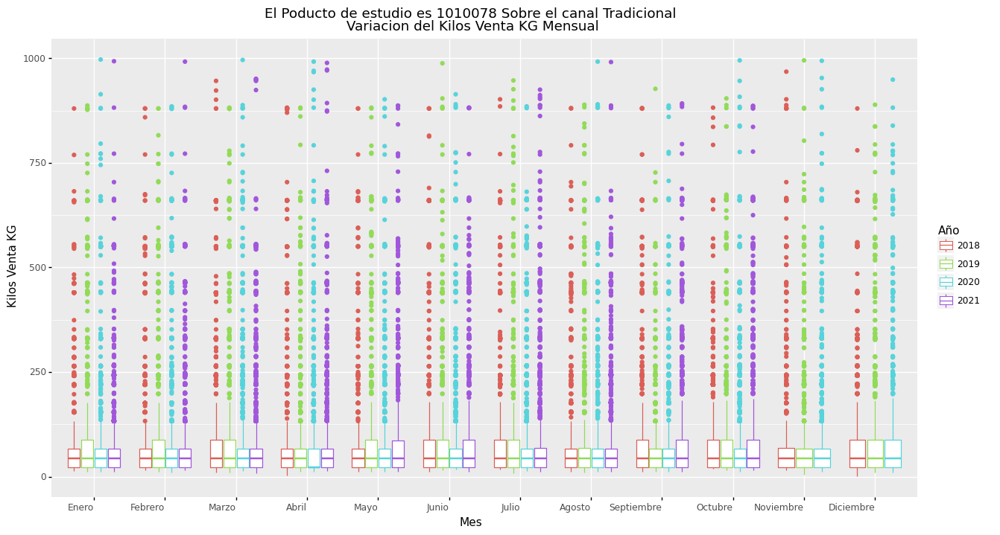

<ggplot: (88599027276)>

In [55]:
#======================================
# Kilos de venta
#======================================


def custom_date_format1(breaks):
    """
    Function to format the date
    """
    D=['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre']
    Month_dic={i:D[i-1]  for i in range(1,13)}
    return [Month_dic[x.month] if  x.day==1 else "" for x in breaks]

i=Y_producto
T_i=Tipo_de_Cliente

Y_Graph='Kilos Venta KG'

def Mes_name(x):
    D=['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre']
    return(D[int(x)-1])
df=DF_Full.loc[(DF_Full['Material']==i) &
                    (DF_Full['Tipo de cliente']==T_i) &
                   (DF_Full['Kilos Venta KG']<1000)
              ].copy()#DF_FULL
#df.head()

"""
df['Mes_num']=df["Mes"]#.apply(lambda x: Mes_name(x))
df['Mes']=df["Mes_num"].apply(lambda x: Mes_name(x))
df[['Mes','Mes_num','Día natural']].head()
"""
s=df[df.Material==i]['Nivel 4.1'].unique()[0]

print(T_i)
print(i,s)

(ggplot(df
        ,aes(
            x=df["Mes"].apply(lambda x: Mes_name(x) ),
            y= Y_Graph ,
            color='Año' ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('El Poducto de estudio es '+Y_producto+' Sobre el canal '+ Tipo_de_Cliente
             +'\n Variacion del '+Y_Graph + ' Mensual'
             )
     +theme(axis_text_x = element_text(hjust=1),figure_size=(15,8)) 
     + scale_x_discrete(limits= ['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre'])
)

In [56]:
DF_Full.Material.unique()

array(['1010077', '1010078', '1010048', '1020253', '1020042', '1020027',
       '1020013', '1020010', '1020003', '1020001', '1010695', '1010002',
       '1010267'], dtype=object)

### KG mensual 

In [57]:
#======================================
# Kilos de venta Iterativo
#======================================

#----------------------------------------
# funcion que define los quiebres
def custom_date_format1(breaks):
    """
    Function to format the date
    """
    D=['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre']
    Month_dic={i:D[i-1]  for i in range(1,13)}
    
    return [Month_dic[x.month] if  x.day==1 else "" for x in breaks]
#--------------------------------------------------------------------



#======================================
# Kilos de venta Iterativo
#======================================
Y_Graph='Kilos Venta KG'

list_Graph_KG_mes=[]
for T_i in DF_Full['Tipo de cliente'].unique():
    print(T_i)
    for i in DF_Full.Material.unique():
        # Dataframe
        df=DF_Full.loc[(DF_Full['Material']==i) &
                            (DF_Full['Tipo de cliente']==T_i) &
                           (DF_Full['Kilos Venta KG']<1000)
                      ].copy()#DF_FULL
        # Nombre del producto
        s=df[df.Material==i]['Nivel 4.1'].unique()[0]

    
        print(i,s)
        
        # Grafico
        list_Graph_KG_mes.append(ggplot(df
                ,aes(
                    x=df["Mes"].apply(lambda x: Mes_name(x) ),
                    y= Y_Graph ,
                    color='Año' ))\
            + geom_boxplot()
              #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

             +ggtitle('El Poducto de estudio es '+i+' ('+s+')'+ ' Sobre el canal '+ T_i
                     +'\n Variacion del '+Y_Graph + ' Mensual'
                     )
             +theme(axis_text_x = element_text(#angle=90,
                                               hjust=1),figure_size=(15,8))
             + scale_x_discrete(
                        limits= ['Enero','Febrero','Marzo','Abril',
                                'Mayo','Junio','Julio','Agosto',
                                'Septiembre','Octubre',
                                'Noviembre','Diciembre'])
        )

Tradicional
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repasad
1020013 Paleta Entera s/Plateada
1020010 Pierna Pulpa 59
1020003 Cost-Pec Entero Costillar 79
1020001 Chuleta Centro
1010695 Trutro Cuarto Normal
1010002 Con Menudencia >2.130
1010267 Pechuga Desh S/calibre
Foodservice
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repasad
1020013 Paleta Entera s/Plateada
1020010 Pierna Pulpa 59
1020003 Cost-Pec Entero Costillar 79
1020001 Chuleta Centro
1010695 Trutro Cuarto Normal
1010002 Con Menudencia >2.130
1010267 Pechuga Desh S/calibre
Grandes Clientes
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repa

#### PDF save

In [58]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(list_Graph_KG_mes
                  ,file_direct_Graphic+'/Generales/'+"/Boxplot Mensual Kilos Venta.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Boxplot Mensual Kilos Venta.pdf


Time Lapsed = 0:2:22.811449766159058 
 H:m:s


### Precio mensual 

In [59]:
#======================================
# Precio de venta Iterativo
#======================================

#----------------------------------------
# funcion que define los quiebres
#--------------------------------------------------------------------



#======================================
# Precio de venta Iterativo
#======================================
Y_Graph='Precio Promedio'

list_Graph_precio_mes=[]
for T_i in DF_Full['Tipo de cliente'].unique():
    print(T_i)
    for i in DF_Full.Material.unique():
        # Dataframe
        df=DF_Full.loc[(DF_Full['Material']==i) &
                            (DF_Full['Tipo de cliente']==T_i)
                      ].copy()#DF_FULL
        # Nombre del producto
        s=df[df.Material==i]['Nivel 4.1'].unique()[0]

        
        print(i,s)
        
        #-------------------------------------------------
        # Grafico
        list_Graph_precio_mes.append(ggplot(df
                ,aes(
                    x=df["Mes"].apply(lambda x: Mes_name(x) ),
                    y= Y_Graph ,color='Año' ))\
            + geom_boxplot()
              #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

             +ggtitle('El Poducto de estudio es '+i+' ('+s+')'+ ' Sobre el canal '+ T_i
                     +'\n Variacion del '+Y_Graph + ' Mensual'
                     )
             +theme(axis_text_x = element_text(#angle=90,
                                               hjust=1),figure_size=(15,8))
                + scale_x_discrete(
                        limits= 
                        ['Enero','Febrero','Marzo','Abril',
                        'Mayo','Junio','Julio','Agosto',
                        'Septiembre','Octubre',
                        'Noviembre','Diciembre'])
        )

Tradicional
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repasad
1020013 Paleta Entera s/Plateada
1020010 Pierna Pulpa 59
1020003 Cost-Pec Entero Costillar 79
1020001 Chuleta Centro
1010695 Trutro Cuarto Normal
1010002 Con Menudencia >2.130
1010267 Pechuga Desh S/calibre
Foodservice
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repasad
1020013 Paleta Entera s/Plateada
1020010 Pierna Pulpa 59
1020003 Cost-Pec Entero Costillar 79
1020001 Chuleta Centro
1010695 Trutro Cuarto Normal
1010002 Con Menudencia >2.130
1010267 Pechuga Desh S/calibre
Grandes Clientes
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repa

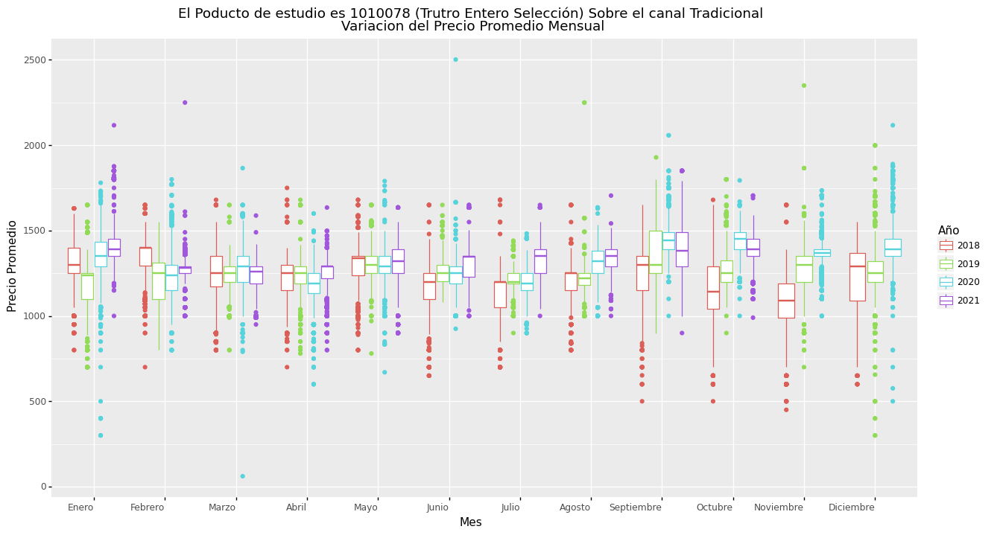

<ggplot: (88669191656)>

In [60]:
list_Graph_precio_mes[1]

#### PDF save

In [61]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(list_Graph_precio_mes
                  ,file_direct_Graphic+'/Generales/'+"/Boxplot Mensual Precio promedio.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Boxplot Mensual Precio promedio.pdf


Time Lapsed = 0:2:12.790358066558838 
 H:m:s


### Semanal 

In [62]:
#======================================
# Una iteracion
#======================================

i=Y_producto
T_i=Tipo_de_Cliente

Y_Graph='Precio Promedio'

def Mes_name(x):
    D=['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre']
    return(D[int(x)-1])


#=============================
# Data
#=============================
df=DF_Full.loc[(DF_Full['Material']==i) &
                    (DF_Full['Tipo de cliente']==T_i) 
               #&(DF_Full['Kilos Venta KG']<1000)
              ].copy()#DF_FULL
#df.head()

"""
df['Mes_num']=df["Mes"]#.apply(lambda x: Mes_name(x))
df['Mes']=df["Mes_num"].apply(lambda x: Mes_name(x))
df[['Mes','Mes_num','Día natural']].head()
"""
df.Semana=df['Semana'].astype('category')
df.Mes=df.Mes.apply(Mes_name) 

s=df[df.Material==i]['Nivel 4.1'].unique()[0]

print(T_i)
print(i,s)

Graph=(ggplot(df
        ,aes(
            x='Semana',#.astype('category'),
            y= Y_Graph 
            ,color='Mes'
        ))\
    + geom_boxplot()
      #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

     +ggtitle('El Poducto de estudio es '+Y_producto+' Sobre el canal '+ Tipo_de_Cliente
             +'\n Variacion del '+Y_Graph + ' Semanal'
             )
     +theme(axis_text_x = element_text(#angle=90,
                                       hjust=1),figure_size=(25,8))
     +facet_grid('Año~.')
)


Tradicional
1010078 Trutro Entero Selección


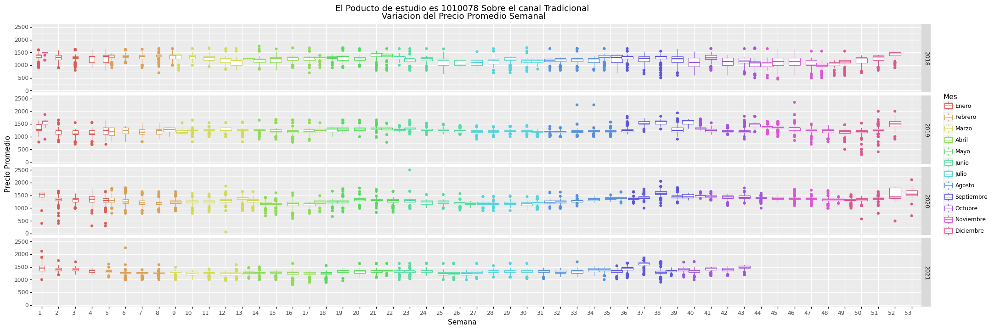

<ggplot: (88633366263)>

In [63]:
Graph

#### Iter

In [64]:
#======================================
# Una iteracion
#======================================
"""
i=Y_producto
T_i=Tipo_de_Cliente
"""
Y_Graph='Precio Promedio'

def Mes_name(x):
    D=['Enero','Febrero','Marzo','Abril',
    'Mayo','Junio','Julio','Agosto',
    'Septiembre','Octubre',
    'Noviembre','Diciembre']
    return(D[int(x)-1])


List_boxplor_week=[]
for T_i in DF_Full['Tipo de cliente'].unique():
    print( ''.join(['-' for j in range(1,20)]))
    print(T_i)
    for i in DF_Full.Material.unique():
        #=============================
        # Data
        #=============================
        df=DF_Full.loc[(DF_Full['Material']==i) &
                            (DF_Full['Tipo de cliente']==T_i) 
                       #&(DF_Full['Kilos Venta KG']<1000)
                      ].copy()#DF_FULL

        df.Semana=df['Semana'].astype('category')
        df.Mes=df.Mes.apply(Mes_name) 

        s=df[df.Material==i]['Nivel 4.1'].unique()[0]

        print(i,s)

        List_boxplor_week.append(ggplot(df
                ,aes(
                    x='Semana',#.astype('category'),
                    y= Y_Graph 
                    ,color='Mes'
                ))\
            + geom_boxplot()
              #+scale_x_datetime(breaks=date_breaks('1 month') ,labels=custom_date_format1)

             +ggtitle('El Poducto de estudio es '+i+' Sobre el canal '+ T_i
                     +'\n Variacion del '+Y_Graph + ' Semanal'
                     )
             +theme(axis_text_x = element_text(#angle=90,
                                               hjust=1),figure_size=(25,8))
             +facet_grid('Año~.')
        )


-------------------
Tradicional
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repasad
1020013 Paleta Entera s/Plateada
1020010 Pierna Pulpa 59
1020003 Cost-Pec Entero Costillar 79
1020001 Chuleta Centro
1010695 Trutro Cuarto Normal
1010002 Con Menudencia >2.130
1010267 Pechuga Desh S/calibre
-------------------
Foodservice
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 57
1020042 Chuleta Cazuela Entera
1020027 Chuleta Vetada Repasad
1020013 Paleta Entera s/Plateada
1020010 Pierna Pulpa 59
1020003 Cost-Pec Entero Costillar 79
1020001 Chuleta Centro
1010695 Trutro Cuarto Normal
1010002 Con Menudencia >2.130
1010267 Pechuga Desh S/calibre
-------------------
Grandes Clientes
1010077 Trutro Entero Selección
1010078 Trutro Entero Selección
1010048 Pechuga Entera Selección
1020253 Pierna Pulpa 5

#### PDF save

In [65]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(List_boxplor_week
                  ,file_direct_Graphic+'/Generales/'+"/Boxplot Semanal Precio promedio.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Boxplot Semanal Precio promedio.pdf


Time Lapsed = 0:9:26.43217158317566 
 H:m:s


## Volumen de ingresos y volumen de Ventas por canal

Se justificará el trabajo del cananl, tomando en cuenta los volumenes que son vendidos por cada producto mensualmente

### Data 

In [19]:
#==========================
# data con los valores promedio de las ventas
#(promedio por volumen)
#==========================
#[DF_Full['Tipo de cliente']==Tipo_de_Cliente]

data_fecha_medio=DF_Full.groupby(['Tipo de cliente','Centro.1','Material','Nivel 4.1','Año','Mes']).sum().reset_index()


data_fecha_medio['Precio Promedio']=data_fecha_medio['Venta Neta']/data_fecha_medio['Kilos Venta KG']
data_fecha_medio['Toneladas de Ventas Tg']=data_fecha_medio['Kilos Venta KG']/1000

# Ajuste fechas
#data_fecha_medio=data_fecha_medio.drop(columns='Año',axis=1)
data_fecha_medio=data_fecha_medio.drop(columns='Semana',axis=1)
data_fecha_medio.Mes=data_fecha_medio.Mes.astype('category')
print(data_fecha_medio.dtypes)

#Ajuste Material
def material_name(x):
    s1=str(x['Material'])
    s2=str(x['Nivel 4.1'])
    return(s1+'\n('+s2+')')
data_fecha_medio['Material Nombre']=data_fecha_medio.apply(lambda x:  material_name(x), axis=1)

print(len(data_fecha_medio['Material Nombre'].unique()))

data_fecha_medio= data_fecha_medio[data_fecha_medio['Precio Promedio'].notna()]
print(len(data_fecha_medio['Material Nombre'].unique()))

#Ajuste del ingreso total Millones
data_fecha_medio['Ingreso Neto en Miles de Millones CLP']=data_fecha_medio['Venta Neta']/10**9



data_fecha_medio.head()

Tipo de cliente             object
Centro.1                    object
Material                    object
Nivel 4.1                   object
Año                          int64
Mes                       category
Kilos Venta KG             float64
Venta Neta                 float64
Precio Promedio            float64
Toneladas de Ventas Tg     float64
dtype: object
13
13


,Tipo de cliente,Centro.1,Material,Nivel 4.1,Año,Mes,Kilos Venta KG,Venta Neta,Precio Promedio,Toneladas de Ventas Tg,Material Nombre,Ingreso Neto en Miles de Millones CLP
0,Foodservice,Sucursal Huechuraba,1010002,Con Menudencia >2.130,2018,1,93.0,120900.0,1300.000000,0.093,1010002\n(Con Menudencia >2.130),0.000121
1,Foodservice,Sucursal Huechuraba,1010002,Con Menudencia >2.130,2018,2,111.0,135771.0,1223.162162,0.111,1010002\n(Con Menudencia >2.130),0.000136
2,Foodservice,Sucursal Huechuraba,1010002,Con Menudencia >2.130,2018,3,194.0,249163.0,1284.345361,0.194,1010002\n(Con Menudencia >2.130),0.000249
3,Foodservice,Sucursal Huechuraba,1010002,Con Menudencia >2.130,2018,4,352.0,476470.0,1353.607955,0.352,1010002\n(Con Menudencia >2.130),0.000476
4,Foodservice,Sucursal Huechuraba,1010002,Con Menudencia >2.130,2018,5,367.0,445361.0,1213.517711,0.367,1010002\n(Con Menudencia >2.130),0.000445


In [20]:
#==========================
# df para un producto en especifico
#==========================
df=data_fecha_medio.copy()#[data_fecha_medio['Material']== Y_producto].copy()#[Data['Precio Unitario CLP / KG']<5000]
"""
df['Semana']=df['Semana'].astype('category')
df['Año']=df['Año'].astype('category')
df.Mes=df.Mes.astype('int64')
"""

"\ndf['Semana']=df['Semana'].astype('category')\ndf['Año']=df['Año'].astype('category')\ndf.Mes=df.Mes.astype('int64')\n"

In [21]:
df.columns

Index(['Tipo de cliente', 'Centro.1', 'Material', 'Nivel 4.1', 'Año', 'Mes',
       'Kilos Venta KG', 'Venta Neta', 'Precio Promedio',
       'Toneladas de Ventas Tg', 'Material Nombre',
       'Ingreso Neto en Miles de Millones CLP'],
      dtype='object')

In [34]:
df.groupby(['Material Nombre','Tipo de cliente', 'Año']).sum()

Kilos Venta KG  \
Material Nombre                  Tipo de cliente  Año                    
1010002\n(Con Menudencia >2.130) Foodservice      2018         88485.0   
                                                  2019         71224.0   
                                                  2020         37783.0   
                                                  2021         21064.0   
                                 Grandes Clientes 2018       1176538.0   
...                                                                ...   
1020253\n(Pierna Pulpa 57)       Industriales     2021           106.0   
                                 Tradicional      2018        243713.0   
                                                  2019        199773.0   
                                                  2020        329215.0   
                                                  2021        569344.0   

                                                          Venta Neta  \
Material Nombre                  Tipo de cliente  Año                  
1010002\n(Con Menudencia >2.130) Foodservice      2018  1.015060e+08   
                                                  2019  8.454827e+07   
                                                  2020  5.456378e+07   
                                                  2021  3.808672e+07   
                                 Grandes Clientes 2018  1.188227e+09   
...                                                              ...   
1020253\n(Pierna Pulpa 57)       Industriales     2021  2.543760e+05   
                                 Tradicional      2018  4.555100e+08   
                                                  2019  4.373427e+08   
                                                  2020  9.185688e+08   
                                                  2021  1.391060e+09   

                                                        Precio Promedio  \
Material Nombre                  Tipo de cliente  Año                     
1010002\n(Con Menudencia >2.130) Foodservice      2018     43056.800152   
                                                  2019     42465.271352   
                                                  2020     48120.453082   
                                                  2021     48292.289374   
                                 Grandes Clientes 2018     36501.373681   
...                                                                 ...   
1020253\n(Pierna Pulpa 57)       Industriales     2021      2399.773585   
                                 Tradicional      2018     69870.559493   
                                                  2019     80354.168791   
                                                  2020    100098.410593   
                                                  2021     74699.623713   

                                                        Toneladas de Ventas Tg  \
Material Nombre                  Tipo de cliente  Año                            
1010002\n(Con Menudencia >2.130) Foodservice      2018                  88.485   
                                                  2019                  71.224   
                                                  2020                  37.783   
                                                  2021                  21.064   
                                 Grandes Clientes 2018                1176.538   
...                                                                        ...   
1020253\n(Pierna Pulpa 57)       Industriales     2021                   0.106   
                                 Tradicional      2018                 243.713   
                                                  2019                 199.773   
                                                  2020                 329.215   
                                                  2021                 569.344   

                                                        Ingreso Neto en Miles de Millones CLP  
Material Nombre  

In [41]:
1.015060e+08/10**6

101.506

In [35]:
DF_Full.groupby(['Material Nombre','Tipo de cliente', 'Año']).sum()

Kilos Venta KG  \
Material Nombre                   Tipo de cliente  Año                    
1010002\n (Con Menudencia >2.130) Foodservice      2018         88485.0   
                                                   2019         71224.0   
                                                   2020         37783.0   
                                                   2021         21064.0   
                                  Grandes Clientes 2018       1176538.0   
...                                                                 ...   
1020253\n (Pierna Pulpa 57)       Industriales     2021           106.0   
                                  Tradicional      2018        243713.0   
                                                   2019        199773.0   
                                                   2020        329215.0   
                                                   2021        569344.0   

                                                           Venta Neta  \
Material Nombre                   Tipo de cliente  Año                  
1010002\n (Con Menudencia >2.130) Foodservice      2018  1.015060e+08   
                                                   2019  8.454827e+07   
                                                   2020  5.456378e+07   
                                                   2021  3.808672e+07   
                                  Grandes Clientes 2018  1.188227e+09   
...                                                               ...   
1020253\n (Pierna Pulpa 57)       Industriales     2021  2.543760e+05   
                                  Tradicional      2018  4.555100e+08   
                                                   2019  4.373427e+08   
                                                   2020  9.185688e+08   
                                                   2021  1.391060e+09   

                                                         Precio Promedio  \
Material Nombre                   Tipo de cliente  Año                     
1010002\n (Con Menudencia >2.130) Foodservice      2018        1154050.0   
                                                   2019         979471.0   
                                                   2020         523104.0   
                                                   2021         523058.0   
                                  Grandes Clientes 2018        2391264.0   
...                                                                  ...   
1020253\n (Pierna Pulpa 57)       Industriales     2021           2400.0   
                                  Tradicional      2018        7105958.0   
                                                   2019        8138522.0   
                                                   2020       14275049.0   
                                                   2021       22302416.0   

                                                         Semana    Mes  
Material Nombre                   Tipo de cliente  Año                  
1010002\n (Con Menudencia >2.130) Foodservice      2018   26143   6407  
                                                   2019   18852   4641  
                                                   2020    9067   2183  
                                                   2021    6325   1605  
                                  Grandes Clientes 2018   59675  14668  
...                                                         ...    ...  
1020253\n (Pierna Pulpa 57)       Industriales     2021      16      4  
                                  Tradicional      2018   90875  22334  
                                                   2019   85602  21043  
                                                   2020  155971  37290  
                                                   2021  208590  52572  

[194 rows x 5 columns]

### Anual

#### Ingresos 

In [23]:
df.Año.astype('int64')

0       2018
1       2018
2       2018
3       2018
4       2018
        ... 
5201    2021
5202    2021
5203    2021
5204    2021
5205    2021
Name: Año, Length: 5206, dtype: int64

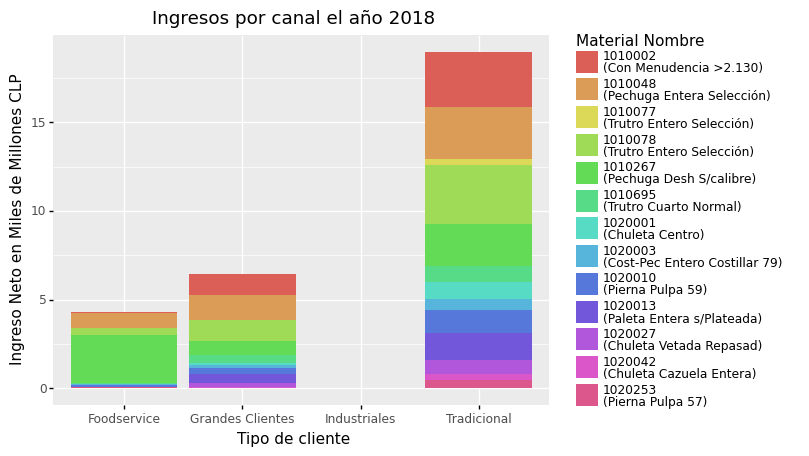

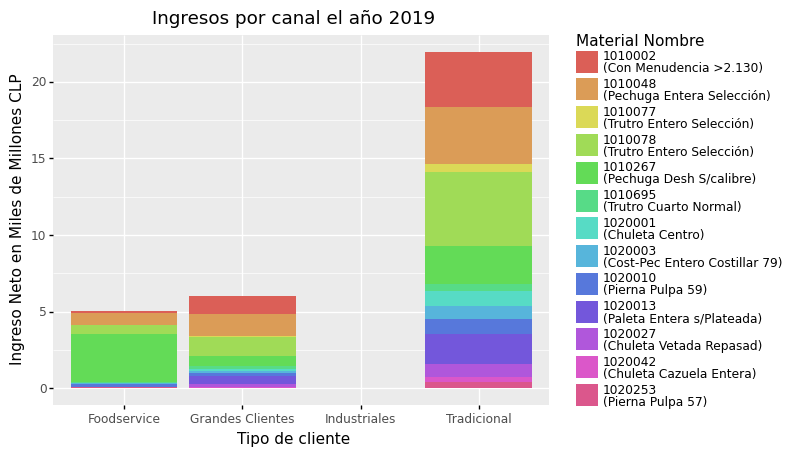

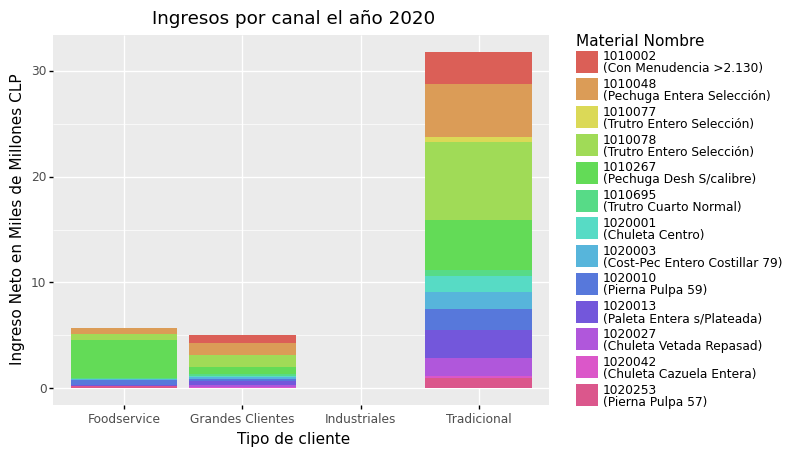

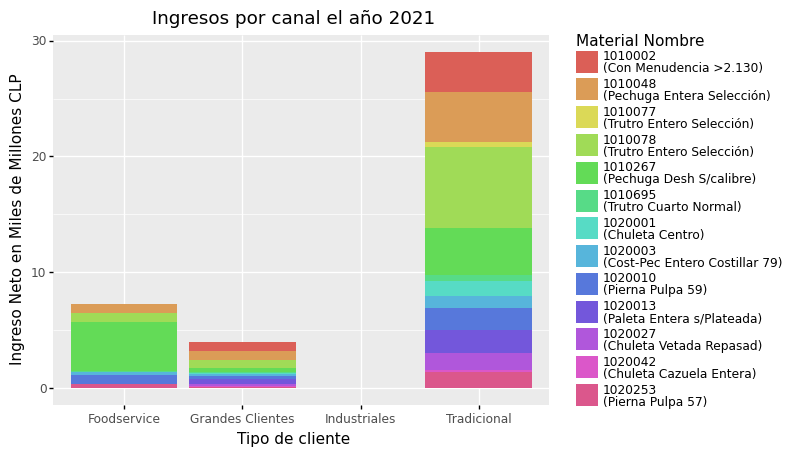

[<ggplot: (133489743725)>,
 <ggplot: (133442572797)>,
 <ggplot: (133442411511)>,
 <ggplot: (133459954131)>]

In [24]:
# Canal
#=================================================
# Variaciond e los ingresos por material
#=================================================

Ingr_list_Canal=[]
df.Año=df.Año.astype('int64')
(df.Año.unique()).sort()
Y_col='Ingreso Neto en Miles de Millones CLP'
for i in (df.Año.unique()):
    Ingr_list_Canal.append(ggplot(df[df.Año==i],
                            aes(x='Tipo de cliente', y=Y_col, fill='Material Nombre'))
     
        + geom_col(stat='identity',show_legend=True)
                   
        +ggtitle('Ingresos por canal el año ' + str(i))
                  )
Ingr_list_Canal

##### Ingresos Material 

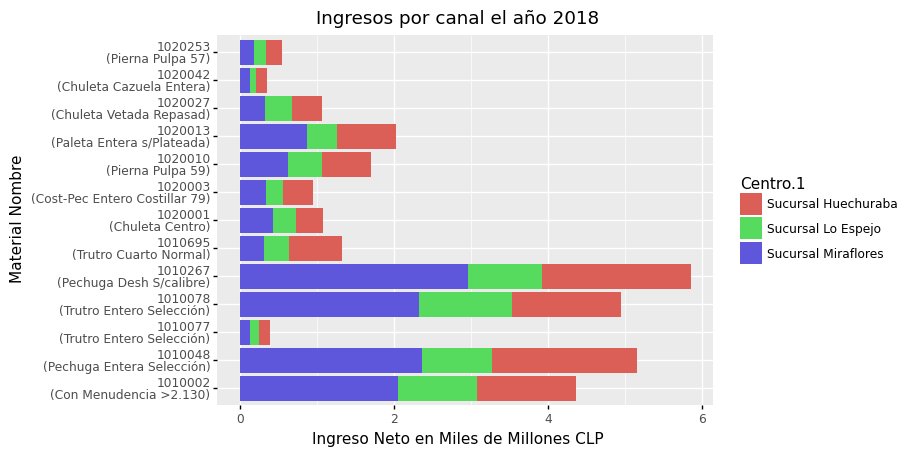

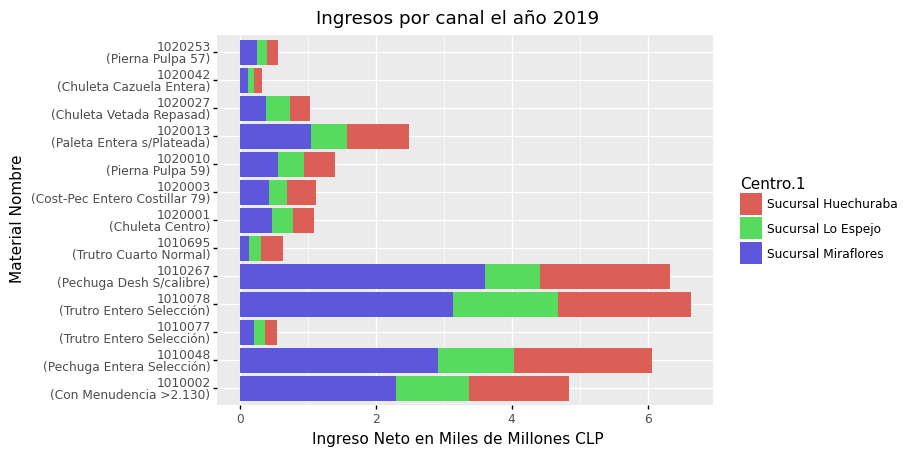

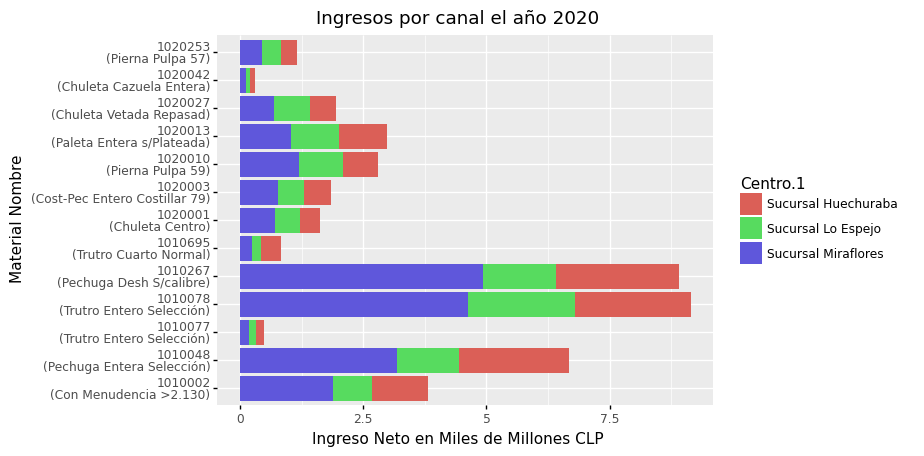

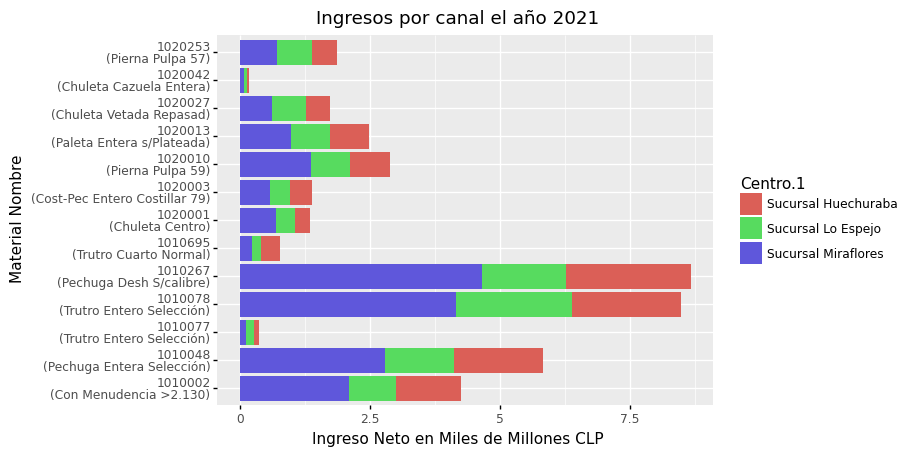

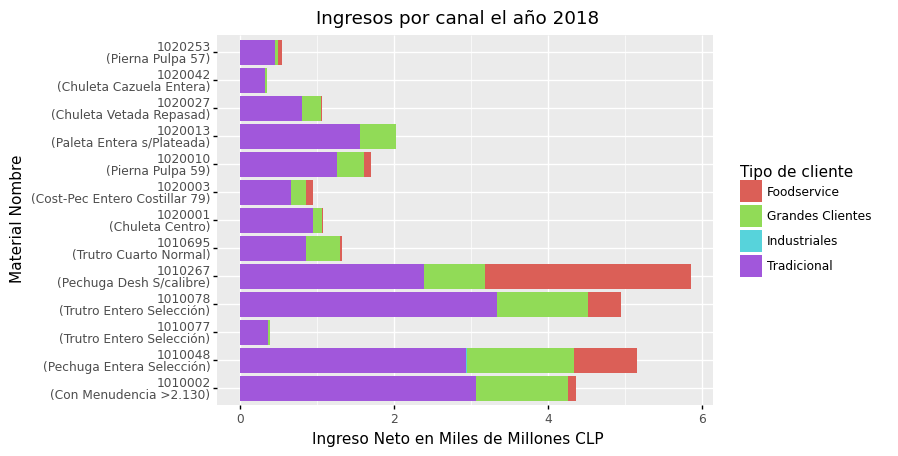

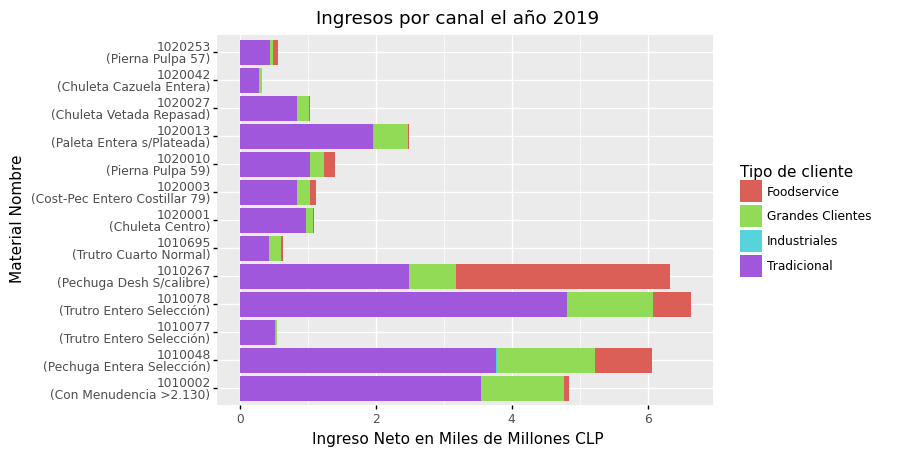

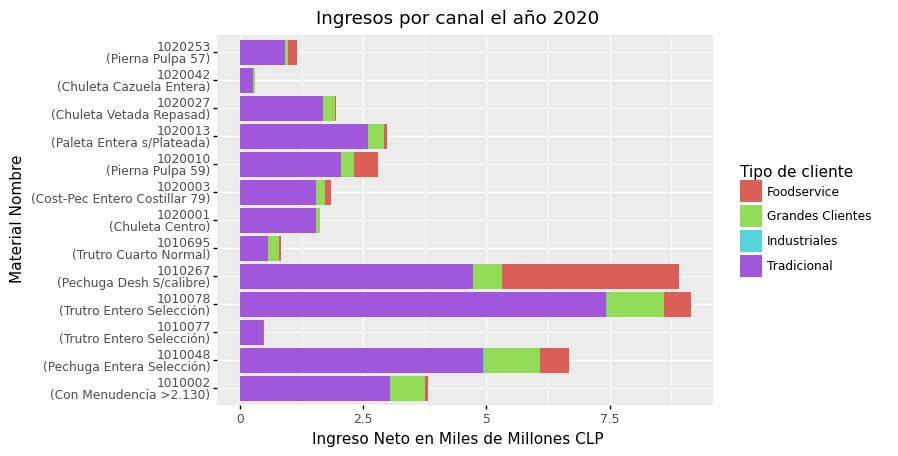

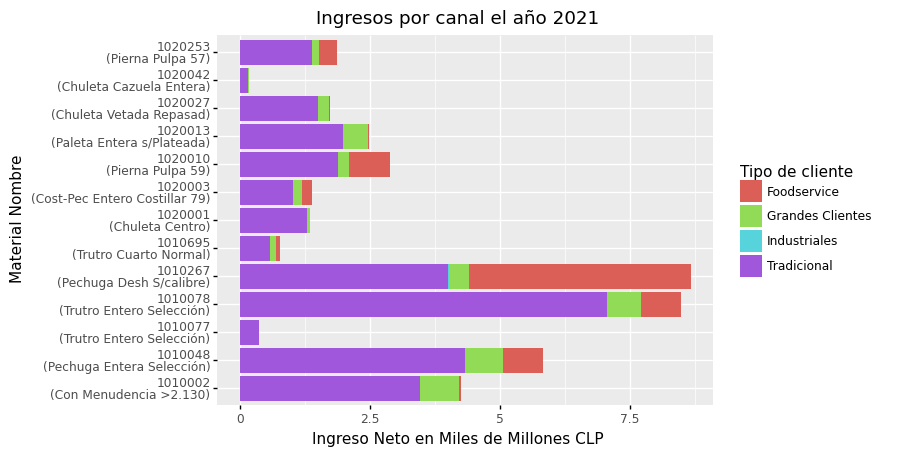

[<ggplot: (133441745095)>,
 <ggplot: (133471580760)>,
 <ggplot: (133471565484)>,
 <ggplot: (133471552250)>,
 <ggplot: (133471538695)>,
 <ggplot: (133471520395)>,
 <ggplot: (133471507975)>,
 <ggplot: (133471490699)>]

In [25]:
# Material
#=================================================
# Variaciond e los ingresos por material
#=================================================

Ingr_list_Material=[]
(df.Año.unique()).sort()
Y_col='Ingreso Neto en Miles de Millones CLP'

#=============================================
# Sucursal
#=============================================

for i in (df.Año.unique()):
    Ingr_list_Material.append(ggplot(df[df.Año==i],
                            aes(x='Material Nombre', y=Y_col, fill='Centro.1'))
     
        + geom_col(stat='identity',show_legend=True)
                   
        +ggtitle('Ingresos por canal el año ' + str(i))
         #+theme(axis_text_x = element_text(angle=90, hjust=1))#,figure_size=(10,8)
         +coord_flip()
                  )

#========================================
# Canal Tipo de cliente
#========================================

for i in (df.Año.unique()):
    Ingr_list_Material.append(ggplot(df[df.Año==i],
                            aes(x='Material Nombre', y=Y_col, fill='Tipo de cliente'))

        + geom_col(stat='identity',show_legend=True)

        +ggtitle('Ingresos por canal el año ' + str(i))
         #+theme(axis_text_x = element_text(angle=90, hjust=1))#,figure_size=(10,8)
         +coord_flip()
                  )
Ingr_list_Material

#### PDF 

In [90]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(Ingr_list_Canal
                  ,file_direct_Graphic+'/Generales/'+"/Col Ingresos Anuales Canal.pdf")

save_as_pdf_pages(Ingr_list_Material
                  ,file_direct_Graphic+'/Generales/'+"/Col Ingresos Anuales Material.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Col Ingresos Anuales Canal.pdf
C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Col Ingresos Anuales Material.pdf


Time Lapsed = 0:0:4.692523717880249 
 H:m:s


#### ingresos Vertical 

Modioficar para que el listado de materiales solo aparesca en los años 2019 y 2021

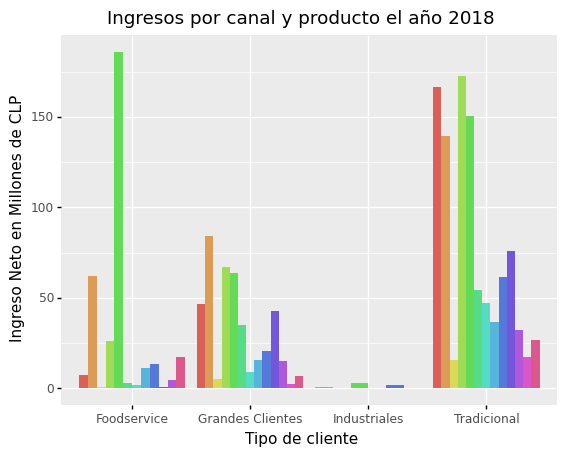

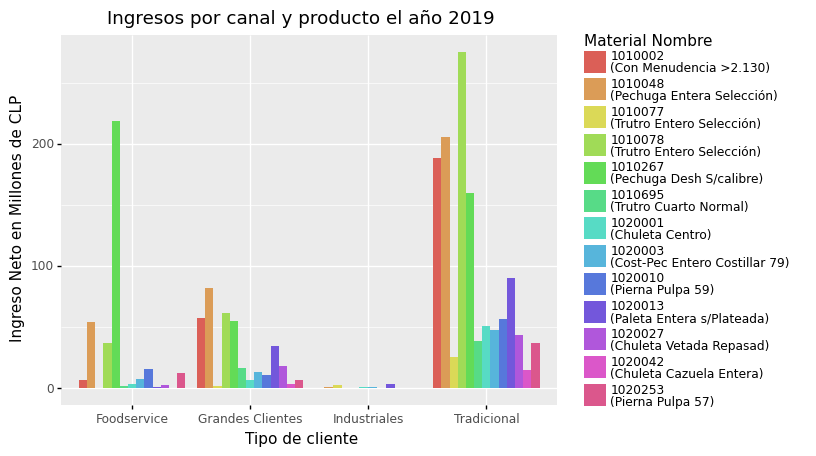

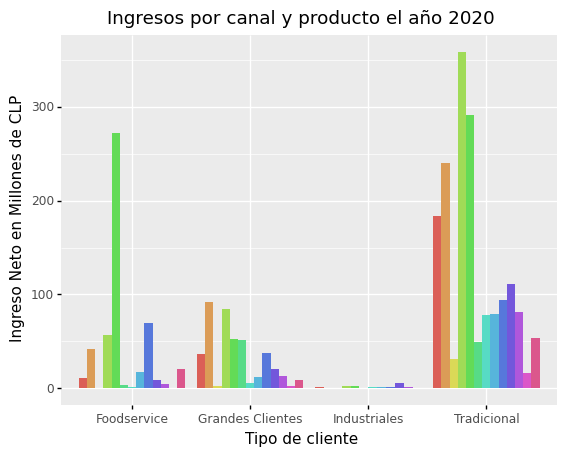

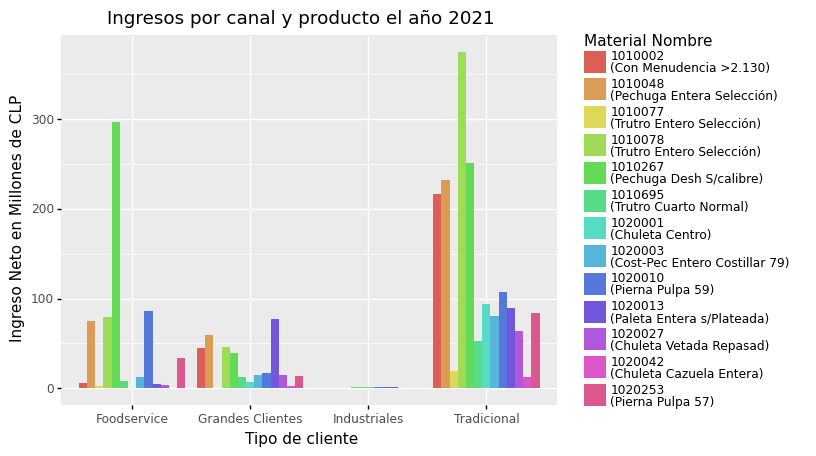

[<ggplot: (133443101019)>,
 <ggplot: (133443196889)>,
 <ggplot: (133466584580)>,
 <ggplot: (133442374461)>]

In [45]:
#         INGRESOS MATERIAL VERTICAL
#=================================================
# Variacion de los INGRESOS por material Canal
#=================================================
Ingresos_list_material_Vert=[]
(df.Año.unique()).sort()

Y_col='Ingreso Neto en Millones de CLP'
df['Ingreso Neto en Millones de CLP']=df['Venta Neta']/10**6

for i in (df.Año.unique()):
    if((i==2018)|(i==2020)):
        Ingresos_list_material_Vert.append(ggplot(df[df.Año==i],
                                aes(x='Tipo de cliente', y=Y_col, fill='Material Nombre'))

            + geom_col(stat='identity',show_legend=True,position='dodge')

            +ggtitle('Ingresos por canal y producto el año ' + str(i))
            
             + theme( legend_position='none')
                                )
                 
    else:
        Ingresos_list_material_Vert.append(ggplot(df[df.Año==i],
                                aes(x='Tipo de cliente', y=Y_col, fill='Material Nombre'))

            + geom_col(stat='identity',show_legend=True,position='dodge')

            +ggtitle('Ingresos por canal y producto el año ' + str(i))
                      )
Ingresos_list_material_Vert

##### PDF 

In [47]:
save_as_pdf_pages(Ingresos_list_material_Vert  
                  ,file_direct_Graphic+'/Generales/'+"/Anual/Col Ingresos Anuales Material y Canal.pdf")

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Anual/Col Ingresos Anuales Material y Canal.pdf


### Toneladas 

Modioficar para que el listado de materiales solo aparesca en los años 2019 y 2021

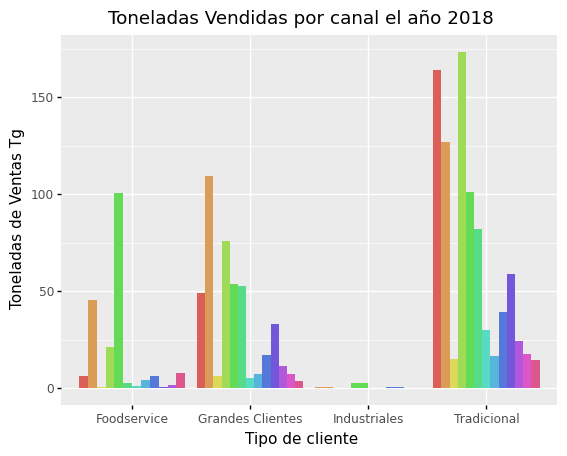

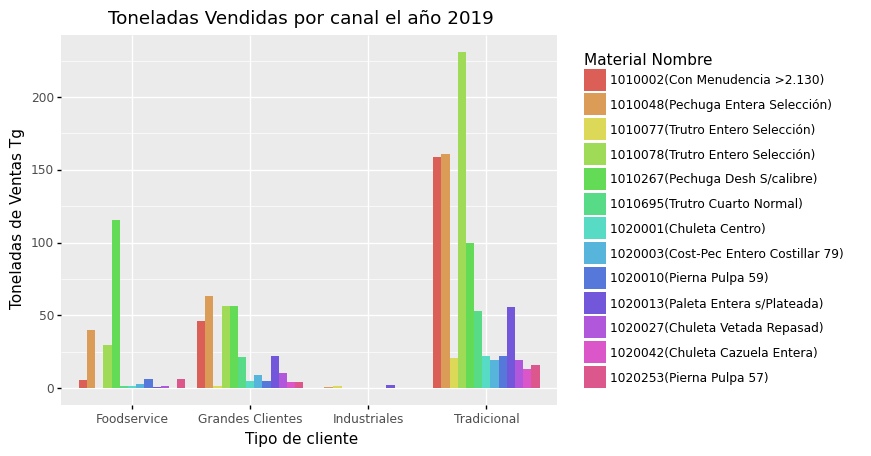

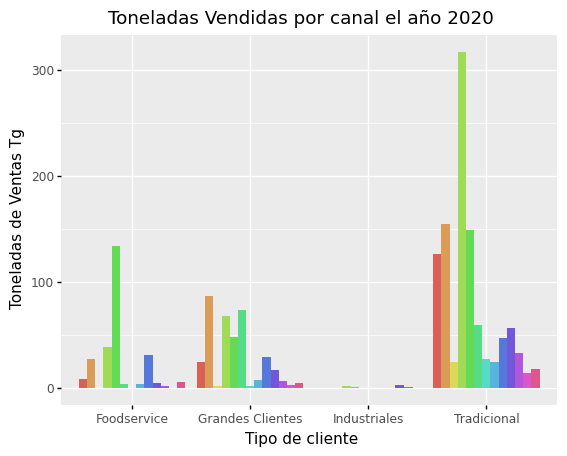

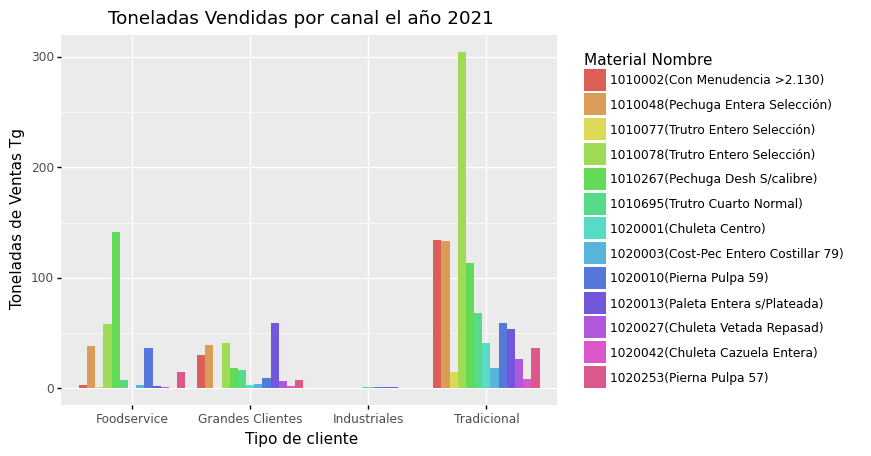

[<ggplot: (88595565779)>,
 <ggplot: (88643258540)>,
 <ggplot: (88595759767)>,
 <ggplot: (88606678032)>]

In [126]:
#         TONELADAS MATERIAL
#=================================================
# Variacion de los tonealdas por material Canal
#=================================================
Ton_list_material=[]
(df.Año.unique()).sort()
Y_col='Toneladas de Ventas Tg'
for i in (df.Año.unique()):
    if((i==2018)|(i==2020)):
        Ton_list_material.append(ggplot(df[df.Año==i],
                                aes(x='Tipo de cliente', y=Y_col, fill='Material Nombre'))

            + geom_col(stat='identity',show_legend=True,position='dodge')

            +ggtitle('Toneladas Vendidas por canal el año ' + str(i))
            
             + theme( legend_position='none')
                                )
                 
    else:
        Ton_list_material.append(ggplot(df[df.Año==i],
                                aes(x='Tipo de cliente', y=Y_col, fill='Material Nombre'))

            + geom_col(stat='identity',show_legend=True,position='dodge')

            +ggtitle('Toneladas Vendidas por canal el año ' + str(i))
                      )
Ton_list_material

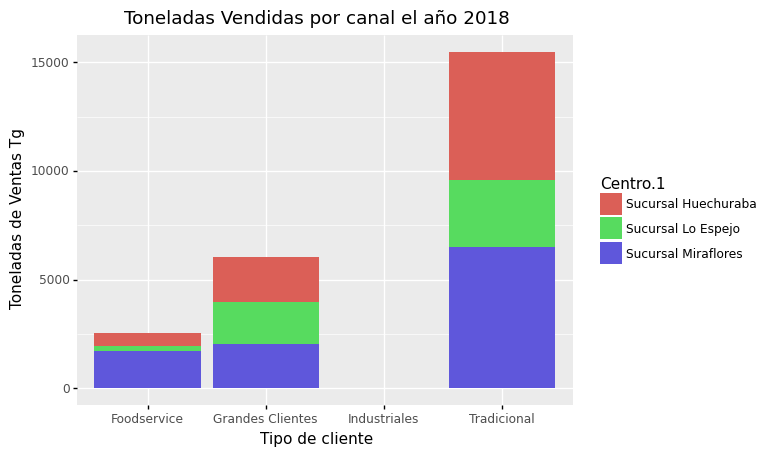

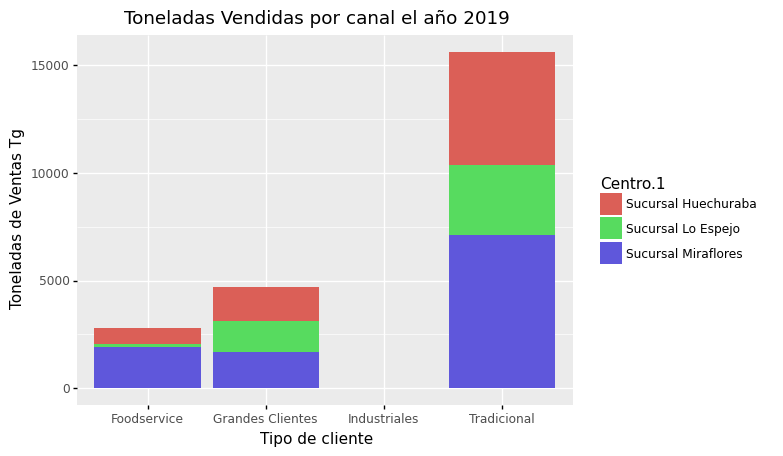

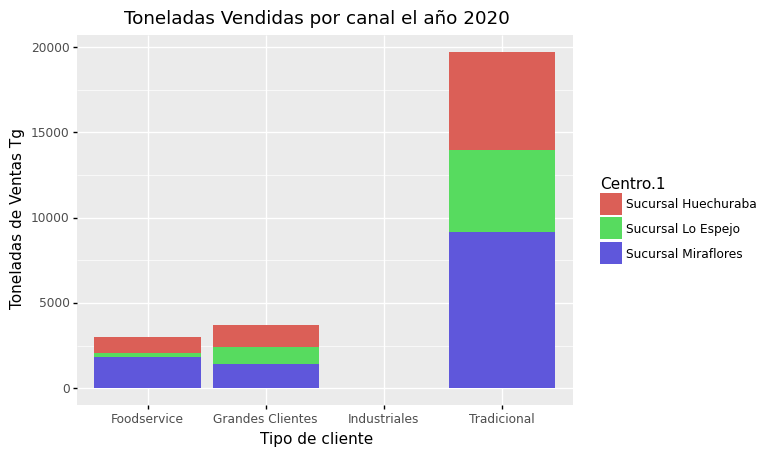

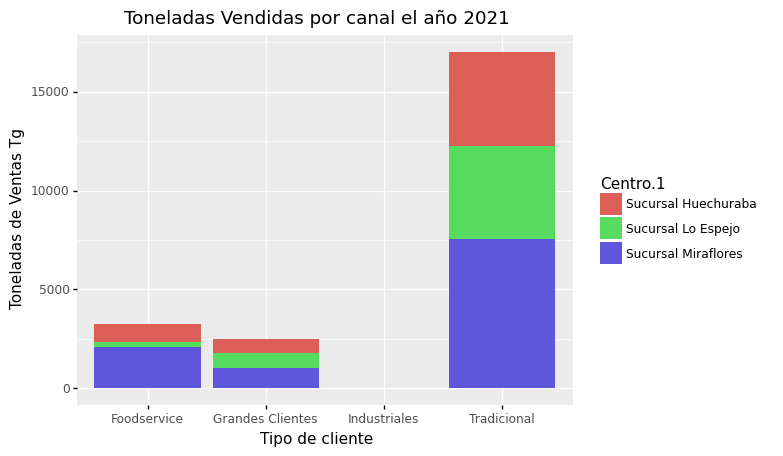

[<ggplot: (88632159335)>,
 <ggplot: (88600448916)>,
 <ggplot: (88595071073)>,
 <ggplot: (88606794129)>]

In [127]:
#         TONELADAS SUCURSAL
#=================================================
# Variacion de los tonealdas por  Canal
#=================================================
Ton_list_Sucursal=[]
(df.Año.unique()).sort()
Y_col='Toneladas de Ventas Tg'
for i in (df.Año.unique()):
    Ton_list_Sucursal.append(ggplot(df[df.Año==i],
                            aes(x='Tipo de cliente', y=Y_col, fill='Centro.1'))
     
        + geom_col(stat='identity',show_legend=True)
                   
        +ggtitle('Toneladas Vendidas por canal el año ' + str(i))
                  )
Ton_list_Sucursal

##### Toneladas material 

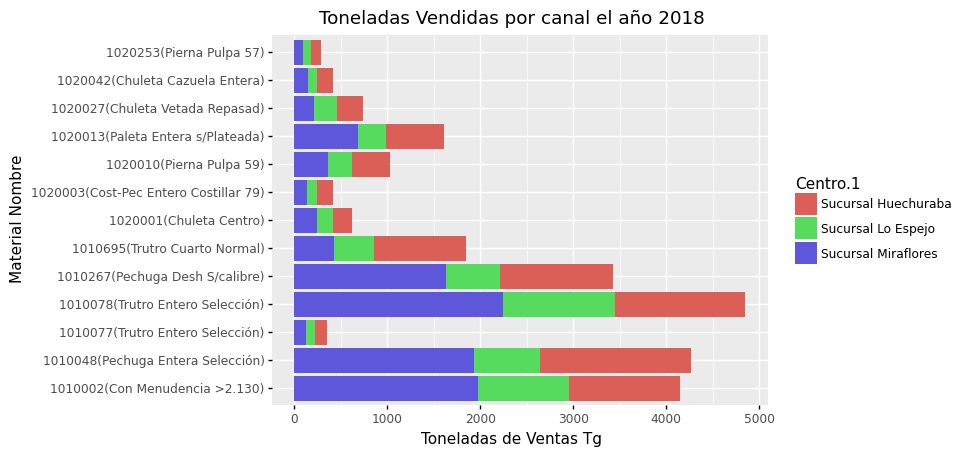

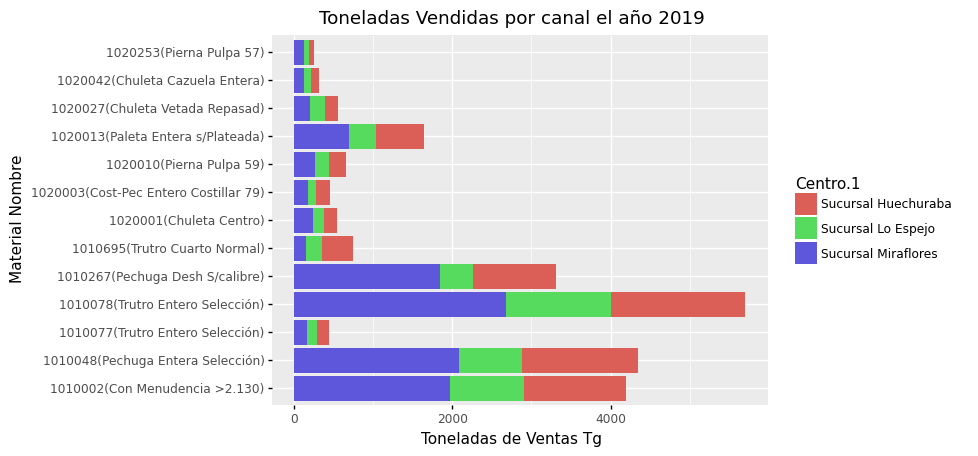

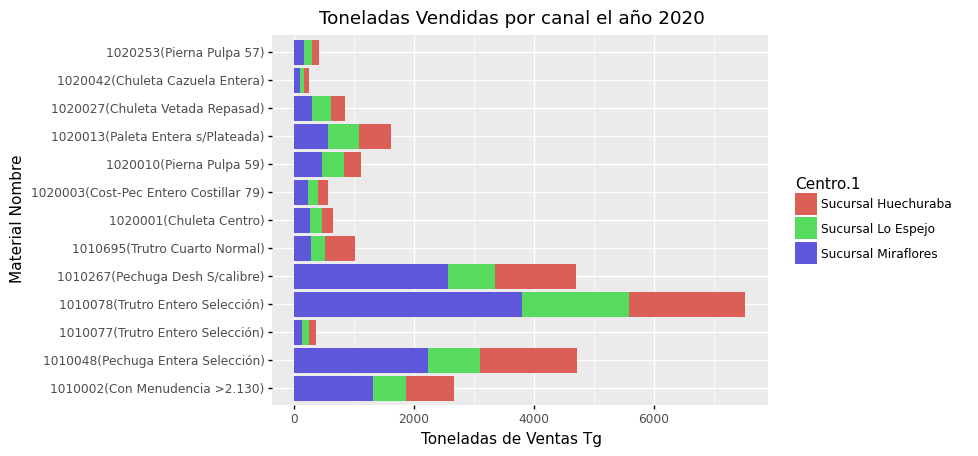

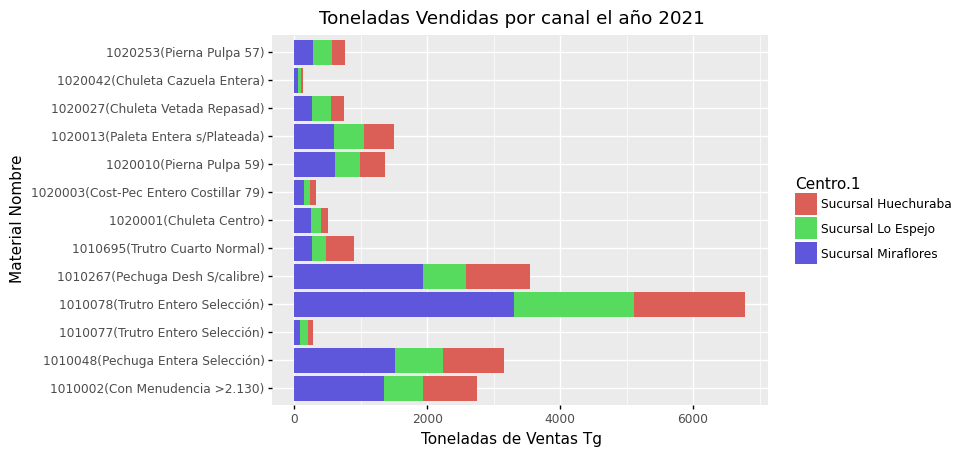

[<ggplot: (88594542855)>,
 <ggplot: (88642272576)>,
 <ggplot: (88668417046)>,
 <ggplot: (88669208435)>]

In [128]:
#         TONELADAS Material
#=================================================
# Variacion de los tonealdas por  Canal
#=================================================
Ton_list_material_2=[]
(df.Año.unique()).sort()
Y_col='Toneladas de Ventas Tg'
for i in (df.Año.unique()):
    Ton_list_material_2.append(ggplot(df[df.Año==i],
                            aes(x='Material Nombre', y=Y_col, fill='Centro.1'))
     
        + geom_col(stat='identity',show_legend=True)
                   
        +ggtitle('Toneladas Vendidas por canal el año ' + str(i))
             +coord_flip()
                              )
Ton_list_material_2

#### PDF 

In [132]:
#============================
# Se guardan variaciones lineales
#============================
start_time = time.time()
save_as_pdf_pages(Ton_list_material + Ton_list_material_2 
                  ,file_direct_Graphic+'/Generales/'+"/Anual/Col Toneladas Anuales Material.pdf")

save_as_pdf_pages(Ton_list_Sucursal
                  ,file_direct_Graphic+'/Generales/'+"/Anual/Col Toneladas Anuales Canal.pdf")
time_convert(time.time()-start_time)

C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Anual/Col Toneladas Anuales Material.pdf
C:\Users\user\anaconda3\lib\site-packages\plotnine\ggplot.py:820: PlotnineWarning: Filename: C:/Users/user/Documents/Graficos/Generales//Anual/Col Toneladas Anuales Canal.pdf


Time Lapsed = 0:0:4.126038312911987 
 H:m:s


### Mensual

In [ ]:
df.Mes=df.Mes.apply(Mes_name)

In [ ]:
df.columns

In [ ]:
df['Ingreso Neto en Millones CLP']=df['Venta Neta']/10**6

#### Ingresos 

In [ ]:
# Canal
#=================================================
# Variaciond e los ingresos por material
#=================================================
Ingr_list_Canal_mes=[]
#(df.Año.unique()).sort()
Y_col='Ingreso Neto en Millones CLP'
Año_i=2020
for i in (df['Tipo de cliente'].unique()):
    Ingr_list_Canal_mes.append(ggplot(
        df[(df['Tipo de cliente']==i) & (df.Año==Año_i)],
                            aes(x='Mes', y=Y_col, fill='Material Nombre'))
     
        + geom_col(stat='identity',show_legend=True)
                   
        +ggtitle('Ingresos Mensuales del Canal ' + str(i)+ ' el año '+ str(Año_i) )
           +theme(axis_text_x = element_text(),figure_size=(15,7) )#angle=90, hjust=1))
                          )
Ingr_list_Canal_mes

In [ ]:
# INGRESOS Canal Puntos
#=================================================
# Variaciond e los Toneladas por material
#=================================================
Ingr_list_Canal_mes_promedio=[]
#(df.Año.unique()).sort()
Y_col='Ingreso Neto en Millones CLP'
#Año_i=2020

#==================================
# DATA PROMEDIO MENSUAL
df_i=df.groupby(['Tipo de cliente', 'Material Nombre','Mes']).mean().reset_index()
df_i=df_i[df_i[Y_col].notnull()==True]

for i in (df['Tipo de cliente'].unique()):
    print(i)
    Ingr_list_Canal_mes_promedio.append(ggplot(
        df_i.loc[(df_i['Tipo de cliente']==i)]
        ,
                            aes(x='Mes', y=Y_col, color='Material Nombre'))
     
        + geom_point(size=5)
                   
        +ggtitle('Demanda en Ingresos Promedio Mensuales del Canal ' + str(i) )
           +theme(axis_text_x = element_text(),figure_size=(15,7) )#angle=90, hjust=1))
                          )
Ingr_list_Canal_mes_promedio

#### PDF 

In [ ]:
#============================
# Ingreso Mensual
#============================
start_time = time.time()
save_as_pdf_pages(Ingr_list_Canal_mes +Ingr_list_Canal_mes_promedio
                  ,file_direct_Graphic+'/Generales/Mensual'+"/Ingresos Mensual Canal.pdf")

time_convert(time.time()-start_time)

#### Toneladas 

In [ ]:
# TONELADAS Canal
#=================================================
# Variaciond e los Toneladas por material
#=================================================
Ton_list_Canal_mes=[]
#(df.Año.unique()).sort()
Y_col='Toneladas de Ventas Tg'
Año_i=2020
for i in (df['Tipo de cliente'].unique()):
    Ton_list_Canal_mes.append(ggplot(
        df[(df['Tipo de cliente']==i) & (df.Año==Año_i)],
                            aes(x='Mes', y=Y_col, fill='Material Nombre'))
     
        + geom_col(stat='identity',show_legend=True)
                   
        +ggtitle('Toneladas Mensuales del Canal ' + str(i)+ ' el año '+ str(Año_i) )
           +theme(axis_text_x = element_text(),figure_size=(15,7) )#angle=90, hjust=1))
                          )
Ton_list_Canal_mes

In [ ]:
# TONELADAS Canal Puntos
#=================================================
# Variaciond e los Toneladas por material
#=================================================
Ton_list_Canal_mes_promedio=[]
#(df.Año.unique()).sort()
Y_col='Toneladas de Ventas Tg'
#Año_i=2020

#==================================
# DATA PROMEDIO MENSUAL
df_i=df.groupby(['Tipo de cliente', 'Material Nombre','Mes']).mean().reset_index()
df_i=df_i[df_i['Toneladas de Ventas Tg'].notnull()==True]

for i in (df['Tipo de cliente'].unique()):
    print(i)
    Ton_list_Canal_mes_promedio.append(ggplot(
        df_i.loc[(df_i['Tipo de cliente']==i)]
        ,
                            aes(x='Mes', y=Y_col, color='Material Nombre'))
     
        + geom_point(size=5)
                   
        +ggtitle('Demanda en Toneladas Promedio Mensuales del Canal ' + str(i) )
           +theme(axis_text_x = element_text(),figure_size=(15,7) )#angle=90, hjust=1))
                          )
Ton_list_Canal_mes_promedio

#### PDF 

In [ ]:
#============================
# Ingreso Mensual
#============================
start_time = time.time()
save_as_pdf_pages(Ton_list_Canal_mes +Ton_list_Canal_mes_promedio
                  ,file_direct_Graphic+'/Generales/Mensual'+"/Demanda Mensual Canal.pdf")

time_convert(time.time()-start_time)

# Precio volumen 

Como son graficos de dispersion, puede que no sea conveniente evualuar a cada uno de los canales, por lo cual se procede a atacar al canal tradicional.